In [1]:
import os
from pathlib import Path

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import torch 
import torch.nn.functional as F
from dotenv import load_dotenv
from scipy.stats import wasserstein_distance
import scienceplots
from matplotlib.ticker import MaxNLocator
from astropy.table import Table


from data.load_data import load_data
from data.load_tokens import DATA_FILES, combinations
from datasets import load_dataset

from IPython.display import display

plt.style.use("science")

data = {}
divs = {}
tok_z = {}
tok_z_p = {}

load_dotenv()

DATA_ROOT = os.getenv("DATA_ROOT")
DATA_FOLDER = os.getenv("DATA_FOLDER")
base = Path(DATA_ROOT) / DATA_FOLDER

/home/phys2526/AION1_experiments/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


1025
3815


In [2]:
for name in combinations.keys():
    data[name] = load_dataset("parquet", data_files=DATA_FILES, split=name)

#combinations.pop("true_z")

true_z = torch.tensor(data["true_z"]["tok_z"])
target_ids = data[name]["TARGETID"]

true_z_p = F.softmax(true_z, dim=-1)
#target_id = (data["true_z"]["target_id"]
for name in combinations.keys():
    tok_z[name] = torch.tensor(data[name]["tok_z"])
    tok_z_p[name] = F.softmax(tok_z[name], dim=-1)
    assert target_ids == data[name]["TARGETID"] # double check everything lines up.

table = load_data()
# map each TARGETID to its position in target_ids
order_map = {tid: i for i, tid in enumerate(target_ids)}
default_rank = len(target_ids)  # for IDs not in the list (they go last)

# build an array of sort keys for each row
sort_key = np.array([order_map.get(tid, default_rank) for tid in table['TARGETID']])

# apply the sort
table_sorted = table[np.argsort(sort_key)] 

In [17]:
def plot_z_dist(
    check_df,
    table_sorted,
    names,
    tok_z_p,
    ascending=True,
    col="ratio_p_ip"
):
    cols_to_show = ["TARGETID","sSFR", "LOG_MSTAR", "legacysurvey_EBV", "desi_Z"]
    for idx, row in check_df.sort_values(col, ascending=ascending).iterrows():
        img     = table_sorted[idx]["legacysurvey_image_rgb"]
        flux    = table_sorted[idx]["desi_spectrum_flux"]
        lambda_ = table_sorted[idx]["desi_spectrum_lambda"]
        mask    = table_sorted[idx]["desi_spectrum_mask"]

        # --- object properties table ---
        row_tab = table_sorted[idx:idx+1][cols_to_show]   # 1-row Astropy Table slice
        display(row_tab)
        display(row)

        # --- Z predictions table ---
        z_rows = []
        for name in names[0:-1]:
            z = tok_z_p[name][idx, :].detach().cpu().numpy()
            z_pred = z.argmax() * (6.0 / 1025.0)
            z_rows.append((name, z_pred))

        z_tab = Table(rows=z_rows, names=["modality", "Z_prediction"])
        z_tab["Z_prediction"].format = ".3f"   # nice formatting

        # true DESI redshift
        desi_z = float(table_sorted[idx]["desi_Z"])

        # difference: prediction - true
        z_tab["Diff. from true Z"] = z_tab["Z_prediction"] - desi_z
        z_tab["Diff. from true Z"].format = ".3f"

        # --- plots ---
        fig, axes = plt.subplots(
            1, 2, figsize=(14, 6),
            gridspec_kw={"width_ratios": [1, 3]}
        )

        axes[0].imshow(img)
        axes[0].set_title(f"TARGETID {table_sorted[idx]['TARGETID']}")
        axes[0].axis("off")

        axes[1].plot(lambda_[~mask], flux[~mask], c="black")
        axes[1].set_title("DESI spectrum flux")
        axes[1].set_xlabel(r"$\lambda / \AA$")
        axes[1].set_ylabel("Flux")
        axes[1].tick_params(axis='both', which='major', labelsize=16)

        plt.tight_layout()
        plt.show()

        _, ax = plt.subplots(figsize=(6, 4), dpi=300)

        for name in names[0:-1]:
            z = tok_z_p[name][idx, :].detach().cpu().numpy()
            z_grid = np.linspace(0, 6, len(z))
            ax.plot(z_grid, z, label=name)

        # true z line
        ax.axvline(table_sorted[idx]["Z_HP"], ls="--", c="black", label="True $z$")

        #ax.set_xlim(max(0, table_sorted[idx]["Z_HP"] - 0.25), table_sorted[idx]["Z_HP"] + 0.25)
        ax.set_xlabel("z", fontsize=14)
        ax.set_ylabel(r"$p(z)$", fontsize=14)

        ax.legend(fontsize=10)
        plt.tight_layout()
        plt.show()
        print("------------------------------------------------")

## Reshift distribution examples using different modalities

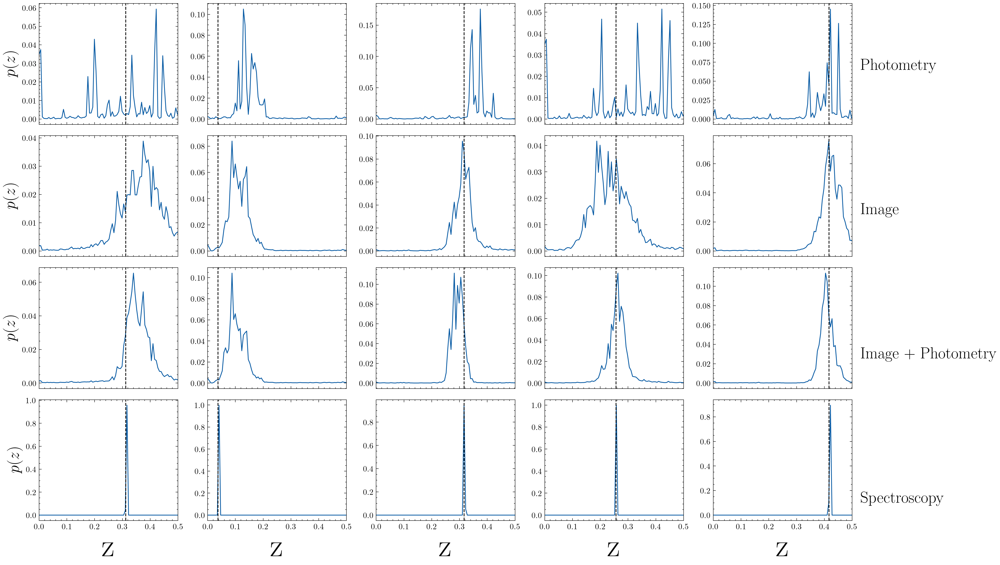

In [15]:
names = ["photometry", "imaging", "image_photometry", "spectroscopy"]
n_rows = len(names)
n_cols = 5  # number of different idx you want

fig, axes = plt.subplots(
    n_rows, n_cols,
    figsize=(3 * n_cols, 2.5 * n_rows),
    sharex=True,
    dpi=300
)

for col in range(n_cols):
    # pick a different idx for each column
    idx = int(torch.randint(low=0, high=len(tok_z_p["photometry"]), size=(1,)).item())

    for row, name in enumerate(names):
        ax = axes[row, col]

        # use idx (the chosen object), not col
        z = tok_z_p[name][idx, :].detach().cpu().numpy()

        ax.plot(np.linspace(0, 6, len(z)), z)

        # again, use idx here
        ax.axvline(table_sorted[idx]["Z_HP"], ls="--", c="black")

        ax.set_xlim(0, 0.5)

        if col == 0:
            ax.set_ylabel(r"$p(z)$", fontsize=20)

        if row == n_rows - 1:
            ax.set_xlabel("z", fontsize=40)

# --- Add simple text labels at the end (right side of figure) ---
# Make some room on the right for text
plt.subplots_adjust(right=0.88)

labels = ["Photometry", "Image", "Image + Photometry", "Spectroscopy"]
for row, name in enumerate(labels):
    # y-position for the center of this row in figure coordinates
    y = (n_rows - row - 0.5) / n_rows
    fig.text(
        1., y, name,
        va="center", ha="left", fontsize=20
    )

plt.tight_layout()
plt.show()

## Wasserstein Metric


Compute the Wasserstein-1 distance between modalities and the `true'-redshift distribution

In [5]:
# Function
def w1_distance_batched(u, v):
    '''
    Assume u, v are the softmax distributions of the logit outputs.
    '''
    u_cdf = torch.cumsum(u, dim=-1)
    v_cdf = torch.cumsum(v, dim=-1)

    return torch.sum(
        torch.abs(u_cdf-v_cdf), dim=-1
    )

In [37]:
# Compute
w1s = {}

for idx, name in enumerate(list(tok_z_p.keys())):
    u = torch.zeros_like(tok_z_p[name].detach().cpu())
    
    '''if idx == 0:
        B = u.size(0)
        batch_idx = torch.arange(B)
        quant_z =tok_z_p["spectroscopy"] #torch.round((torch.tensor(table["Z_HP"].tolist())/ 6.0)*1025.).to(torch.long) # 1024 or 1025?
    '''
    #u[batch_idx, quant_z] = torch.tensor(1.0)


    w1s[name] = w1_distance_batched(
        u=tok_z_p["spectroscopy"], v=tok_z_p[name]
    )
labels = ['Z', 'Photometry', 'Imaging', 'Spectroscopy', 'Image + Photometry', 'Image + Spectrum', 'Image + Spectrum + Photometry', 'Image + Spectrum + Photometry + Z']
df = pd.DataFrame(
    data=w1s,
)
df.columns = labels
#df.to_csv("./wasserstein_metrics.csv")

Let's define a ratio $R$ such that 

\begin{equation}
R = \frac{W_1}{W_2}
\end{equation}

where $W_1$ and $W_2$ are the Wasserstein distances between distributions. 

In our case, the Wasserstein distance will measure the distance between a predicted redshift distribution against the true (quantised) redshift distribution. The predicted distribution can use various inputs including: photometry, imaging and spectra. 

Below, let's plot the distribution of R for the cases: 

- The ratio of the Wasserstein distance imaging prediction of $z$ to truth compared to photometry and imaging to truth.
- The ratio of the Wasserstein distance photometry prediction of $z$ to truth compared to Wasserstein distance photometry and imaging prediction of $z$ to truth.

This produces three potential outcomes for each object:
 
- For $R \approx 0$, the Wasserstein distances are approximately equal and so adding the additional modality does not change the Wasserstein distance to redshift. 

- For $R > 1$, then the additional modality used helps to reduce the Wasserstein distance to the true distribution and so provides a better contraint on redshift. This means that the input is informative of the underlying redshift. 

- For $R < 1$, then the additional modality increases the Wasserstein distance to the true distribution and so worsens the prediction of redshift in comparison to the baseline prediction using a single modality.

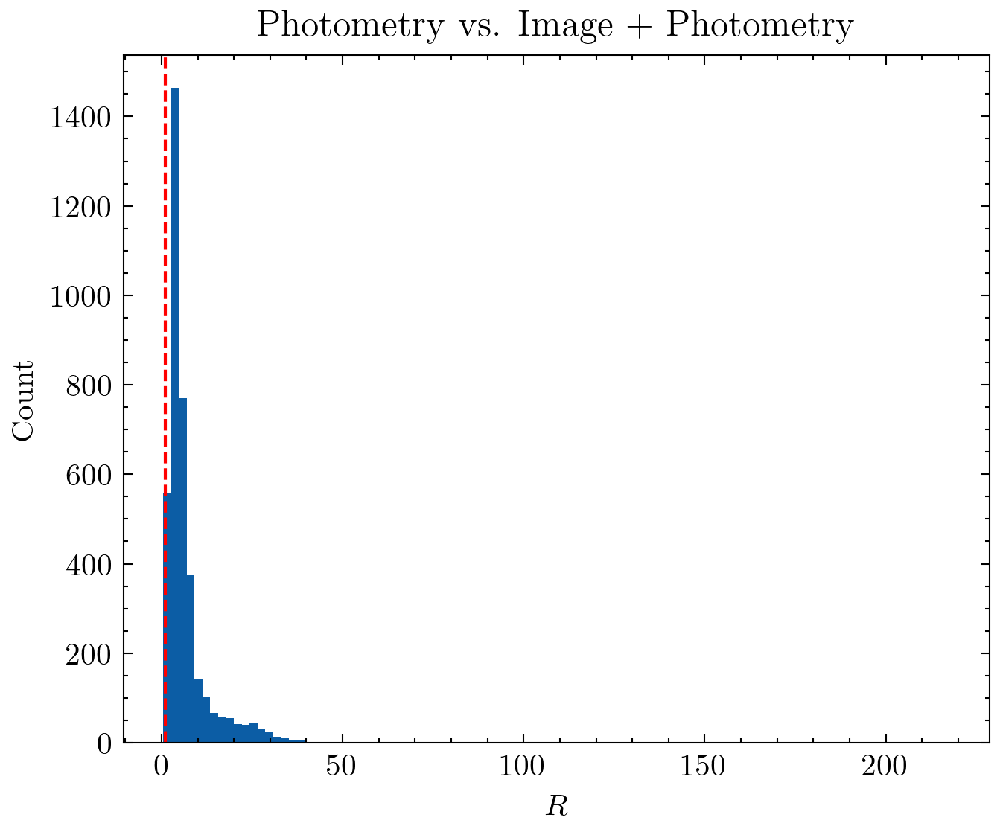

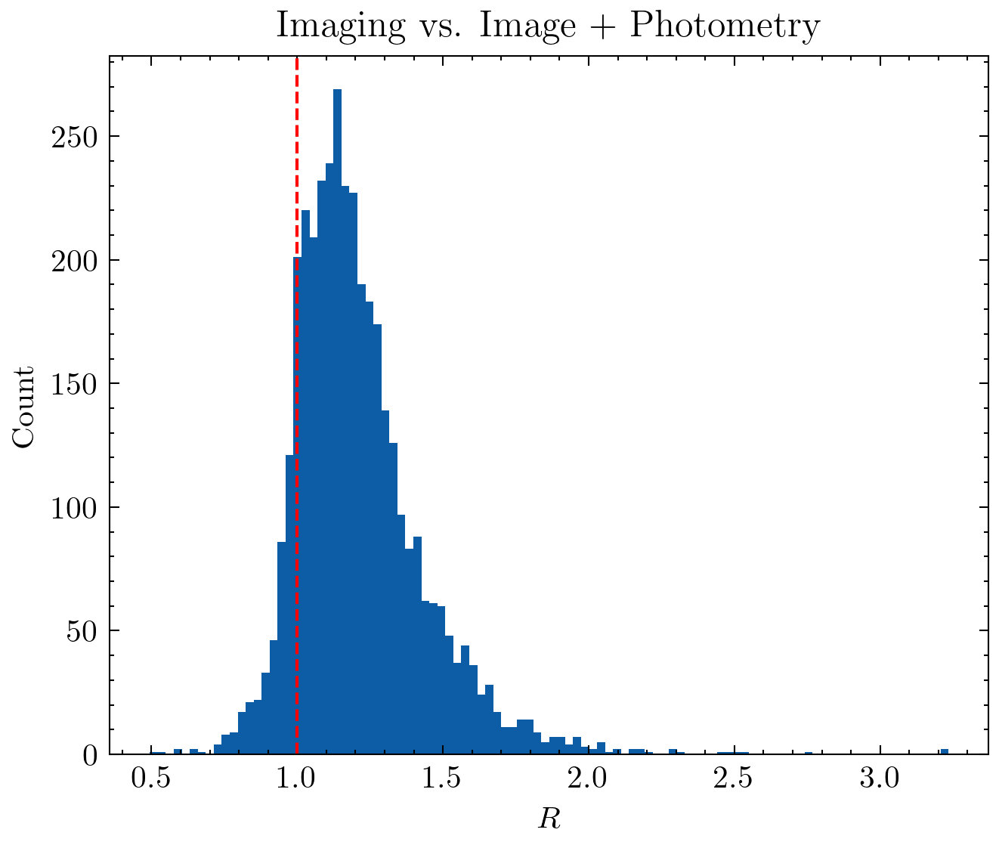

In [38]:
eps = 1e-6
labels = ['Photometry', 'Imaging']
cols = labels
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

for col, color in zip(cols, colors):
    
    # 2D histogram of original vs shifted
    fig, ax = plt.subplots(figsize=(5, 4), dpi=300)

    plt.hist(
        df[col]/df["Image + Photometry"], 
        bins=100
    )
    plt.xlabel(r"$R$")
    plt.ylabel("Count")
    plt.axvline(1.0, ls="--", c="red", label="")
    plt.title(f"{col} vs. Image + Photometry")

What we see above is that in Figure 1 almost always inclusion of imaging helps to improve reshift prediction over just the photometry. However, there are a small number of cases where this is not true and so the image does not help improve constraints on $z$ over a photometry only estimate.

In Figure 2, the story is more complex. Most predictions of redshift are improved by the inclusion of photometry in the estimate of redshift but a significant proportion of objects lie leftwards indicating photometry actually worsens the prediction of redshift over an image only baseline estimate.

In [39]:
df["ratio_p_ip"] =  (df["Photometry"])/(df["Image + Photometry"])

Let's examine the least improvements in redshift constraints by adding an image to the photometry prediction

In [40]:
threshold = 1.2 # threshold at -10

#print(df.loc[(df["ratio_p_ip"] < threshold) == True])

# 2) Filter rows
mask = df["ratio_p_ip"] <= threshold
check_df = df.loc[mask].copy()

# 3a) Option A: add a rank column (1 = highest diff)
check_df["ratio_p_ip_rank"] = check_df["ratio_p_ip"].rank(ascending=True, method="dense")

# 3b) Option B: sort by the difference
check_df = check_df.sort_values("ratio_p_ip", ascending=True)

TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799866114423,-7.558687,11.213979721069336,0.027271666,0.501469


Z                                    33.376568
Photometry                           10.027557
Imaging                              24.499979
Spectroscopy                          0.000000
Image + Photometry                   23.094481
Image + Spectrum                     16.220484
Image + Spectrum + Photometry        11.776525
Image + Spectrum + Photometry + Z    38.730301
ratio_p_ip                            0.434197
ratio_p_ip_rank                       1.000000
Name: 1394, dtype: float64

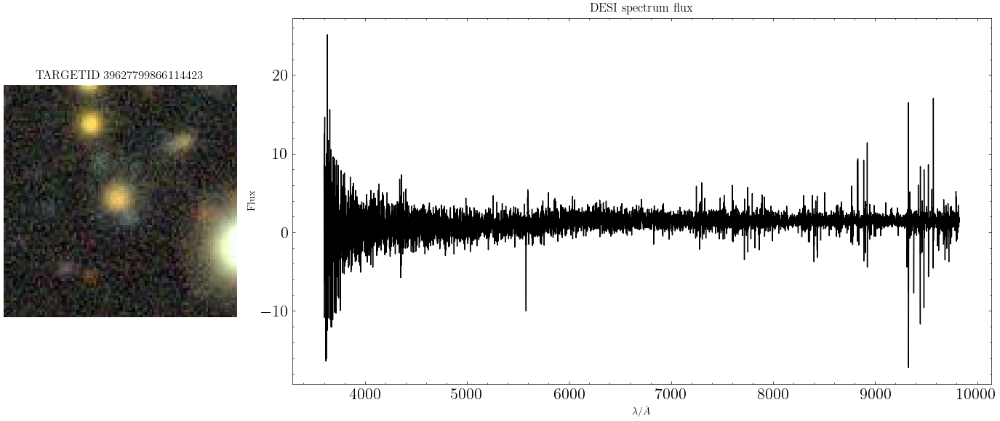

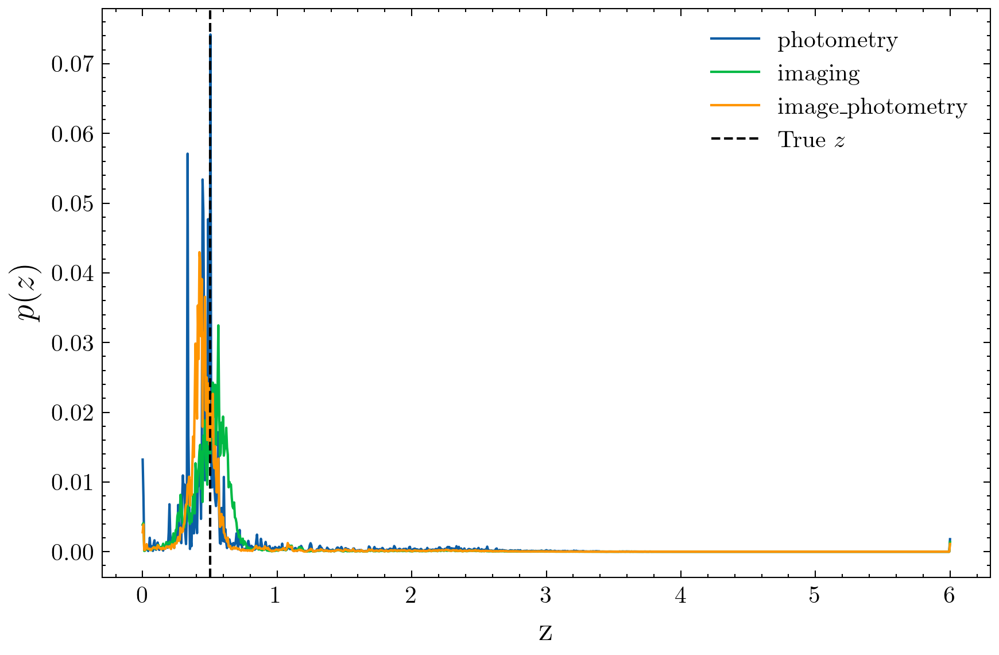

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627751564511225,-7.637816,11.032074928283691,0.02378779,0.5642005


Z                                    36.181084
Photometry                           43.711197
Imaging                              40.310604
Spectroscopy                          0.000000
Image + Photometry                   61.948307
Image + Spectrum                     46.125168
Image + Spectrum + Photometry        46.997719
Image + Spectrum + Photometry + Z    60.556587
ratio_p_ip                            0.705608
ratio_p_ip_rank                       2.000000
Name: 254, dtype: float64

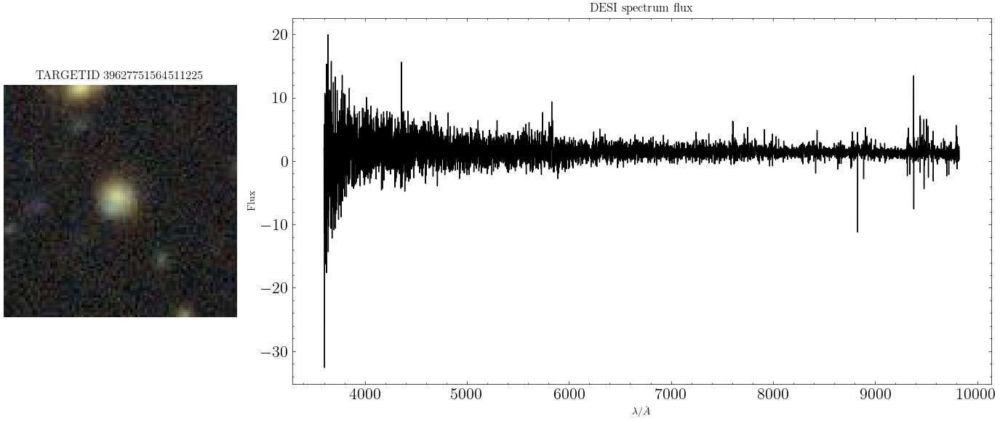

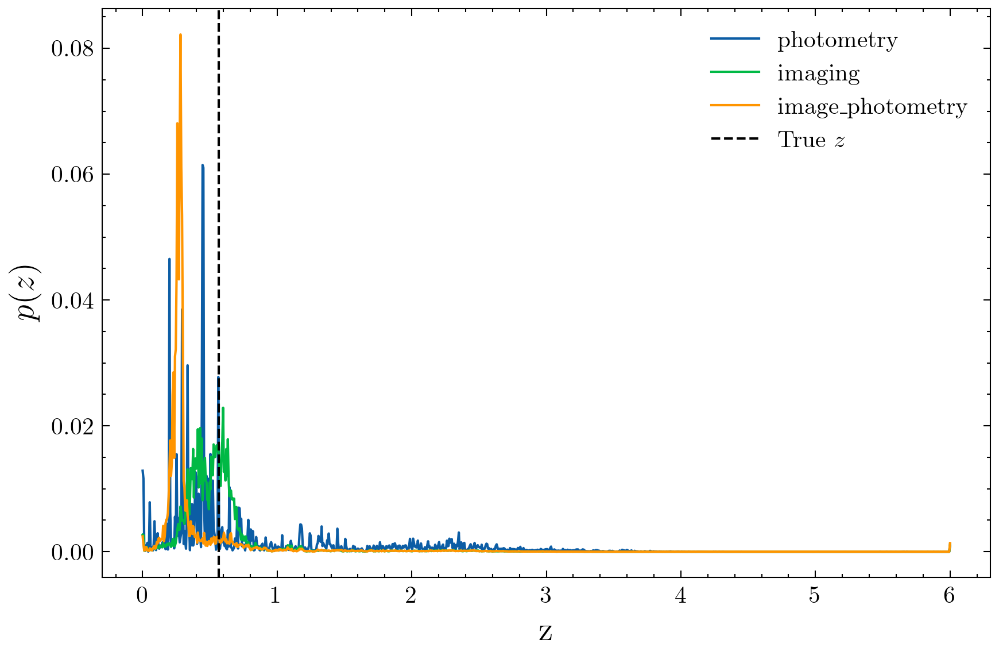

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627775694343622,-5.829042,11.145731925964355,0.01859737,0.53637683


Z                                    52.106285
Photometry                           31.992619
Imaging                              29.576077
Spectroscopy                          0.000000
Image + Photometry                   35.048923
Image + Spectrum                     54.085239
Image + Spectrum + Photometry        58.526592
Image + Spectrum + Photometry + Z    61.044144
ratio_p_ip                            0.912799
ratio_p_ip_rank                       3.000000
Name: 3442, dtype: float64

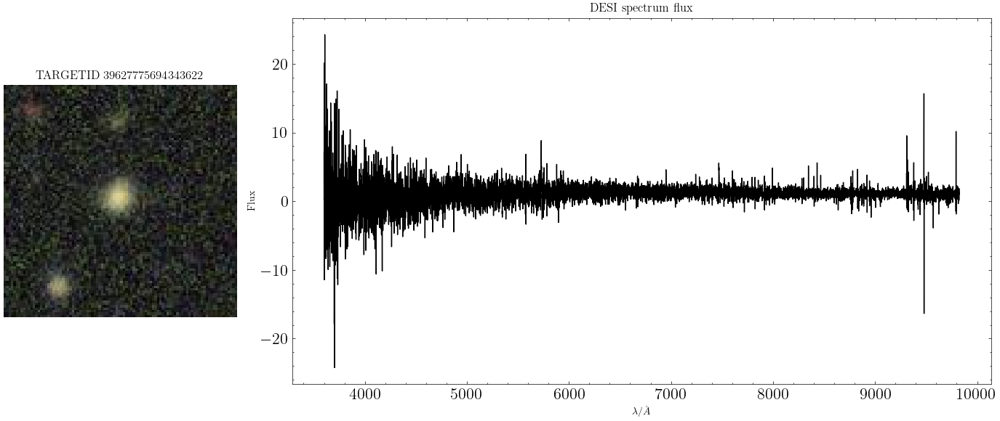

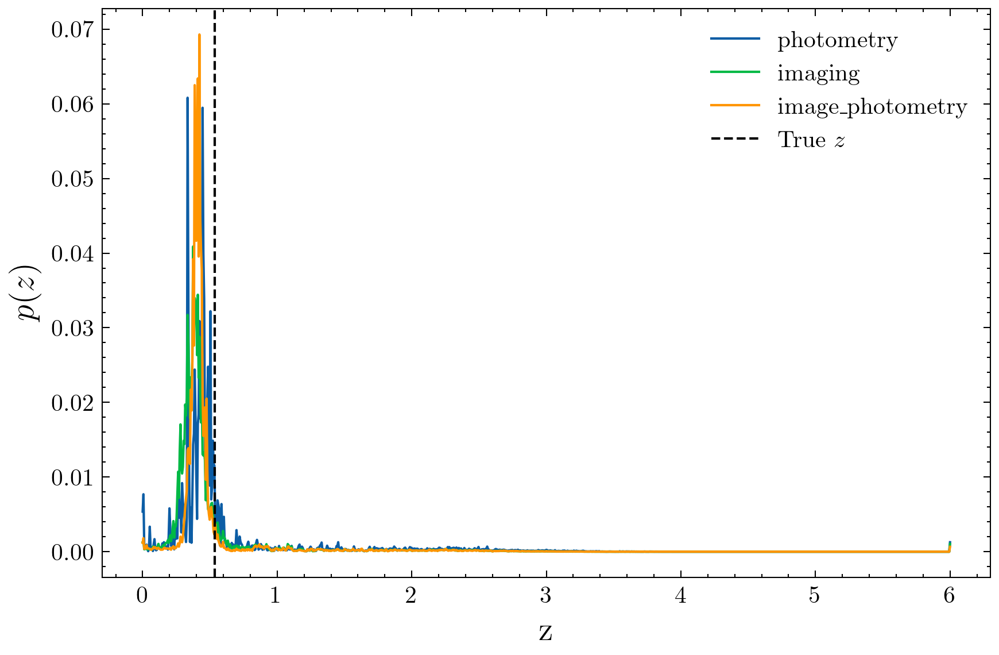

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627751551929976,-15.370854,11.389878273010254,0.020493466,0.50874835


Z                                    607.819580
Photometry                           550.557617
Imaging                              600.528687
Spectroscopy                           0.000000
Image + Photometry                   600.743286
Image + Spectrum                     551.814819
Image + Spectrum + Photometry        560.959473
Image + Spectrum + Photometry + Z    573.903320
ratio_p_ip                             0.916461
ratio_p_ip_rank                        4.000000
Name: 82, dtype: float64

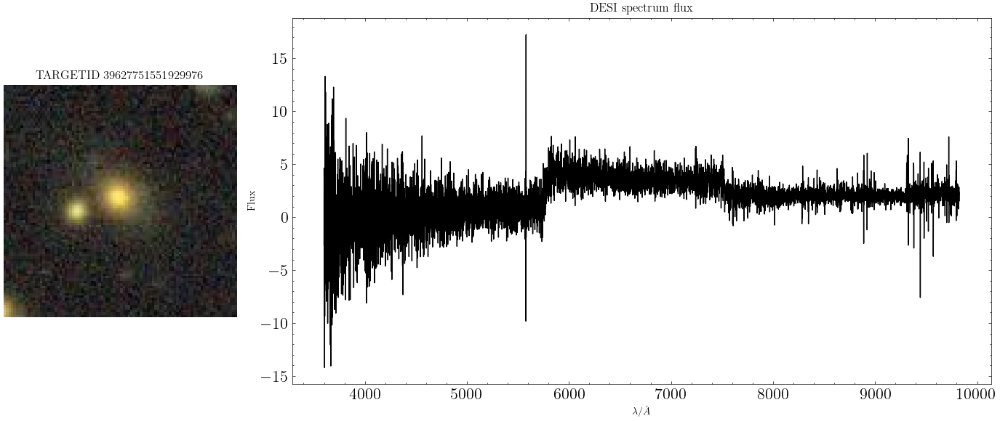

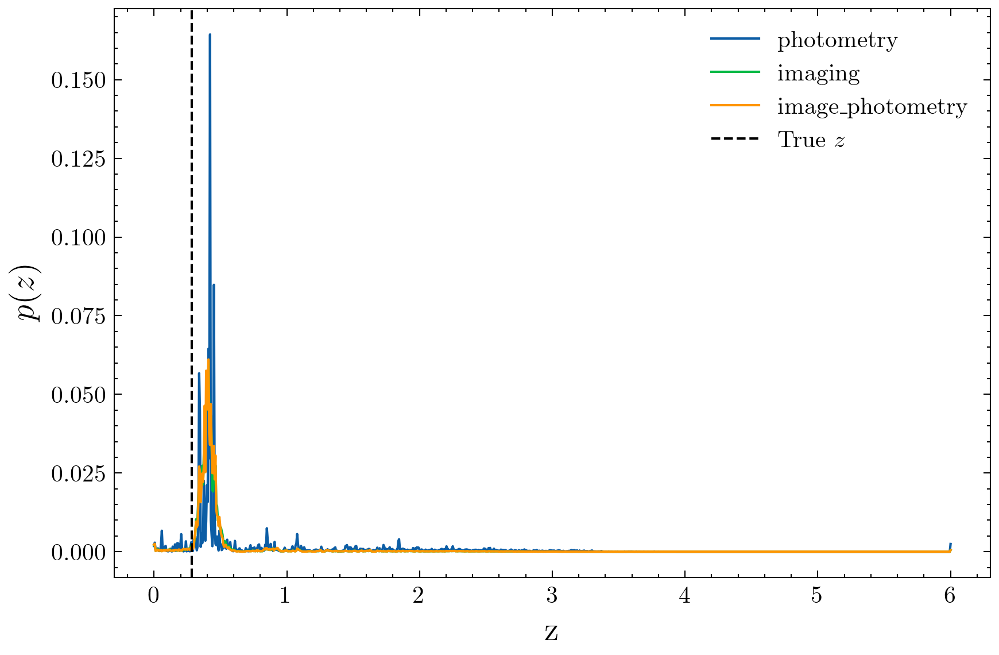

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627818002287849,-20.206602,12.02027702331543,0.033067755,0.48387292


Z                                     5.433448
Photometry                           45.868015
Imaging                              53.020500
Spectroscopy                          0.000000
Image + Photometry                   46.677753
Image + Spectrum                      0.008115
Image + Spectrum + Photometry         0.004697
Image + Spectrum + Photometry + Z     0.016730
ratio_p_ip                            0.982653
ratio_p_ip_rank                       5.000000
Name: 2558, dtype: float64

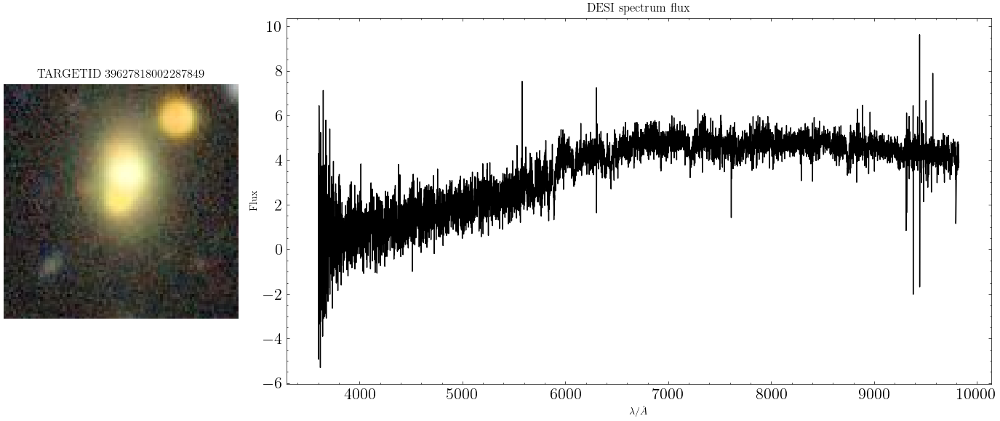

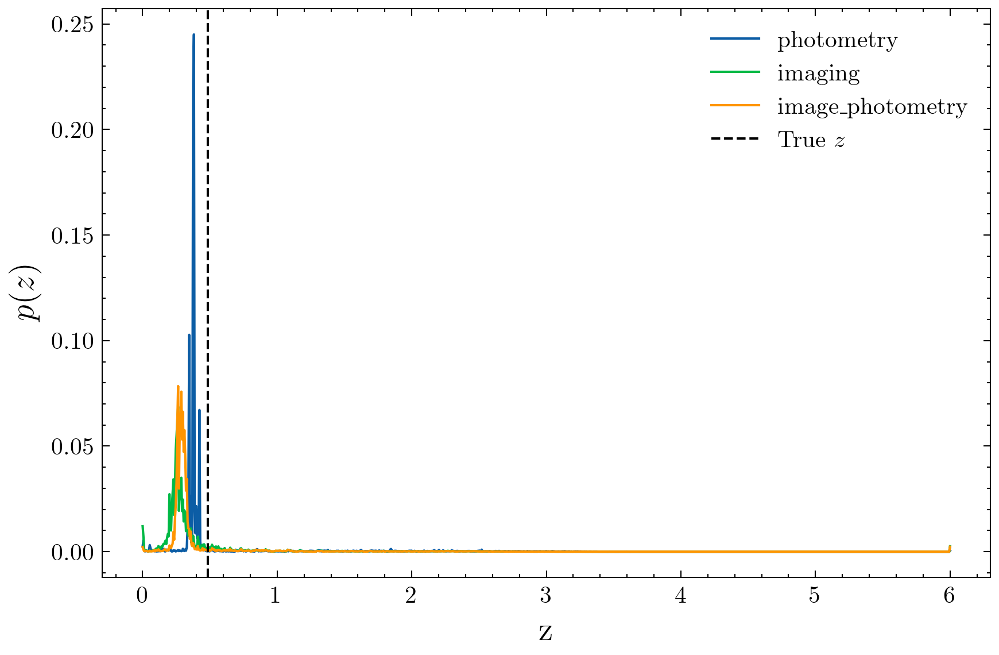

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799861923648,-10.243376,10.785386085510254,0.02481197,0.2643941


Z                                     8.707427
Photometry                           66.581055
Imaging                              49.482449
Spectroscopy                          0.000000
Image + Photometry                   58.111130
Image + Spectrum                      0.201806
Image + Spectrum + Photometry         0.024924
Image + Spectrum + Photometry + Z     0.122620
ratio_p_ip                            1.145754
ratio_p_ip_rank                       6.000000
Name: 1360, dtype: float64

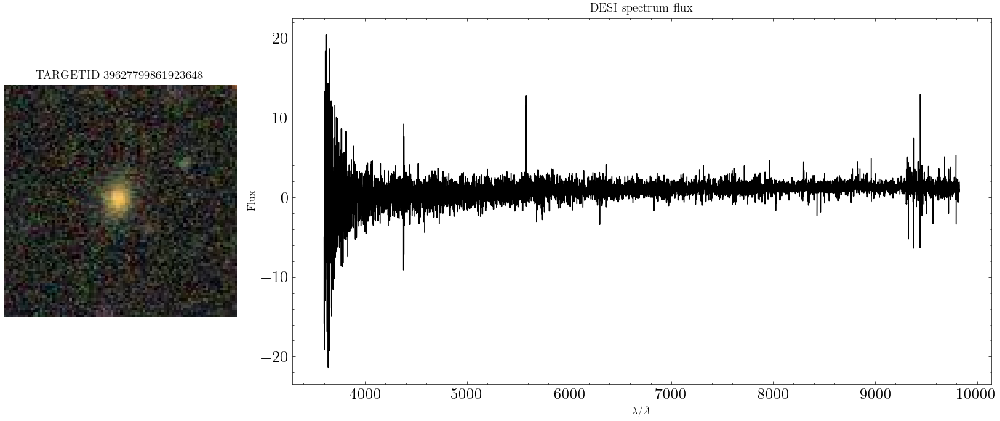

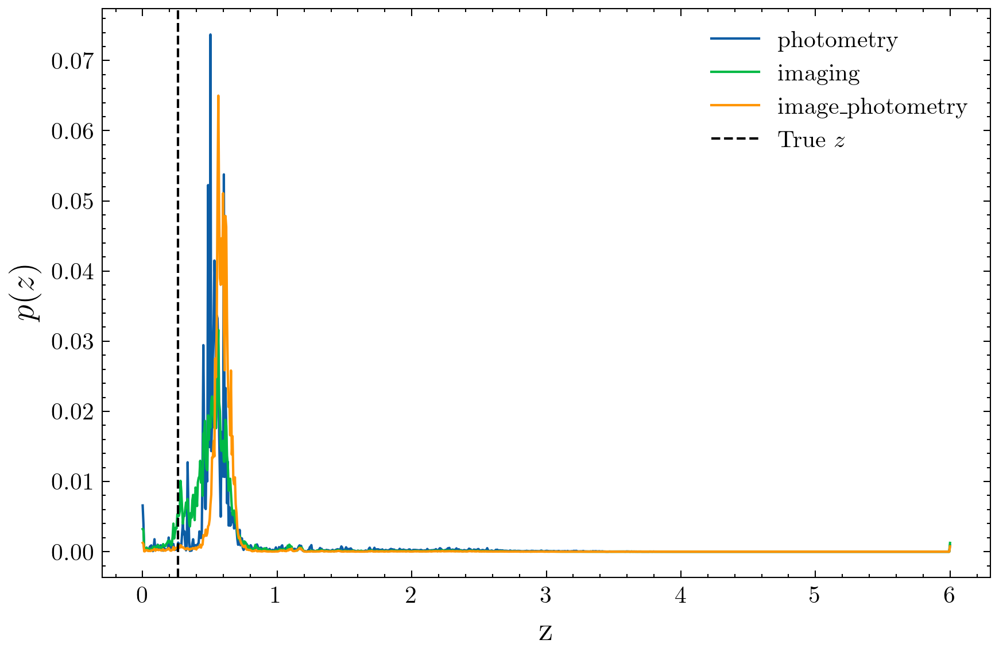

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627787799104091,-7.844743,11.159693717956543,0.02262175,0.43560892


Z                                    64.926186
Photometry                           69.944008
Imaging                              68.104500
Spectroscopy                          0.000000
Image + Photometry                   60.973331
Image + Spectrum                     56.359947
Image + Spectrum + Photometry        59.041134
Image + Spectrum + Photometry + Z    82.386658
ratio_p_ip                            1.147125
ratio_p_ip_rank                       7.000000
Name: 612, dtype: float64

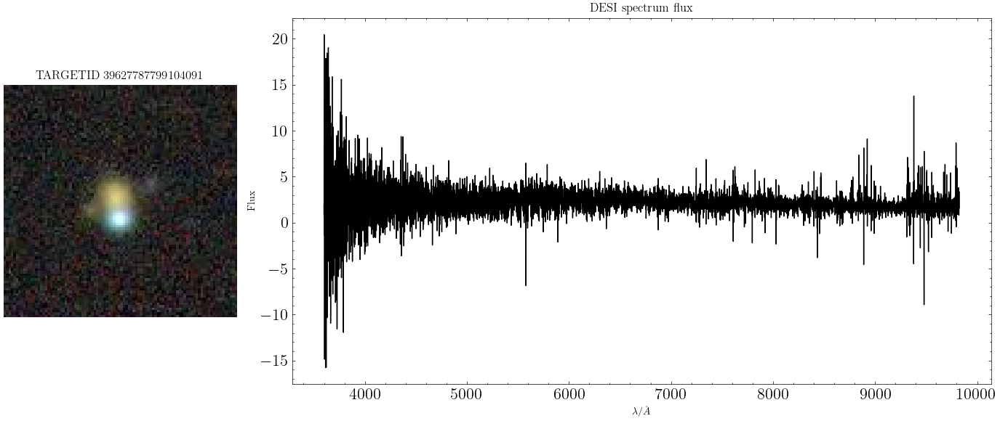

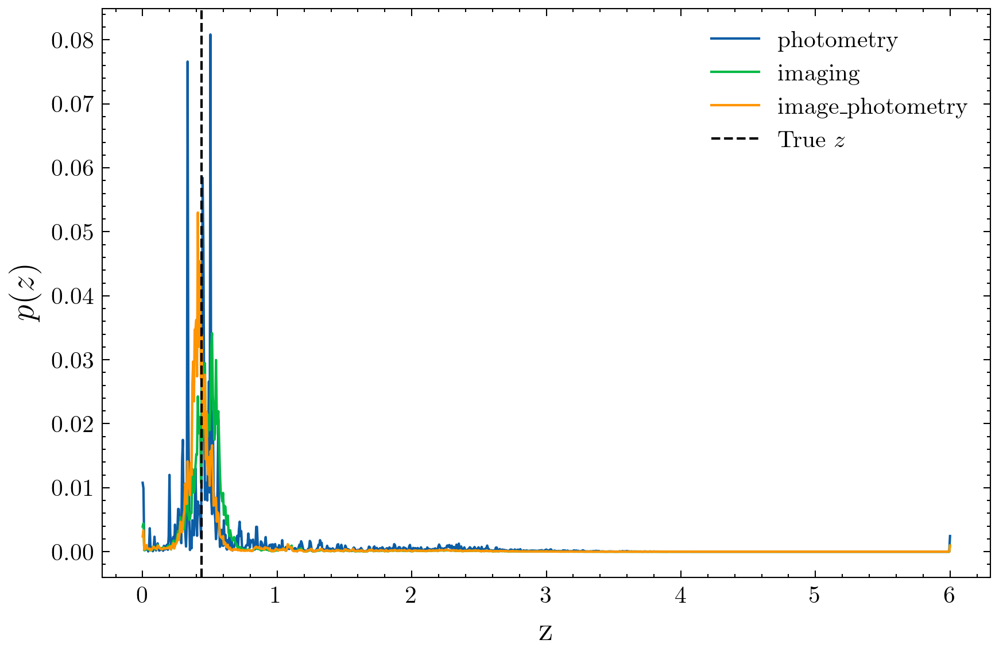

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763635722263,-8.566105,11.249489784240723,0.02137727,0.5028302


Z                                     8.260489
Photometry                           28.939014
Imaging                              22.628685
Spectroscopy                          0.000000
Image + Photometry                   25.101706
Image + Spectrum                      0.007693
Image + Spectrum + Photometry         0.034597
Image + Spectrum + Photometry + Z     0.029382
ratio_p_ip                            1.152870
ratio_p_ip_rank                       8.000000
Name: 3213, dtype: float64

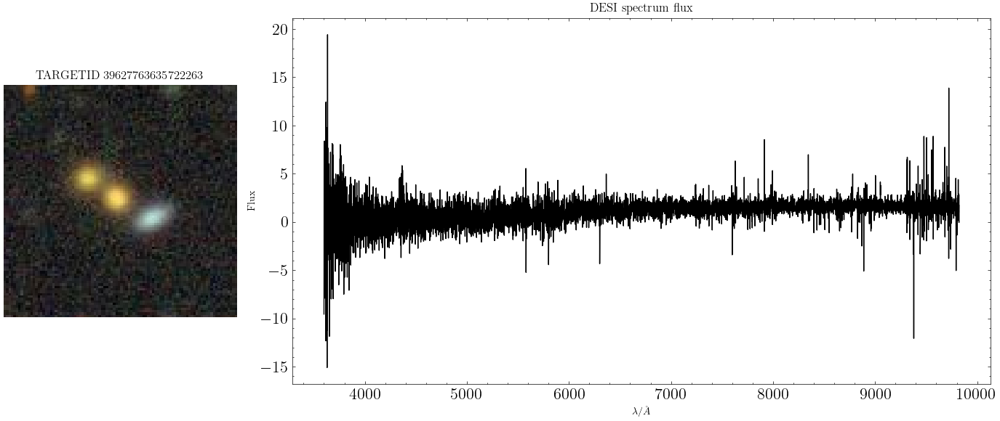

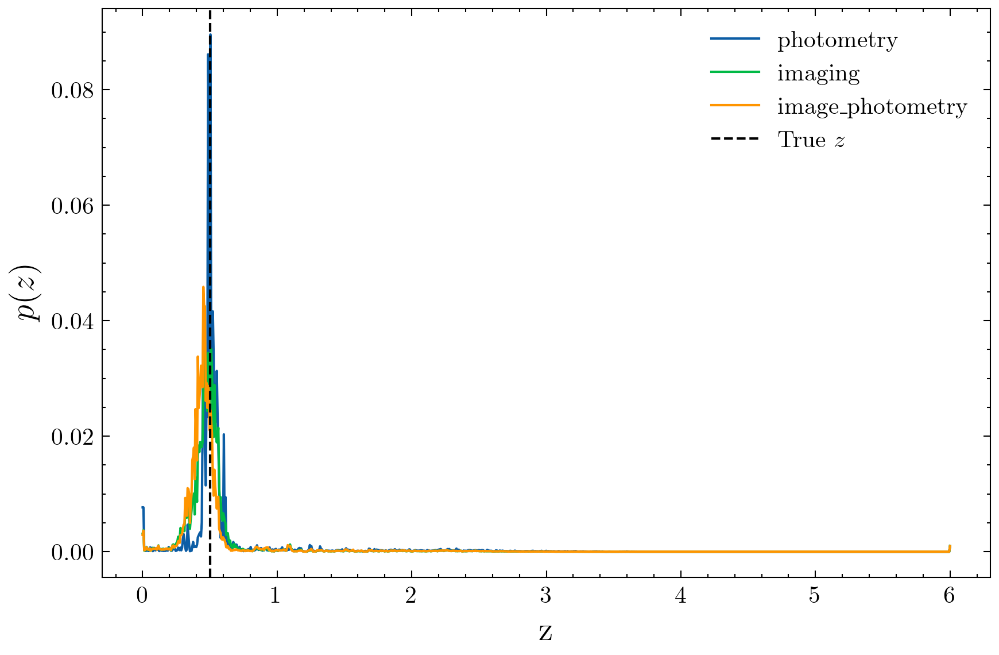

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781734142707,-7.9885125,12.322892189025879,0.01929538,0.46433604


Z                                    35.408356
Photometry                           36.231384
Imaging                              25.616596
Spectroscopy                          0.000000
Image + Photometry                   31.377304
Image + Spectrum                      0.005201
Image + Spectrum + Photometry         0.007564
Image + Spectrum + Photometry + Z     0.024179
ratio_p_ip                            1.154700
ratio_p_ip_rank                       9.000000
Name: 3758, dtype: float64

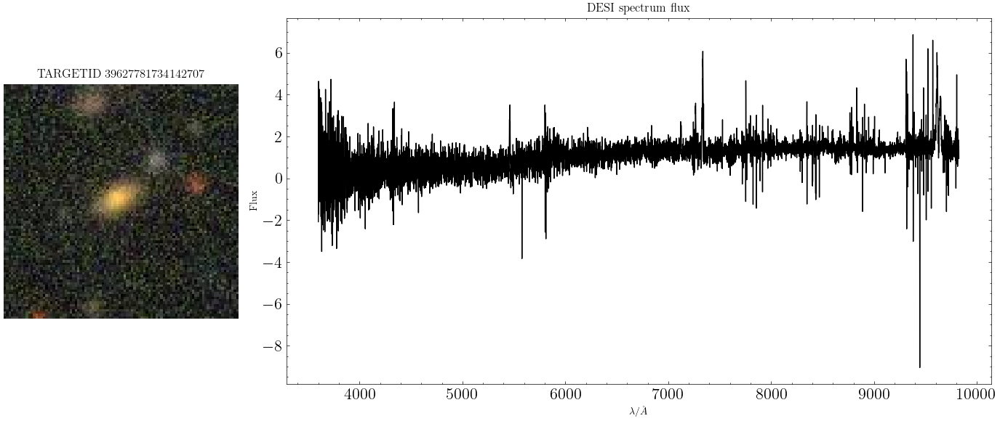

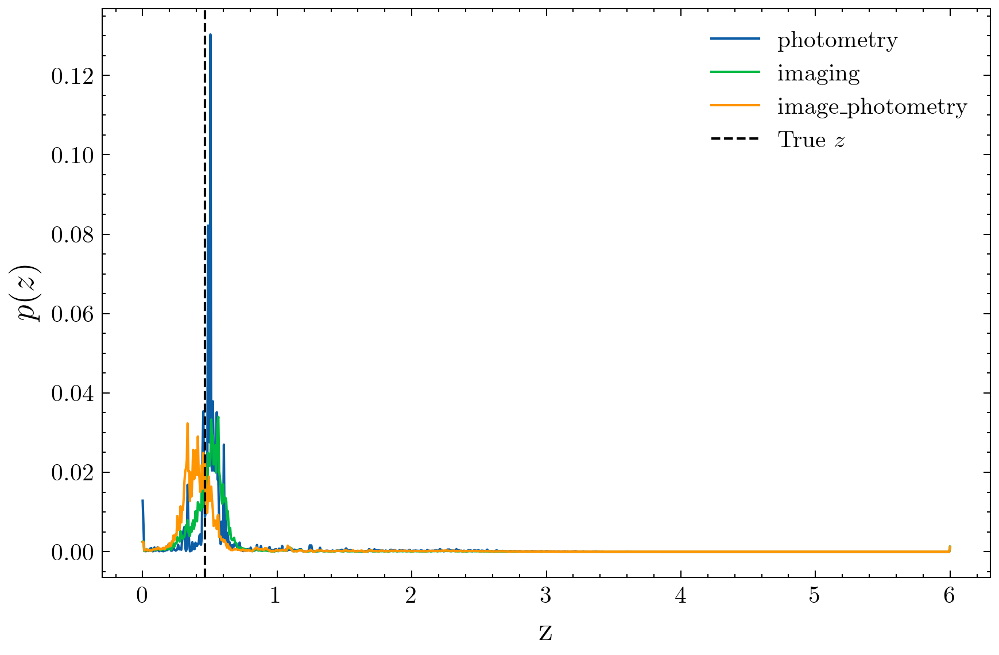

------------------------------------------------


In [41]:
plot_z_dist(
    check_df,
    table_sorted,
    names,
    tok_z_p,
    ascending=True 
)

Let's look at the galaxies best constrained using an image. These tend to have poor photometry.

In [42]:
threshold = 30 #1.05 # threshold at -10

#print(df.loc[(df["ratio_p_ip"] < threshold) == True])

# 2) Filter rows
mask = df["ratio_p_ip"] >= threshold
check_df = df.loc[mask].copy()

# 3a) Option A: add a rank column (1 = highest diff)
check_df["ratio_p_ip_rank"] = check_df["ratio_p_ip"].rank(ascending=False, method="dense")

# 3b) Option B: sort by the difference
check_df = check_df.sort_values("ratio_p_ip", ascending=False)

TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805901723027,-15.834083,8.973406791687012,0.024814619,0.01952745


Z                                     21.361233
Photometry                           396.806335
Imaging                                1.860196
Spectroscopy                           0.000000
Image + Photometry                     1.822519
Image + Spectrum                       2.640931
Image + Spectrum + Photometry          2.313402
Image + Spectrum + Photometry + Z      4.855231
ratio_p_ip                           217.724167
ratio_p_ip_rank                        1.000000
Name: 1783, dtype: float64

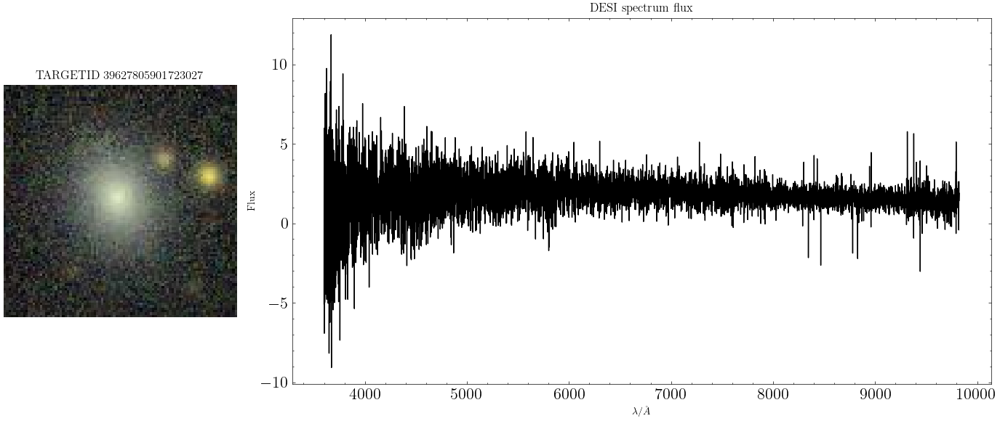

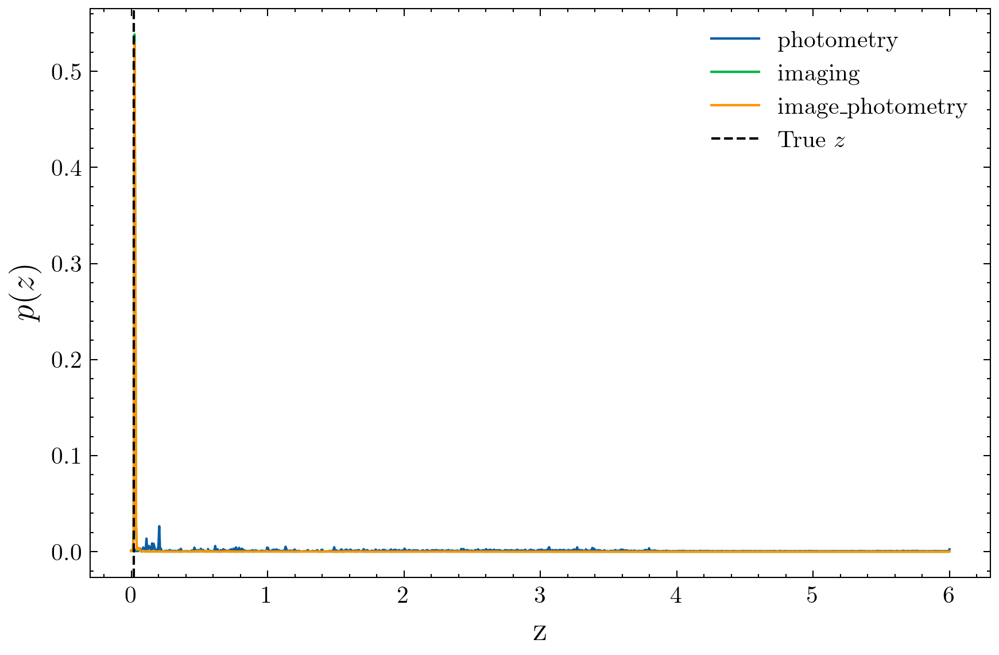

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627824029504560,-12.530321,11.813141822814941,0.025443997,0.584571


Z                                     26.011044
Photometry                           560.681519
Imaging                               15.419267
Spectroscopy                           0.000000
Image + Photometry                     6.653972
Image + Spectrum                       0.021495
Image + Spectrum + Photometry          0.025737
Image + Spectrum + Photometry + Z      0.060700
ratio_p_ip                            84.262688
ratio_p_ip_rank                        2.000000
Name: 2856, dtype: float64

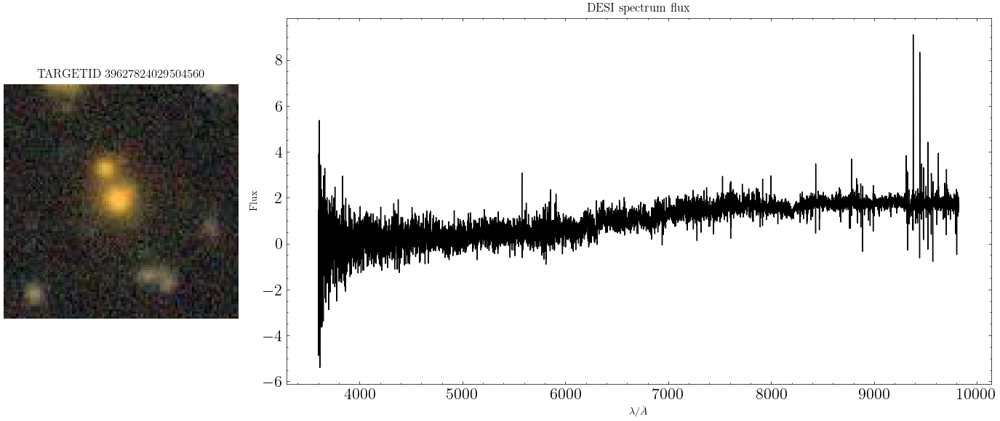

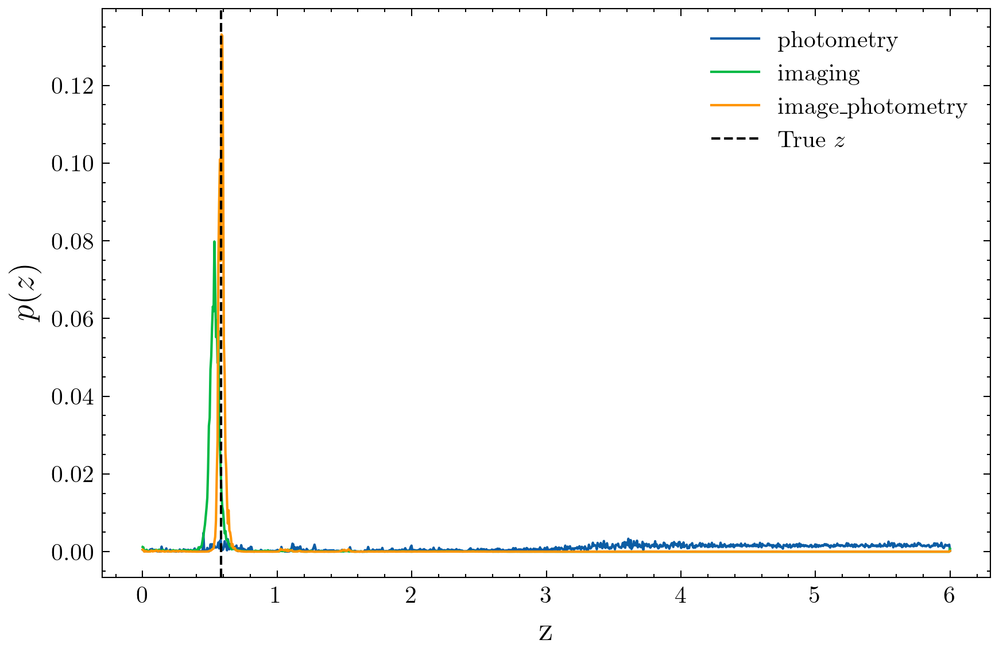

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811941517475,-11.171039,11.799324035644531,0.028494272,0.5786991


Z                                     22.429741
Photometry                           533.530273
Imaging                               16.147894
Spectroscopy                           0.000000
Image + Photometry                     6.557600
Image + Spectrum                       0.132342
Image + Spectrum + Photometry          0.150682
Image + Spectrum + Photometry + Z      0.134998
ratio_p_ip                            81.360603
ratio_p_ip_rank                        3.000000
Name: 2021, dtype: float64

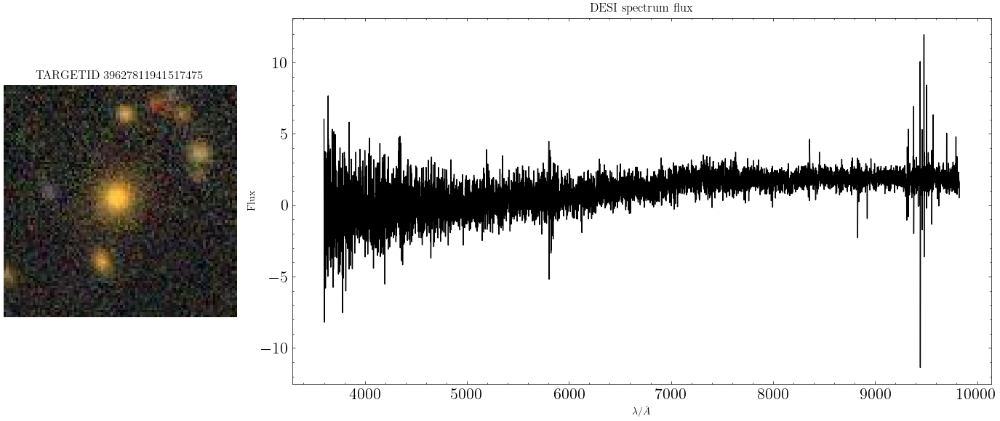

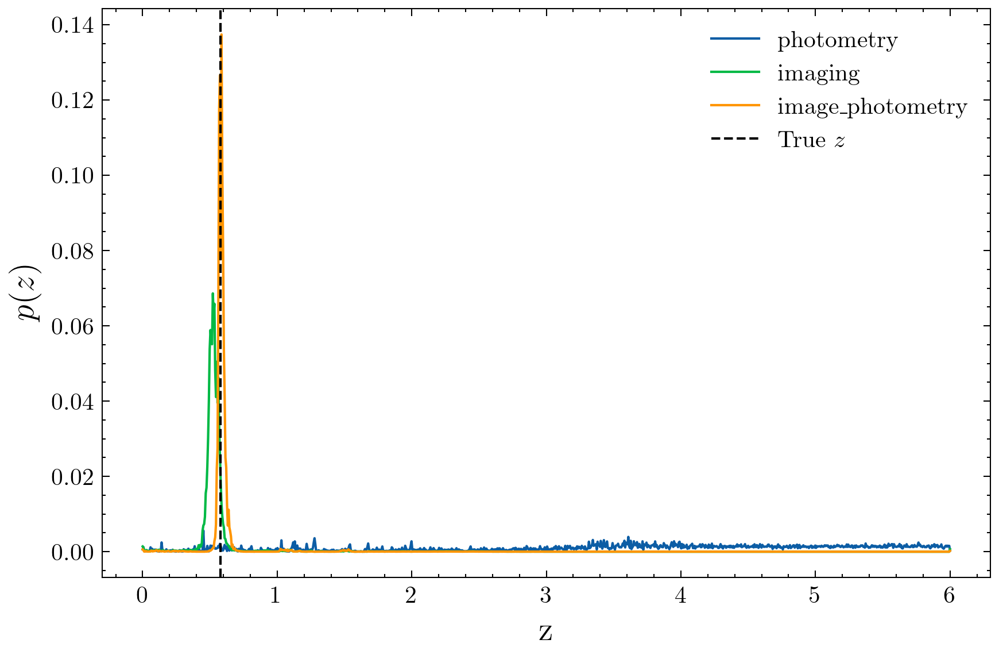

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627787765551173,-10.785342,12.13465690612793,0.023586571,0.5768452


Z                                     22.525084
Photometry                           458.784882
Imaging                               12.470707
Spectroscopy                           0.000000
Image + Photometry                     7.901842
Image + Spectrum                       0.046765
Image + Spectrum + Photometry          0.046228
Image + Spectrum + Photometry + Z      0.050721
ratio_p_ip                            58.060497
ratio_p_ip_rank                        4.000000
Name: 300, dtype: float64

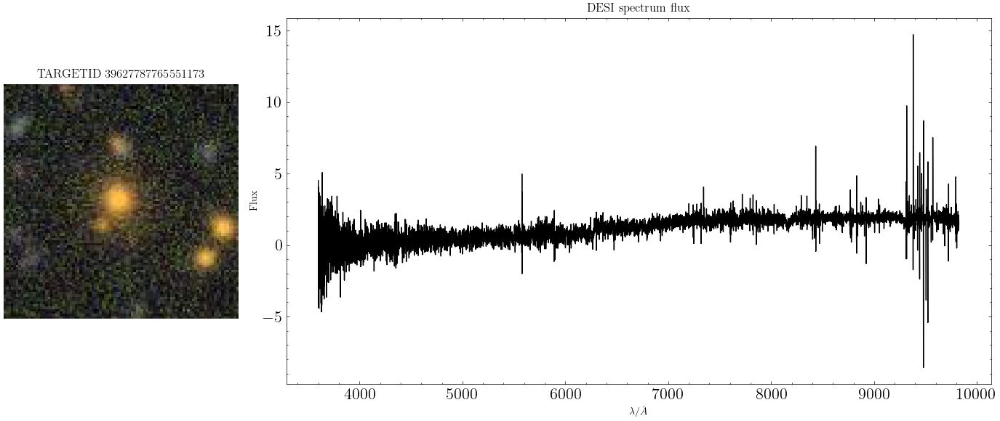

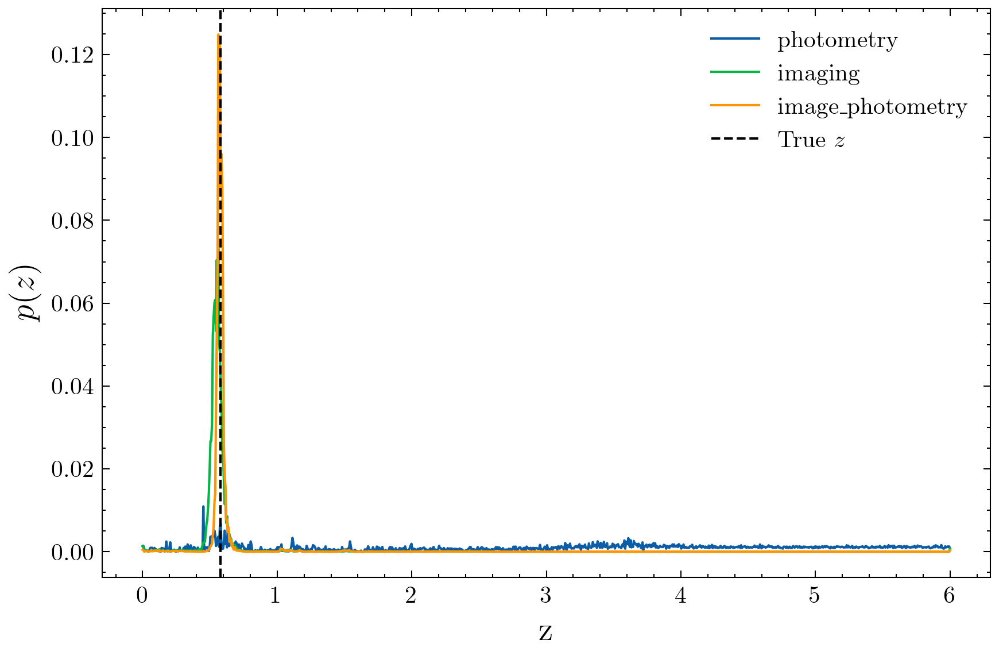

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627751560320350,-10.173411,11.804136276245117,0.021579899,0.5872443


Z                                     22.746298
Photometry                           466.531586
Imaging                               17.231266
Spectroscopy                           0.000000
Image + Photometry                     8.694493
Image + Spectrum                       0.081699
Image + Spectrum + Photometry          0.122117
Image + Spectrum + Photometry + Z      0.237109
ratio_p_ip                            53.658283
ratio_p_ip_rank                        5.000000
Name: 226, dtype: float64

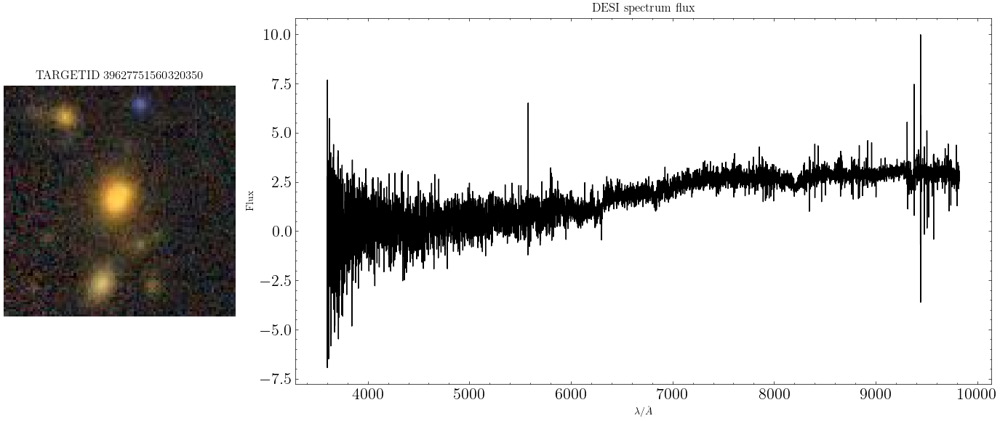

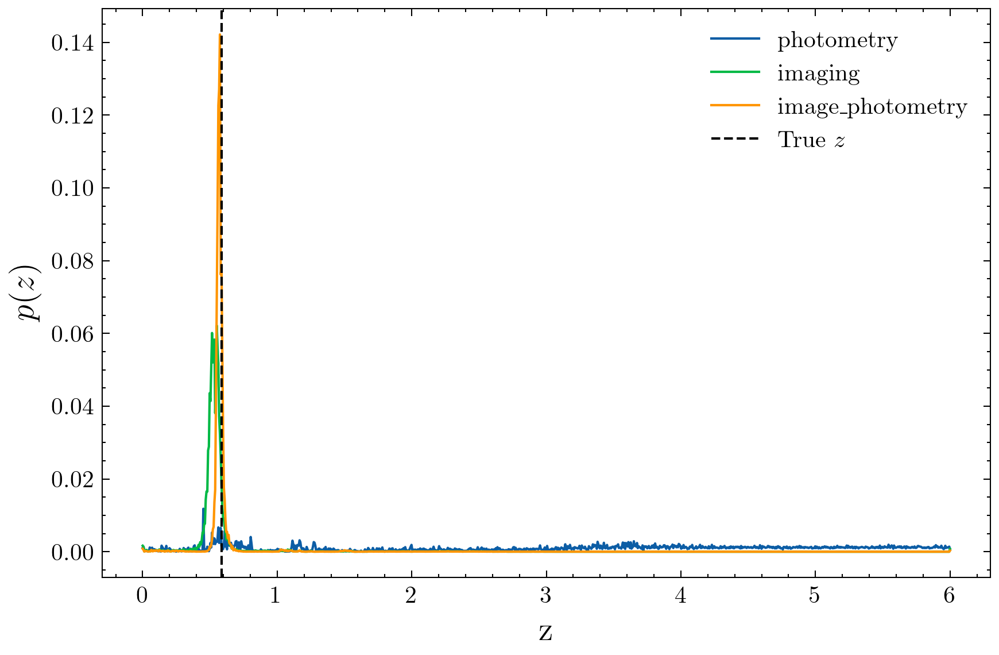

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793838899842,-12.4533205,9.160581588745117,0.027366748,0.06333147


Z                                      8.132374
Photometry                           450.687744
Imaging                               11.292500
Spectroscopy                           0.000000
Image + Photometry                    10.712807
Image + Spectrum                       6.545086
Image + Spectrum + Photometry         16.303213
Image + Spectrum + Photometry + Z     24.688755
ratio_p_ip                            42.069996
ratio_p_ip_rank                        6.000000
Name: 1073, dtype: float64

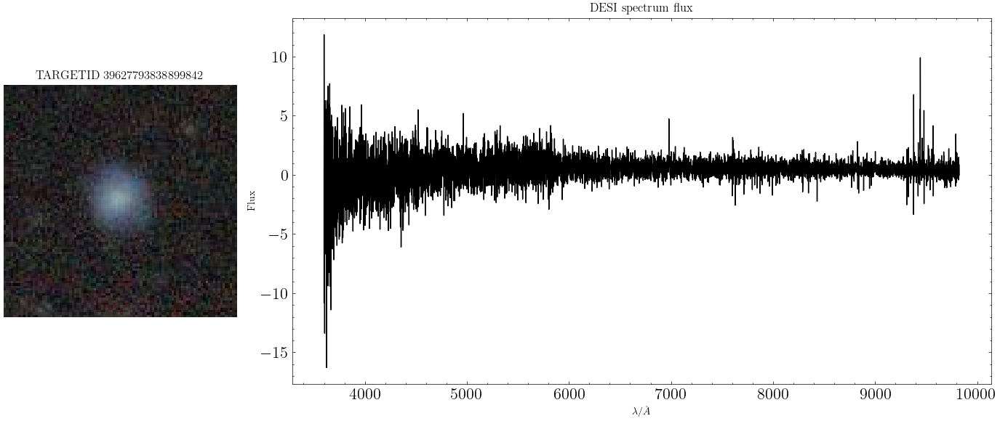

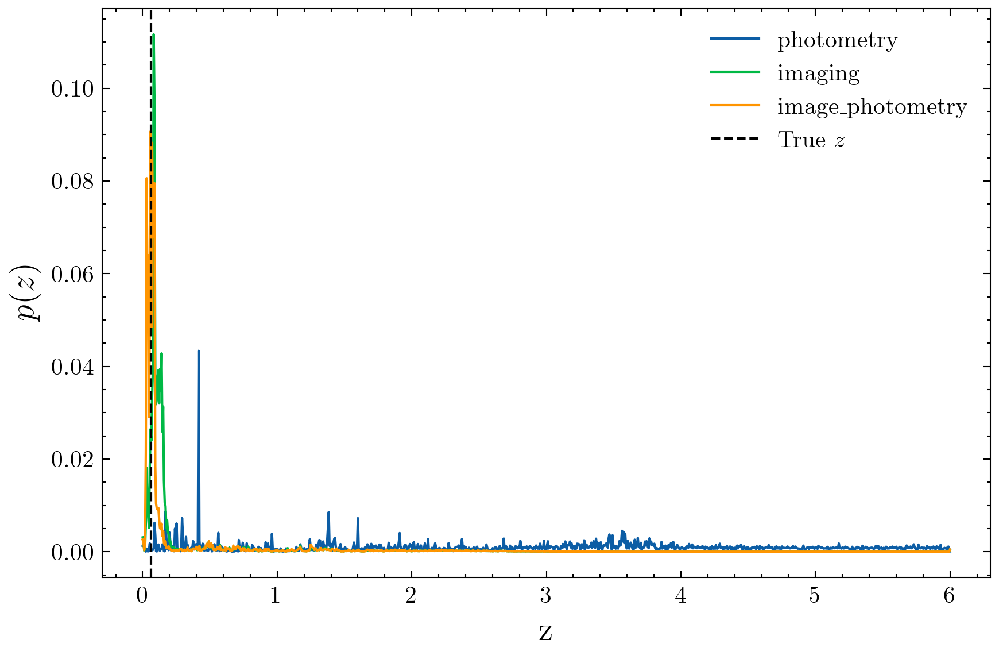

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811958295632,-12.419126,10.644575119018555,0.032959666,0.12508689


Z                                     19.236914
Photometry                           685.074890
Imaging                               20.900112
Spectroscopy                           0.000000
Image + Photometry                    16.630074
Image + Spectrum                       0.043869
Image + Spectrum + Photometry          0.048986
Image + Spectrum + Photometry + Z      0.018029
ratio_p_ip                            41.194939
ratio_p_ip_rank                        7.000000
Name: 2313, dtype: float64

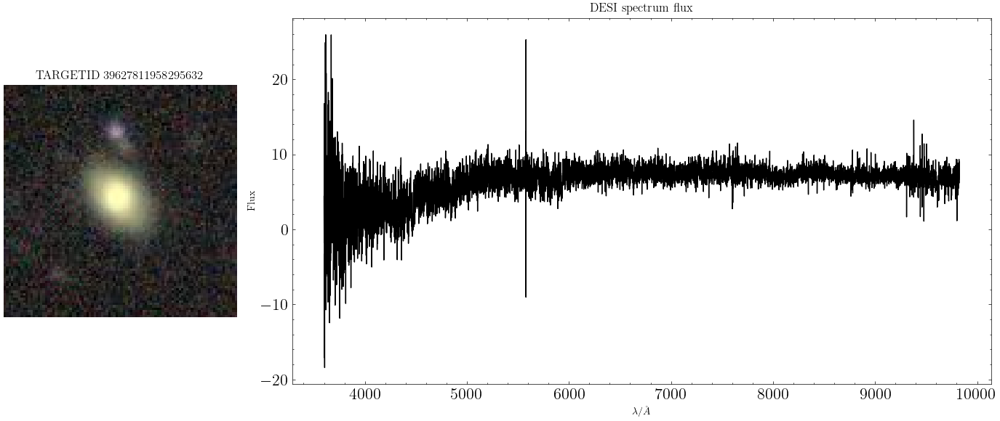

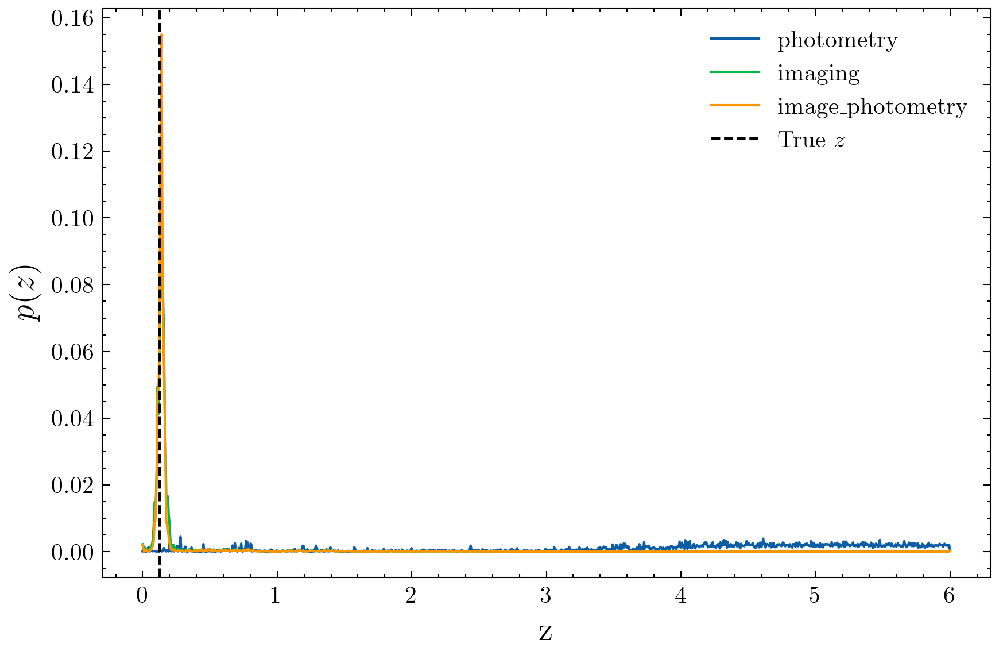

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627818002287156,-11.462424,10.91611385345459,0.03377406,0.15338351


Z                                     10.765952
Photometry                           659.180176
Imaging                               20.188496
Spectroscopy                           0.000000
Image + Photometry                    17.033905
Image + Spectrum                       0.041850
Image + Spectrum + Photometry          0.047038
Image + Spectrum + Photometry + Z      0.030961
ratio_p_ip                            38.698124
ratio_p_ip_rank                        8.000000
Name: 2547, dtype: float64

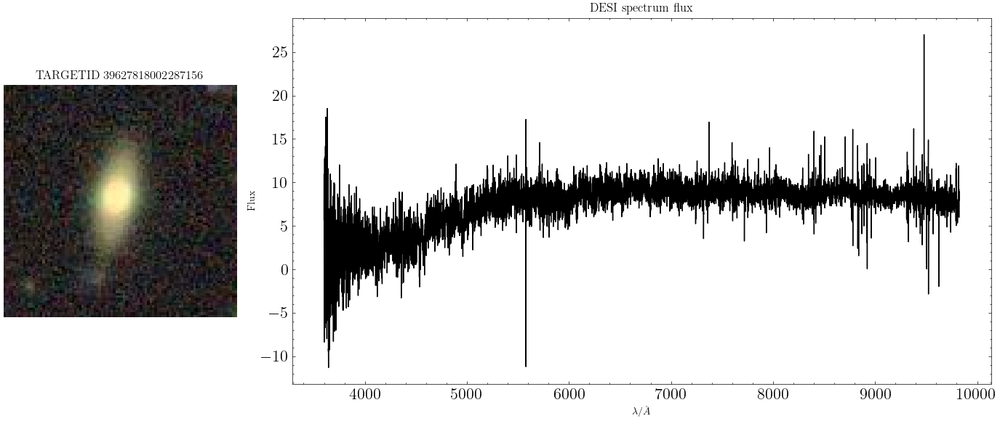

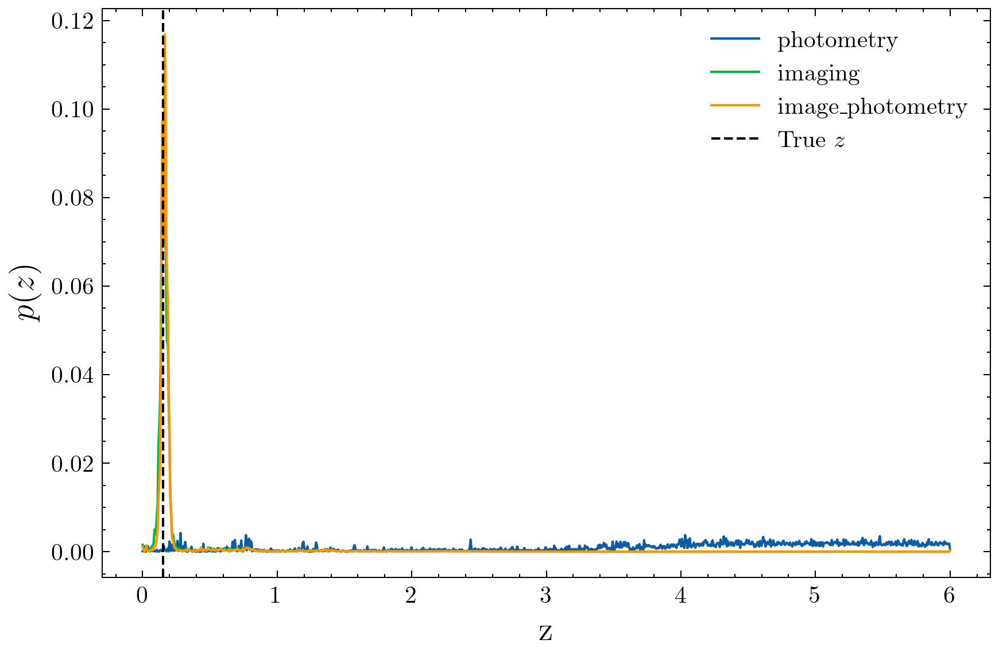

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793830511295,-13.49415,10.350564002990723,0.023113875,0.09564068


Z                                     13.087070
Photometry                           697.094849
Imaging                               20.486740
Spectroscopy                           0.000000
Image + Photometry                    18.110506
Image + Spectrum                       0.006224
Image + Spectrum + Photometry          0.004411
Image + Spectrum + Photometry + Z      0.003082
ratio_p_ip                            38.491184
ratio_p_ip_rank                        9.000000
Name: 954, dtype: float64

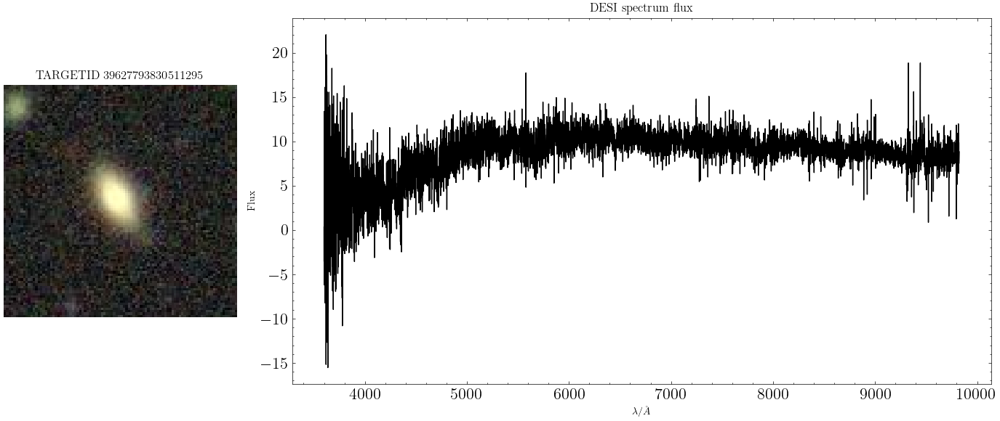

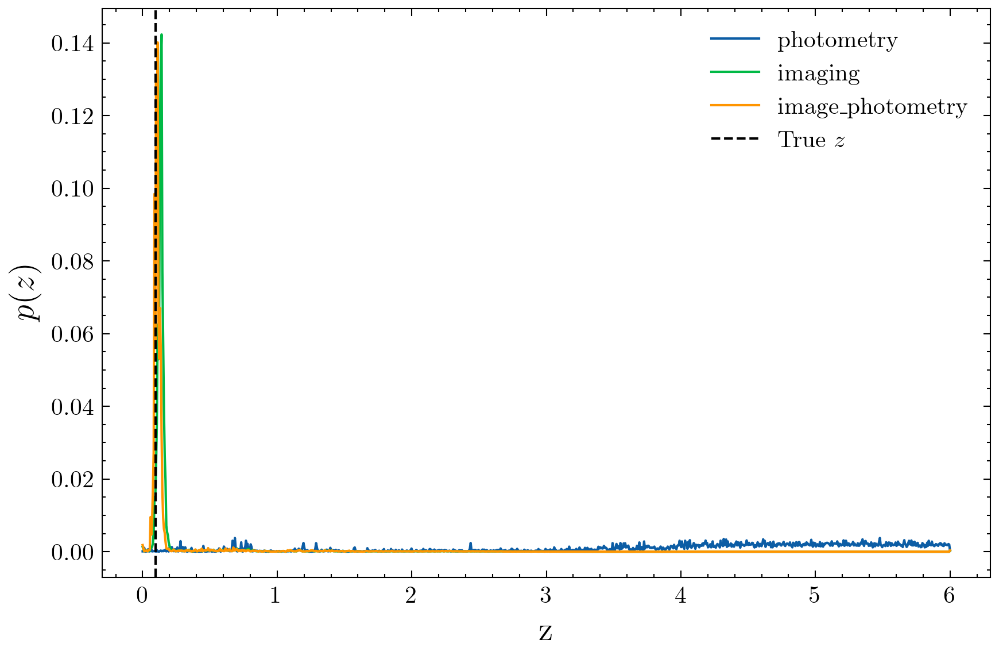

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805910111159,-14.771024,8.656739234924316,0.028197091,0.01897276


Z                                     23.375887
Photometry                           334.340759
Imaging                                8.172920
Spectroscopy                           0.000000
Image + Photometry                     8.721924
Image + Spectrum                       7.099023
Image + Spectrum + Photometry          6.958707
Image + Spectrum + Photometry + Z      7.836458
ratio_p_ip                            38.333374
ratio_p_ip_rank                       10.000000
Name: 1915, dtype: float64

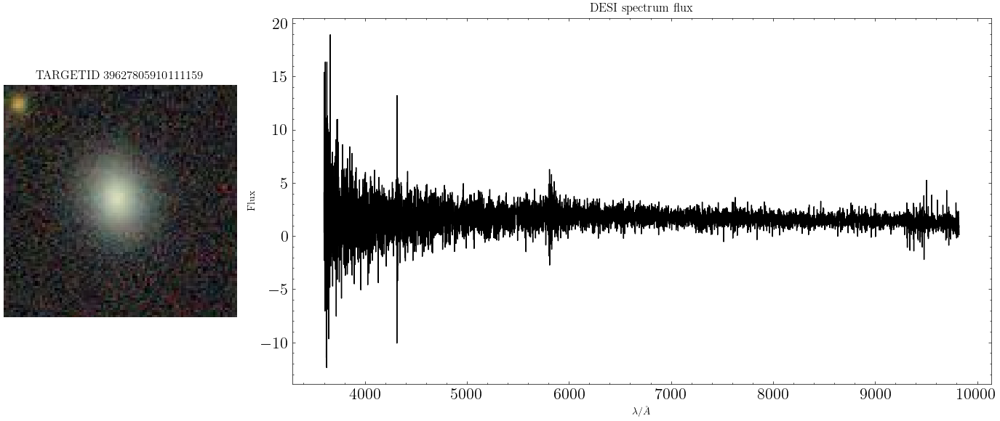

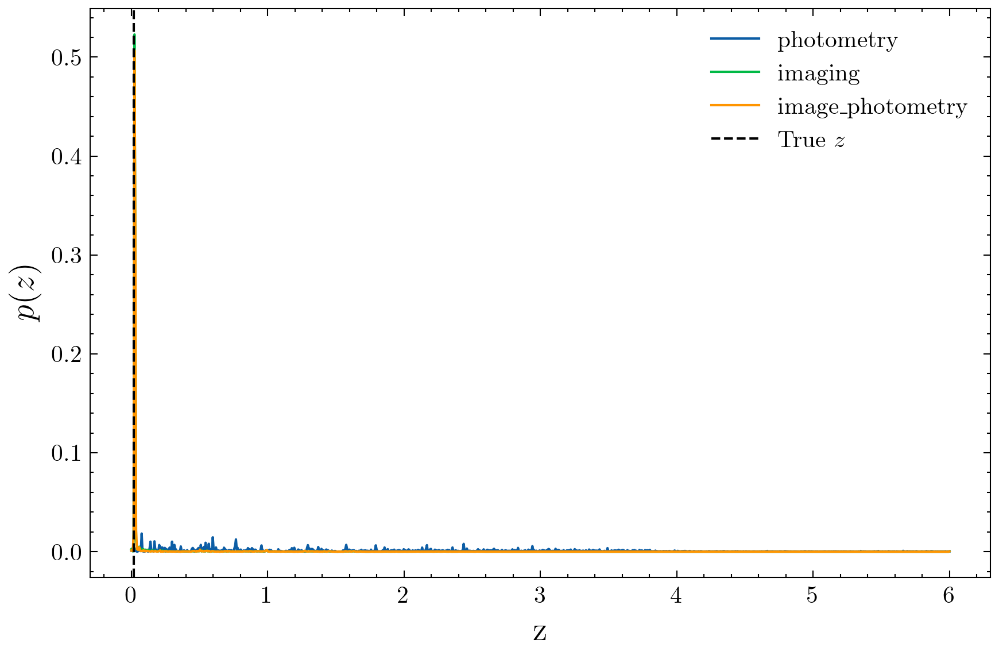

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781717363782,-14.578751,10.597193717956543,0.023749094,0.11771579


Z                                     18.982327
Photometry                           686.007263
Imaging                               22.469707
Spectroscopy                           0.000000
Image + Photometry                    18.066233
Image + Spectrum                       0.036546
Image + Spectrum + Photometry          0.073717
Image + Spectrum + Photometry + Z      0.017897
ratio_p_ip                            37.971794
ratio_p_ip_rank                       11.000000
Name: 3561, dtype: float64

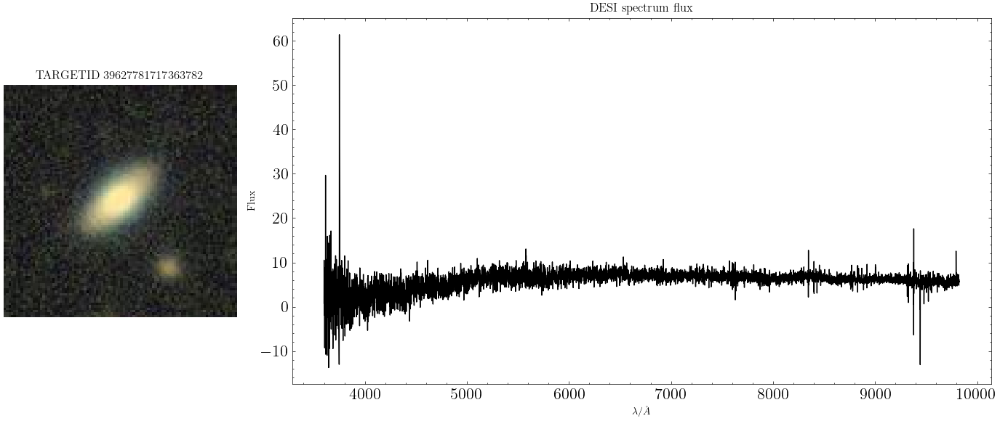

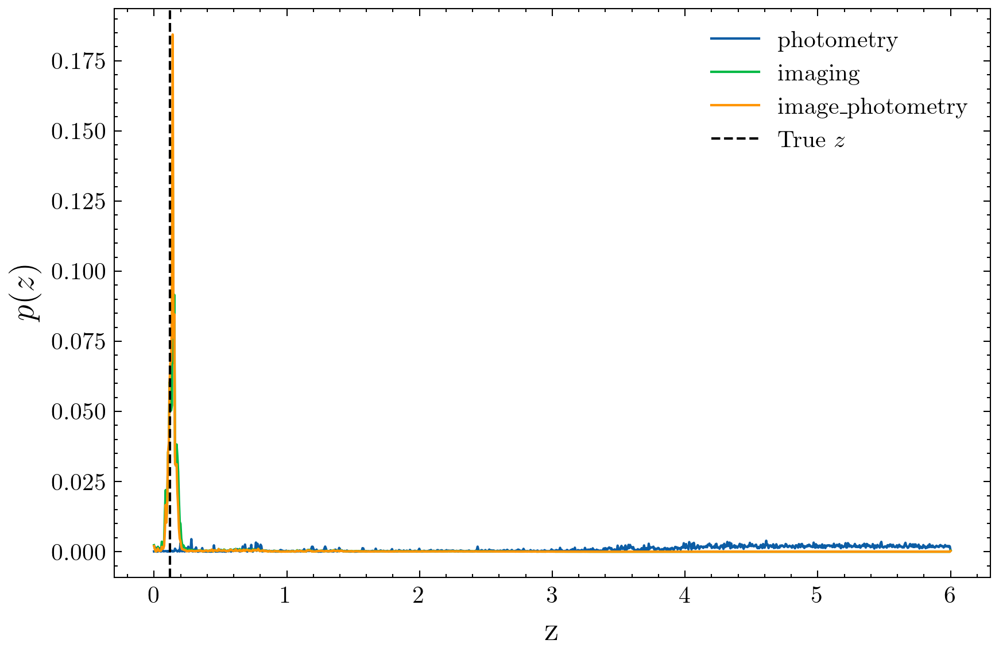

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811958295503,-10.257601,10.399767875671387,0.02989747,0.1245267


Z                                     19.176701
Photometry                           661.779236
Imaging                               19.369900
Spectroscopy                           0.000000
Image + Photometry                    17.681875
Image + Spectrum                       0.080653
Image + Spectrum + Photometry          0.085802
Image + Spectrum + Photometry + Z      0.075605
ratio_p_ip                            37.426983
ratio_p_ip_rank                       12.000000
Name: 2312, dtype: float64

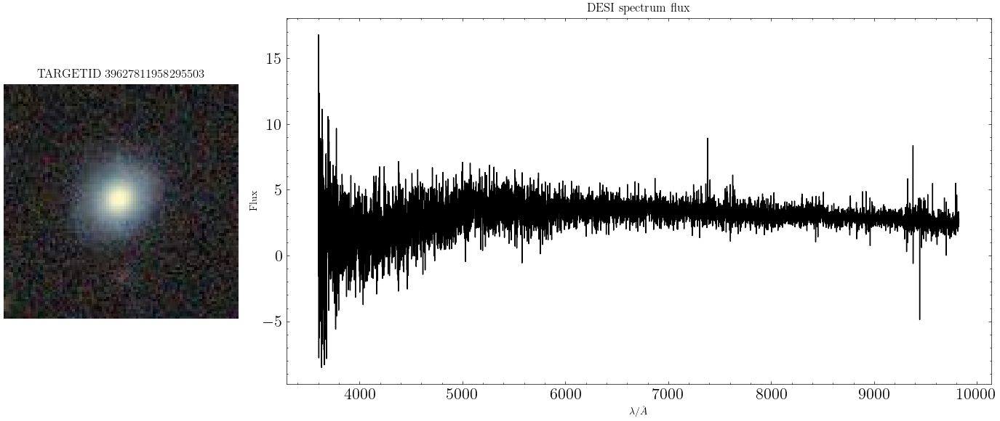

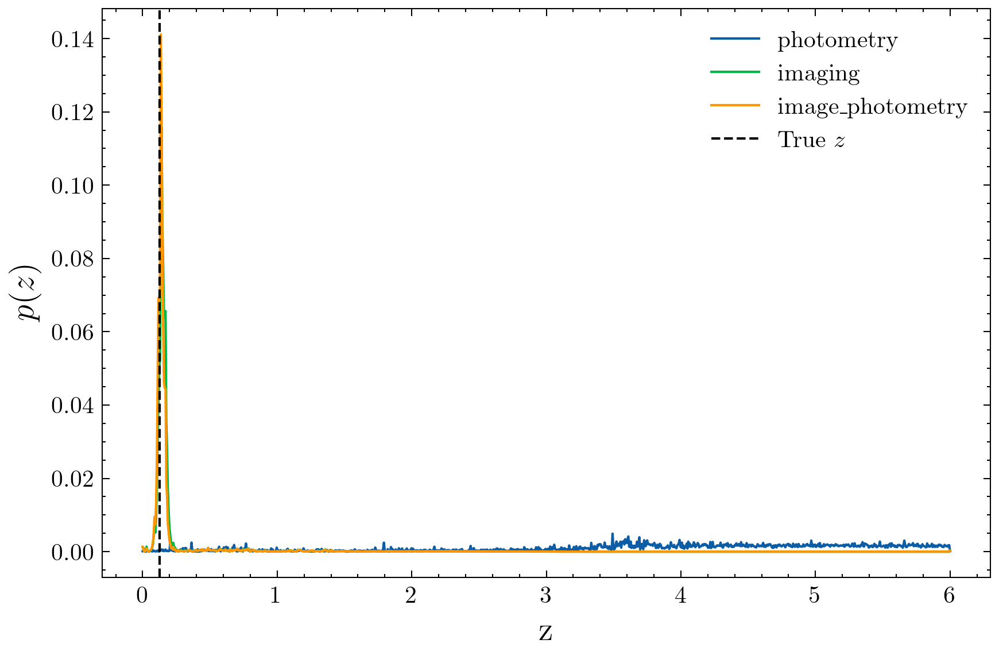

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627775694342667,-10.615402,10.500448226928711,0.018510567,0.12997773


Z                                     20.035406
Photometry                           688.561890
Imaging                               18.145224
Spectroscopy                           0.000000
Image + Photometry                    18.965149
Image + Spectrum                       0.028348
Image + Spectrum + Photometry          0.027416
Image + Spectrum + Photometry + Z      0.024781
ratio_p_ip                            36.306694
ratio_p_ip_rank                       13.000000
Name: 3432, dtype: float64

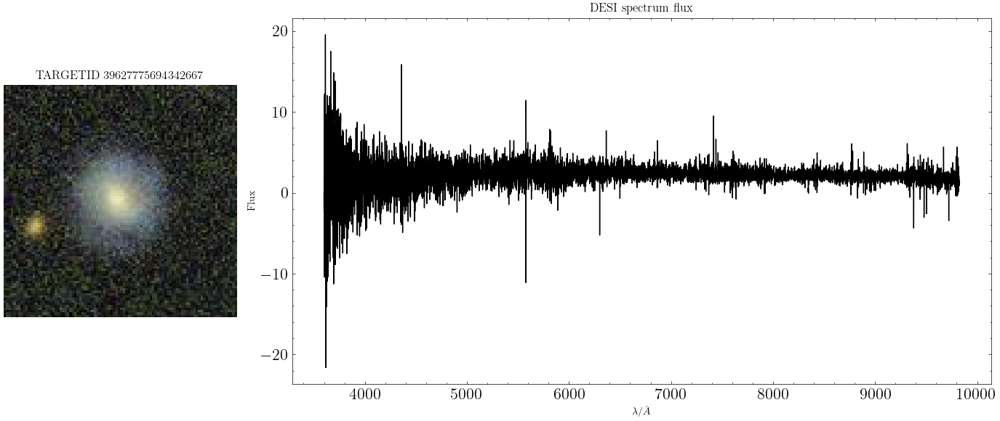

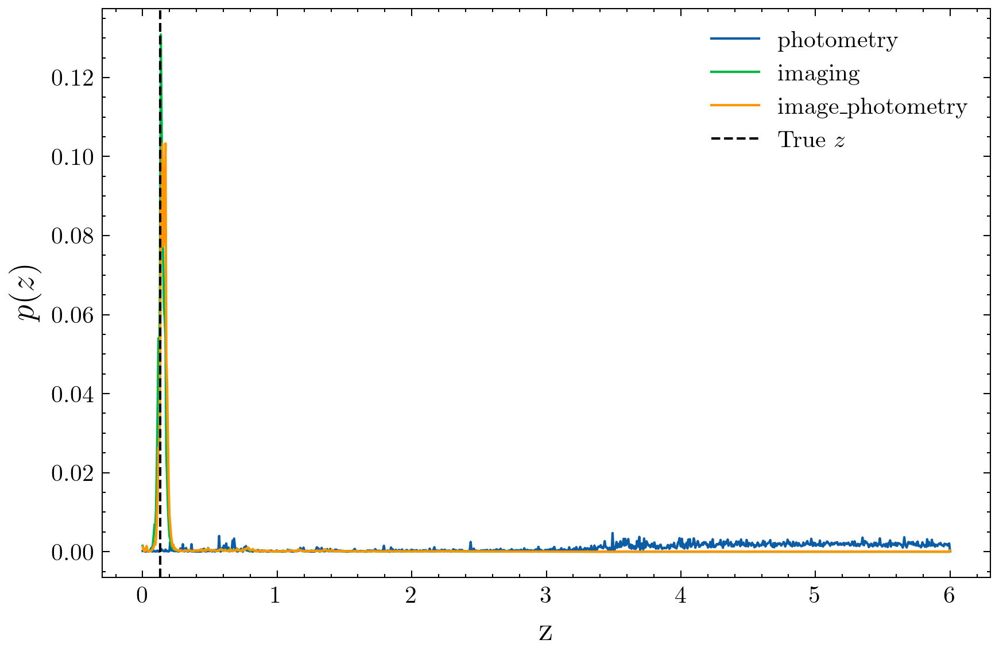

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805910109973,-13.921593,8.707478523254395,0.028308174,0.020388175


Z                                     32.638824
Photometry                           683.985962
Imaging                               14.059603
Spectroscopy                           0.000000
Image + Photometry                    18.874502
Image + Spectrum                       0.234559
Image + Spectrum + Photometry          0.148532
Image + Spectrum + Photometry + Z      0.080322
ratio_p_ip                            36.238621
ratio_p_ip_rank                       14.000000
Name: 1901, dtype: float64

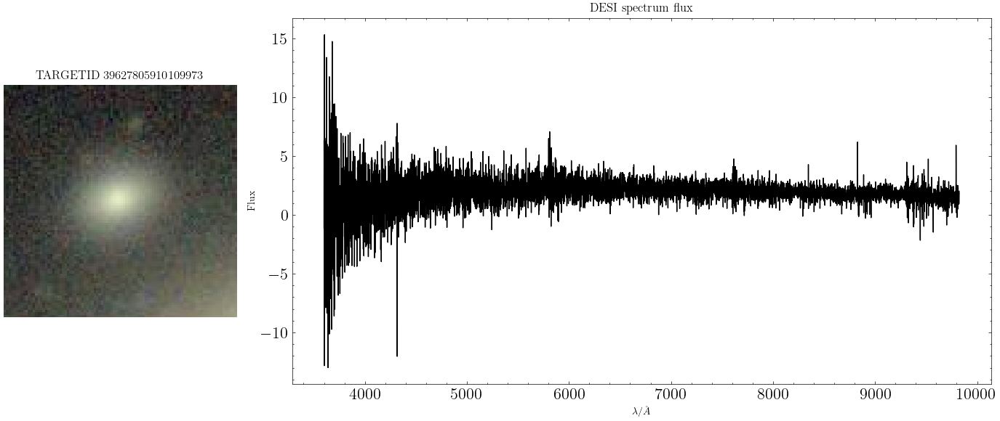

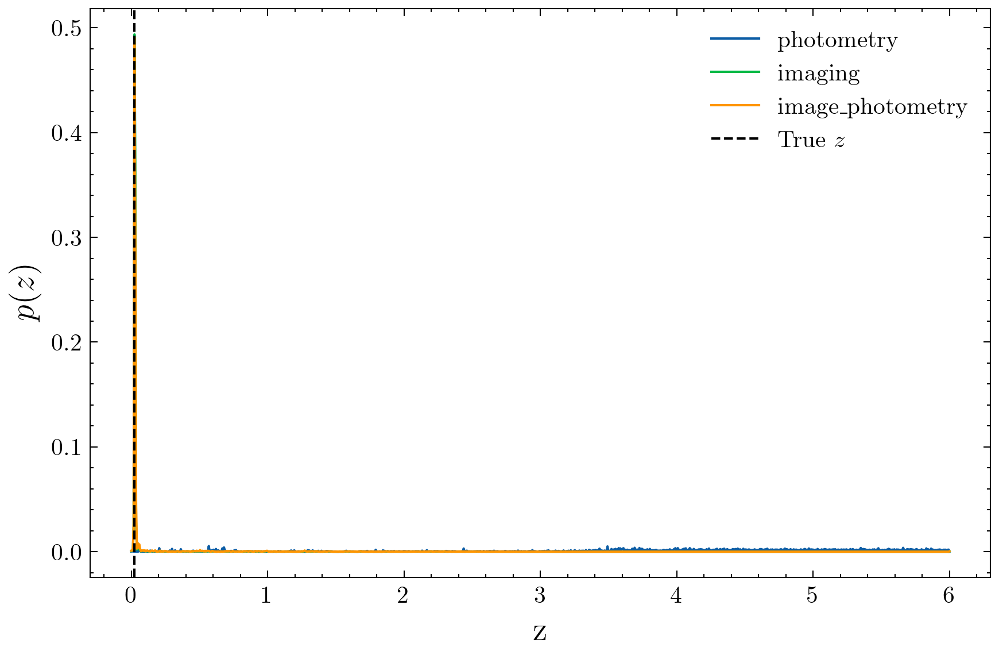

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763639914451,-10.957174,9.844000816345215,0.022192143,0.099401794


Z                                      5.001126
Photometry                           418.657196
Imaging                               11.917477
Spectroscopy                           0.000000
Image + Photometry                    11.650346
Image + Spectrum                       2.953482
Image + Spectrum + Photometry          2.561156
Image + Spectrum + Photometry + Z     10.940001
ratio_p_ip                            35.935173
ratio_p_ip_rank                       15.000000
Name: 3258, dtype: float64

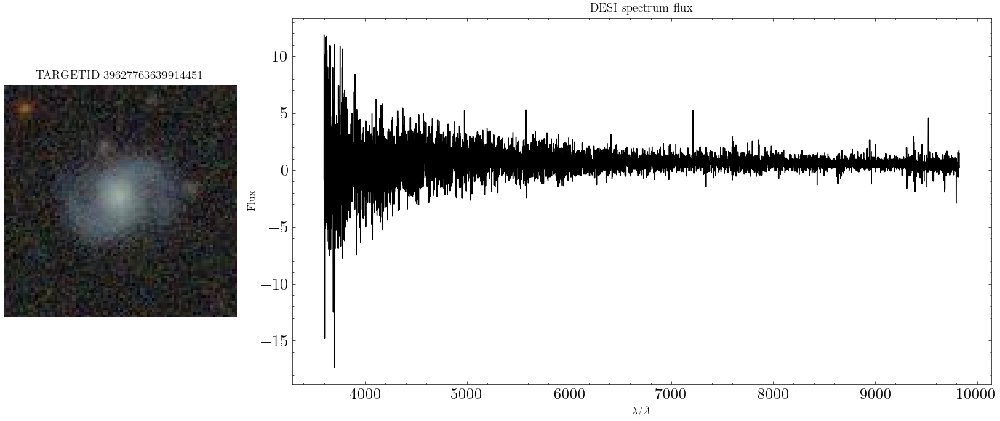

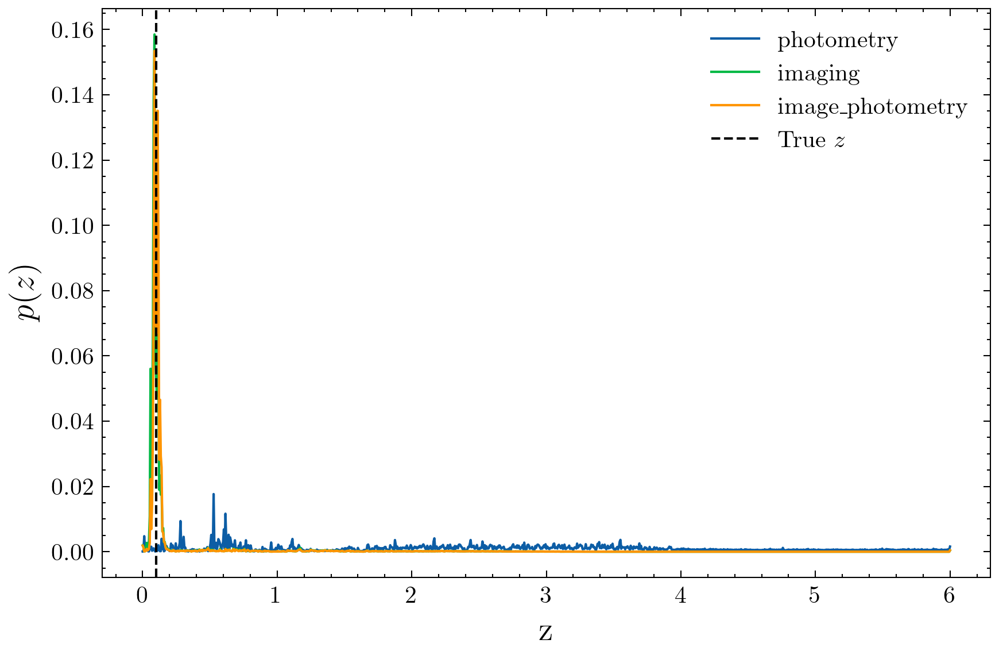

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627817998093040,-10.3589945,10.291114807128906,0.031220434,0.091543846


Z                                     17.620869
Photometry                           709.324646
Imaging                               18.297615
Spectroscopy                           0.000000
Image + Photometry                    19.819744
Image + Spectrum                       0.010040
Image + Spectrum + Photometry          0.005585
Image + Spectrum + Photometry + Z      0.003887
ratio_p_ip                            35.788788
ratio_p_ip_rank                       16.000000
Name: 2481, dtype: float64

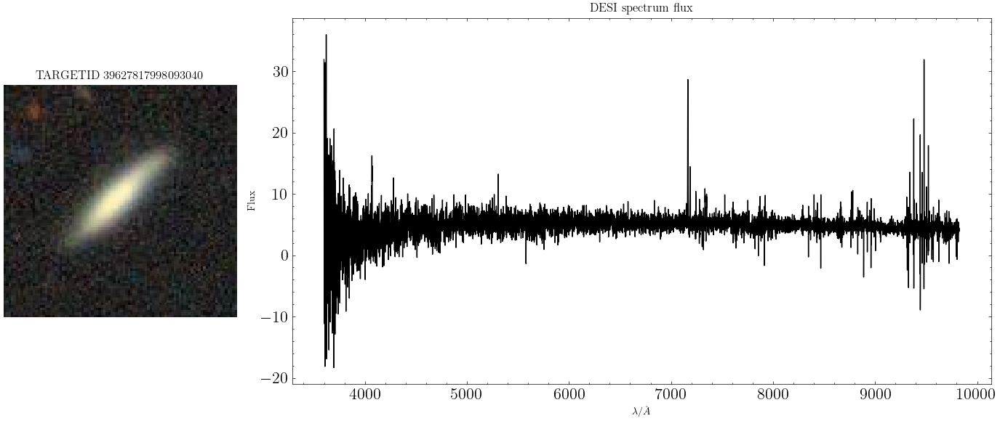

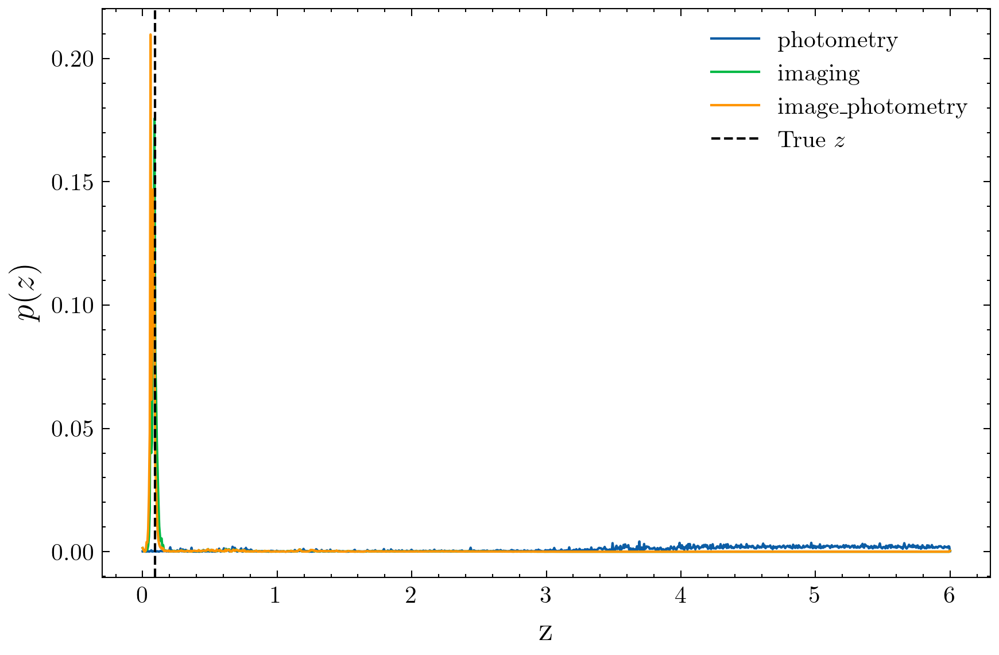

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793822125482,-11.302694,10.640060424804688,0.024227265,0.120204024


Z                                     19.036011
Photometry                           659.637634
Imaging                               18.872398
Spectroscopy                           0.000000
Image + Photometry                    18.617245
Image + Spectrum                       0.042488
Image + Spectrum + Photometry          0.044841
Image + Spectrum + Photometry + Z      0.028463
ratio_p_ip                            35.431538
ratio_p_ip_rank                       17.000000
Name: 901, dtype: float64

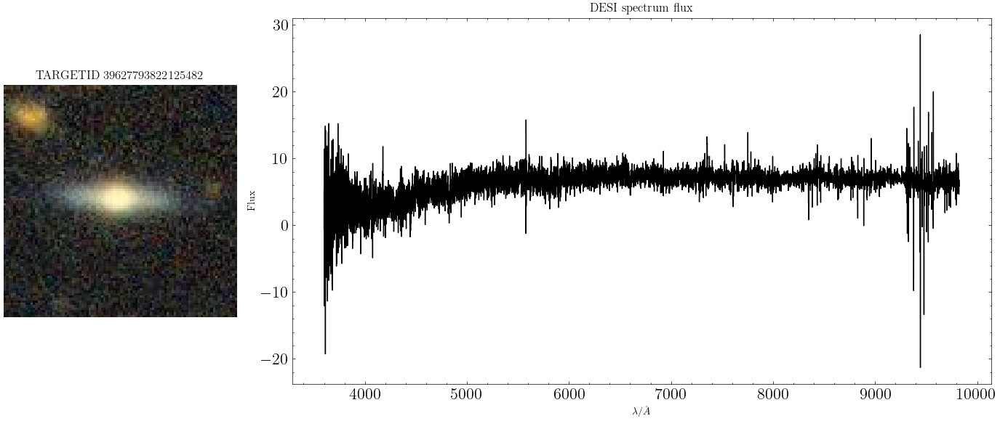

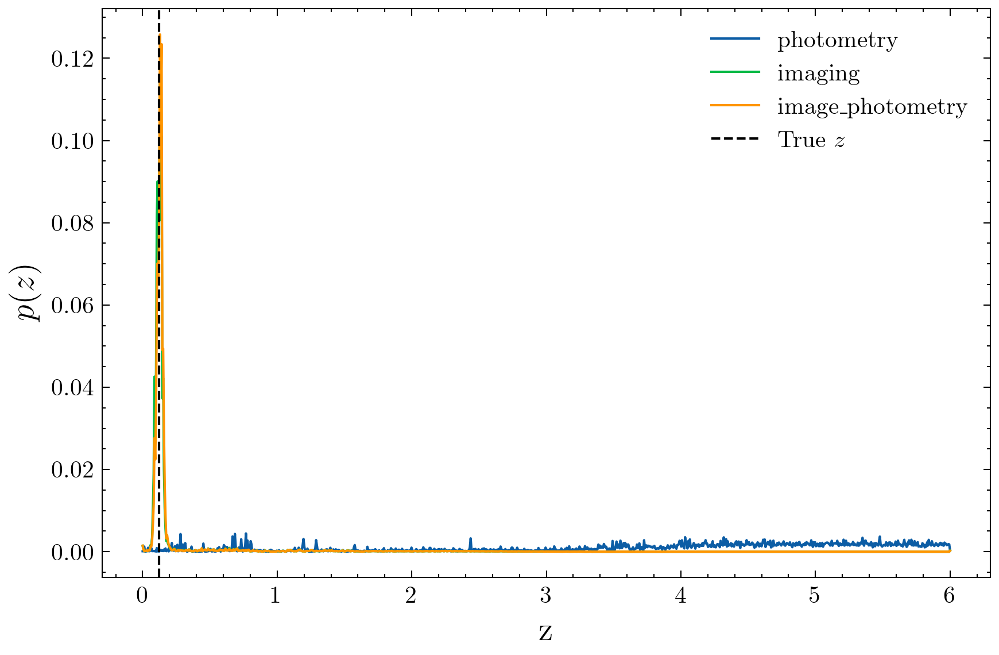

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781717363030,-15.386936,10.77125072479248,0.024488894,0.14425951


Z                                     25.930887
Photometry                           662.476440
Imaging                               24.071848
Spectroscopy                           0.000000
Image + Photometry                    18.840456
Image + Spectrum                       0.185374
Image + Spectrum + Photometry          0.181342
Image + Spectrum + Photometry + Z      0.174951
ratio_p_ip                            35.162441
ratio_p_ip_rank                       18.000000
Name: 3553, dtype: float64

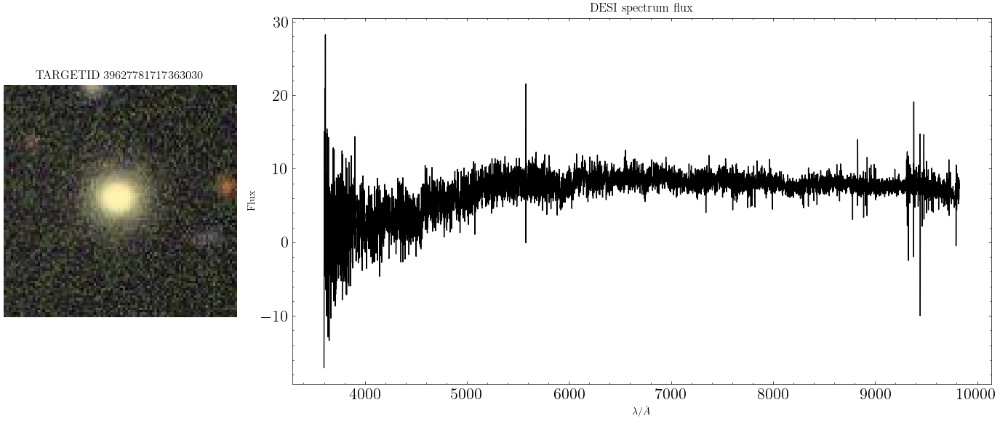

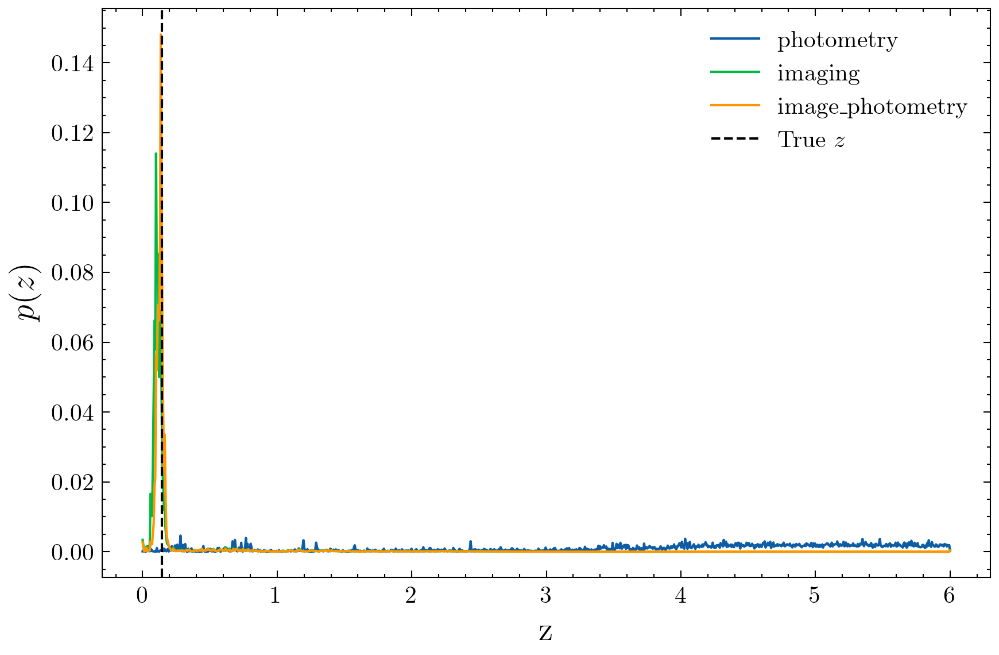

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627775694343689,-10.752632,10.27755069732666,0.019986562,0.09569986


Z                                     12.858727
Photometry                           713.286194
Imaging                               20.159966
Spectroscopy                           0.000000
Image + Photometry                    20.342159
Image + Spectrum                       0.130810
Image + Spectrum + Photometry          0.093708
Image + Spectrum + Photometry + Z      0.139467
ratio_p_ip                            35.064430
ratio_p_ip_rank                       19.000000
Name: 3444, dtype: float64

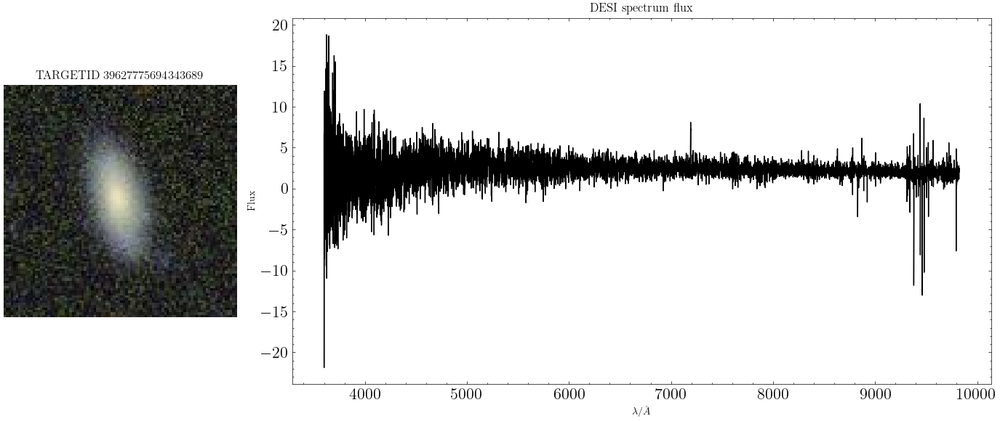

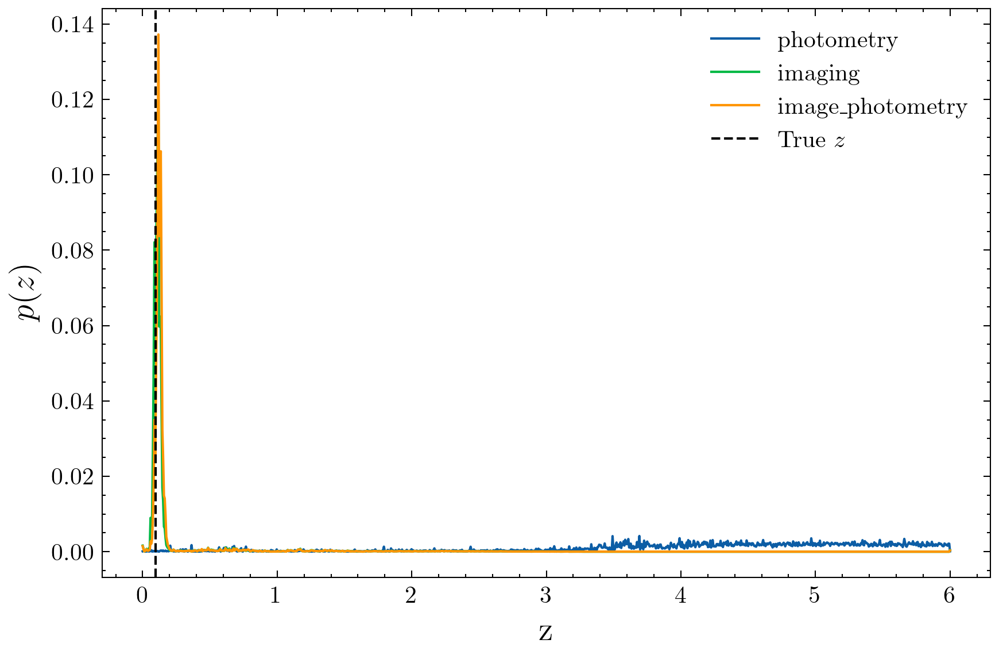

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781721558753,-12.941691,10.49565601348877,0.026339142,0.110310964


Z                                     27.154144
Photometry                           688.065491
Imaging                               22.887533
Spectroscopy                           0.000000
Image + Photometry                    19.797915
Image + Spectrum                       0.016015
Image + Spectrum + Photometry          0.016067
Image + Spectrum + Photometry + Z      0.006322
ratio_p_ip                            34.754444
ratio_p_ip_rank                       20.000000
Name: 3641, dtype: float64

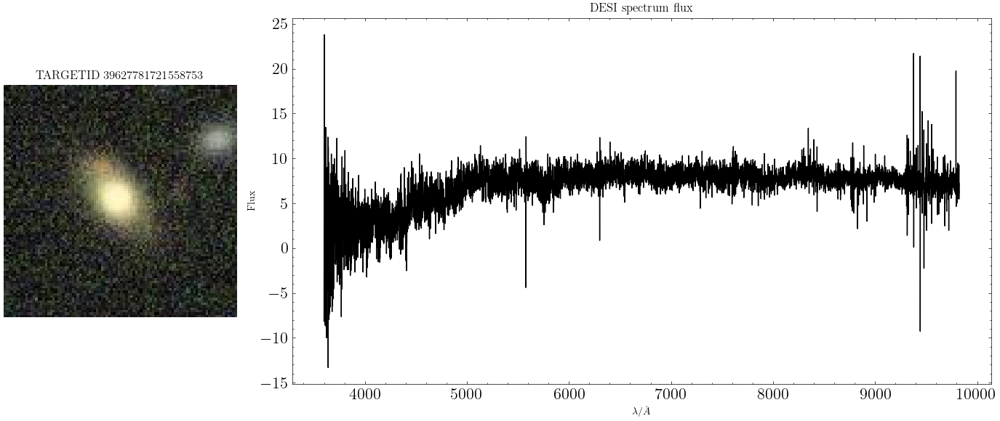

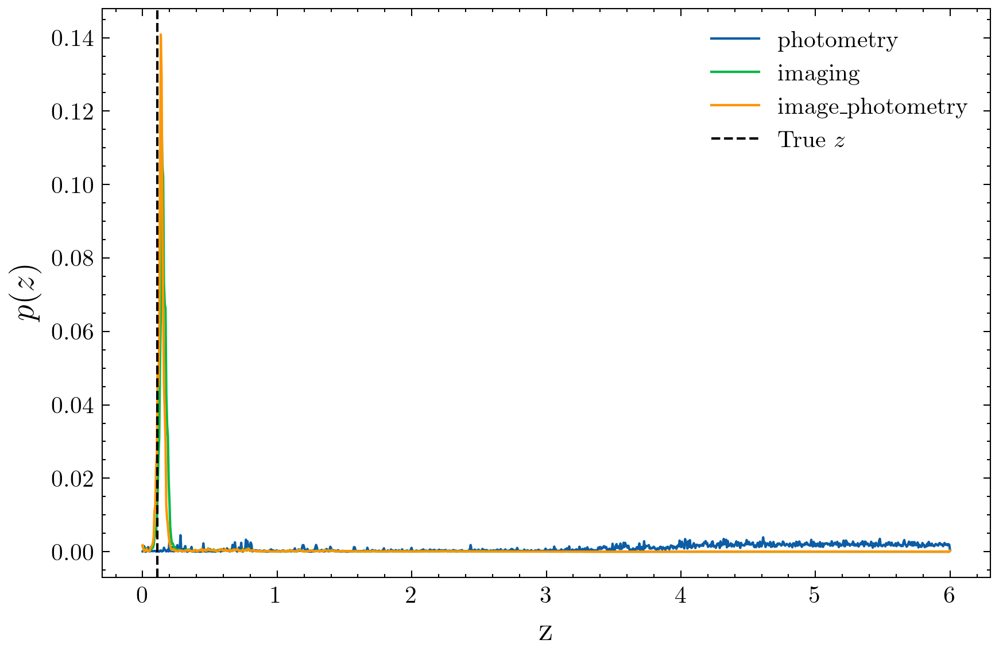

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793801155287,-9.930141,10.632078170776367,0.023319695,0.13063742


Z                                     20.064972
Photometry                           654.882568
Imaging                               19.872019
Spectroscopy                           0.000000
Image + Photometry                    18.910397
Image + Spectrum                       0.011044
Image + Spectrum + Photometry          0.005032
Image + Spectrum + Photometry + Z      0.003859
ratio_p_ip                            34.630821
ratio_p_ip_rank                       21.000000
Name: 766, dtype: float64

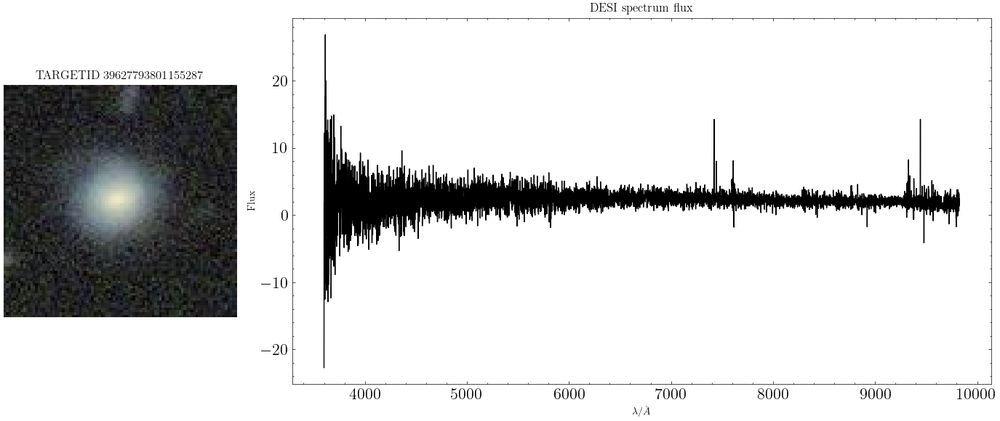

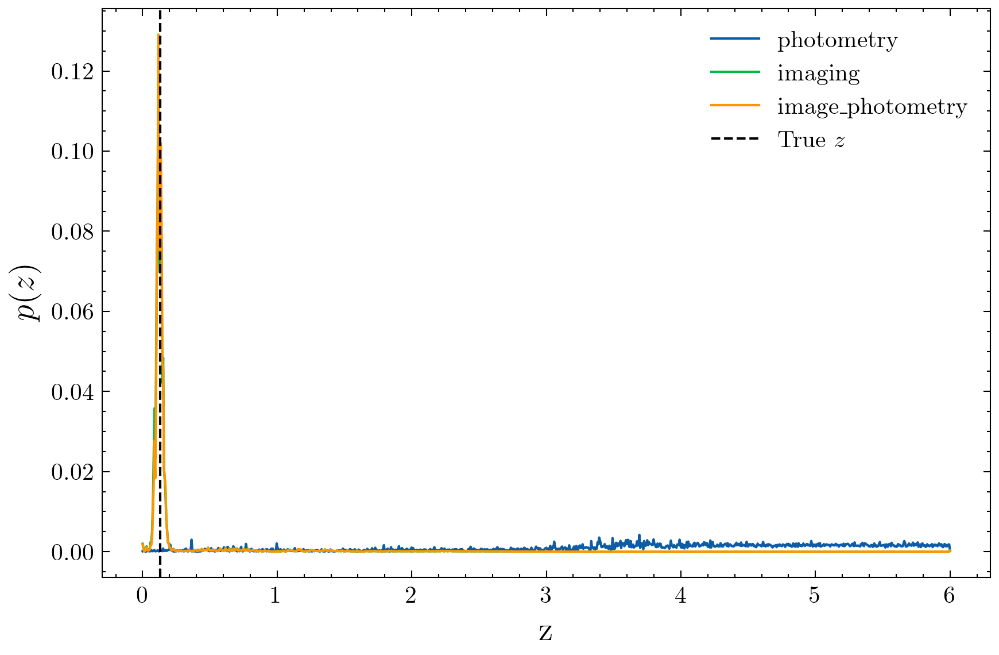

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627787790714758,-18.129433,10.424988746643066,0.02270043,0.11703649


Z                                     25.814716
Photometry                           712.922363
Imaging                               25.425671
Spectroscopy                           0.000000
Image + Photometry                    20.623560
Image + Spectrum                       0.032929
Image + Spectrum + Photometry          0.053774
Image + Spectrum + Photometry + Z      0.022918
ratio_p_ip                            34.568348
ratio_p_ip_rank                       22.000000
Name: 473, dtype: float64

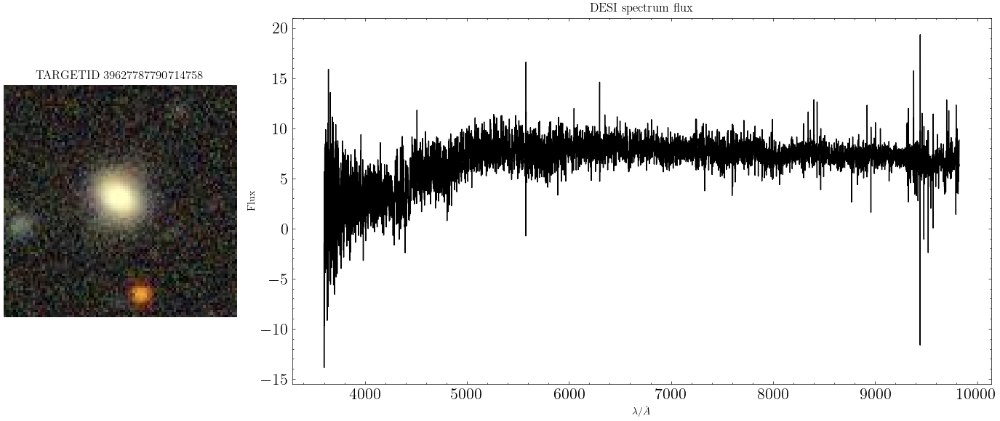

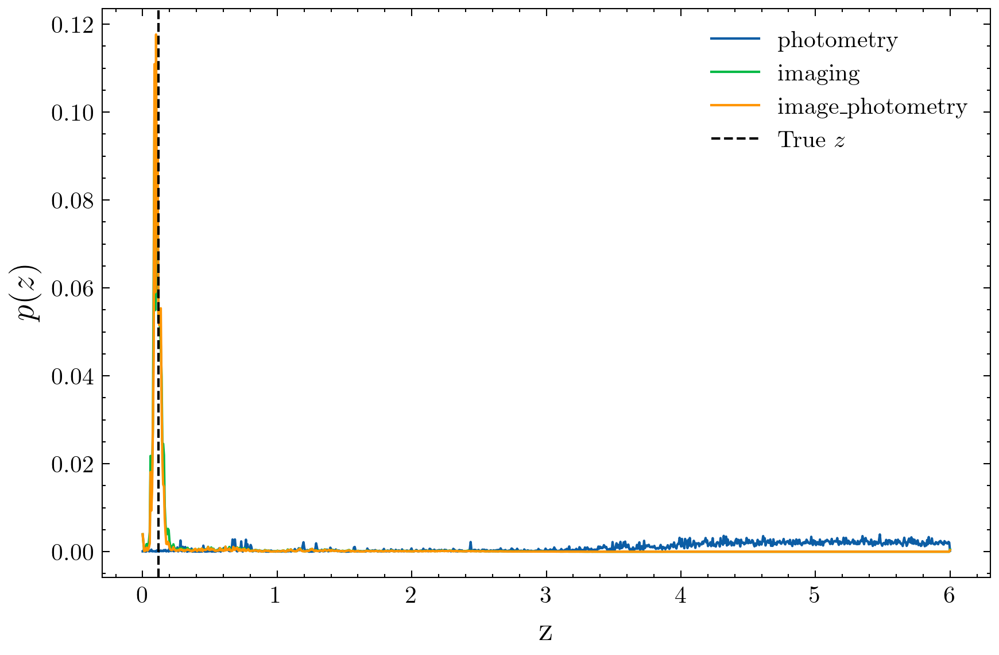

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799866115784,-12.835612,10.586678504943848,0.027774077,0.12158244


Z                                     19.050274
Photometry                           710.644470
Imaging                               29.264477
Spectroscopy                           0.000000
Image + Photometry                    20.850912
Image + Spectrum                       0.032314
Image + Spectrum + Photometry          0.039988
Image + Spectrum + Photometry + Z      0.023898
ratio_p_ip                            34.082176
ratio_p_ip_rank                       23.000000
Name: 1408, dtype: float64

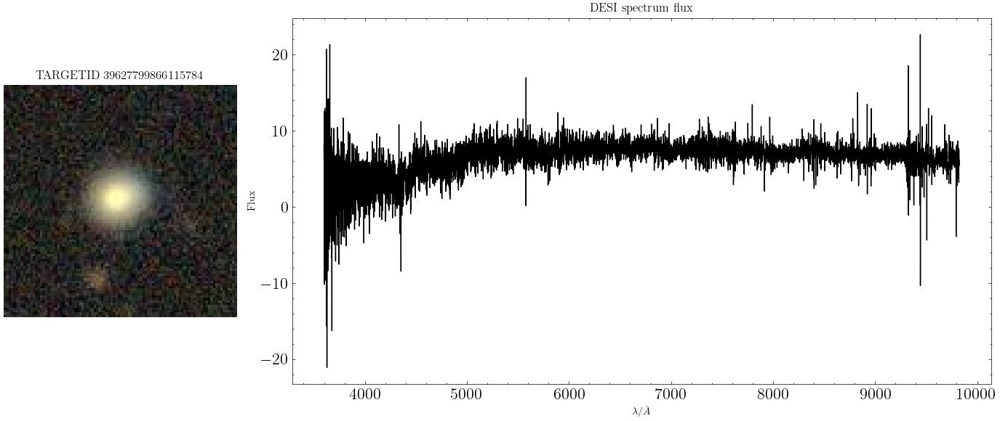

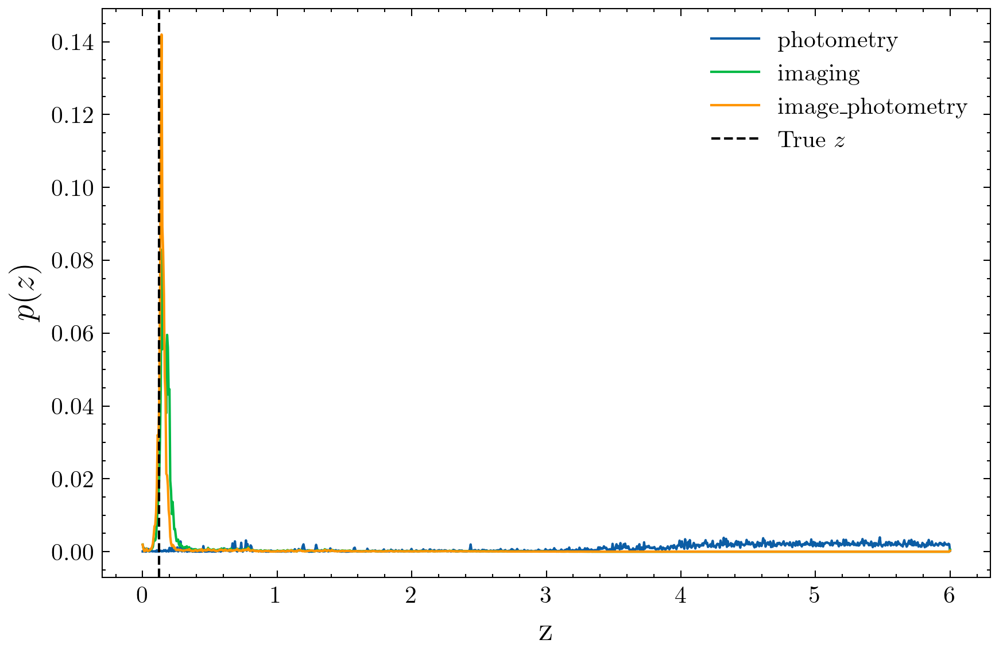

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627824033697825,-10.183842,10.731083869934082,0.025205128,0.13236153


Z                                     20.075821
Photometry                           621.992615
Imaging                               18.794699
Spectroscopy                           0.000000
Image + Photometry                    18.308258
Image + Spectrum                       0.005859
Image + Spectrum + Photometry          0.001827
Image + Spectrum + Photometry + Z      0.029912
ratio_p_ip                            33.973335
ratio_p_ip_rank                       24.000000
Name: 2889, dtype: float64

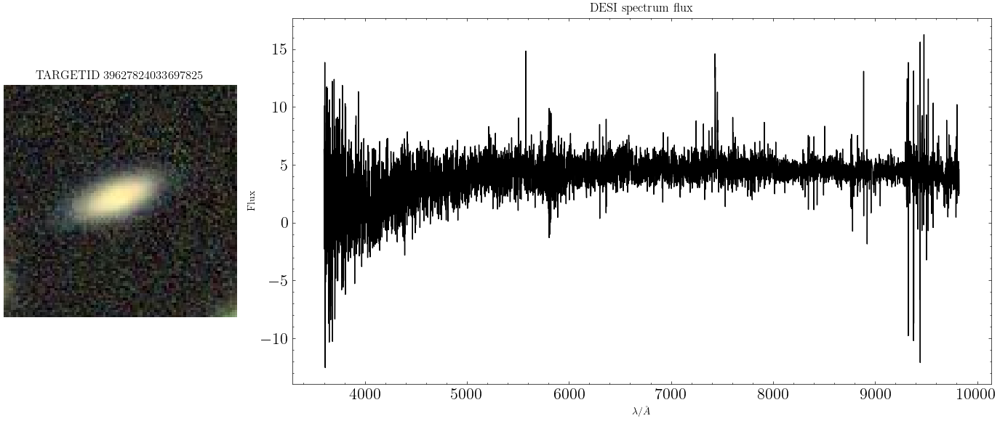

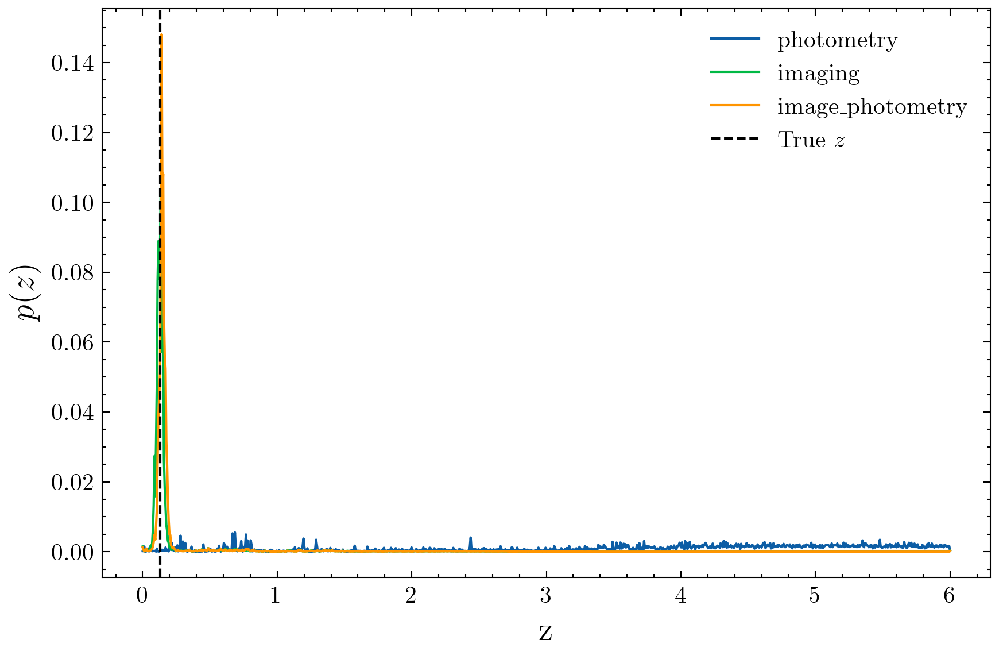

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799870309117,-12.72844,8.545968055725098,0.028429195,0.019916503


Z                                     23.881388
Photometry                           274.367920
Imaging                                9.442443
Spectroscopy                           0.000000
Image + Photometry                     8.106770
Image + Spectrum                       4.950231
Image + Spectrum + Photometry          5.895924
Image + Spectrum + Photometry + Z      6.714356
ratio_p_ip                            33.844296
ratio_p_ip_rank                       25.000000
Name: 1462, dtype: float64

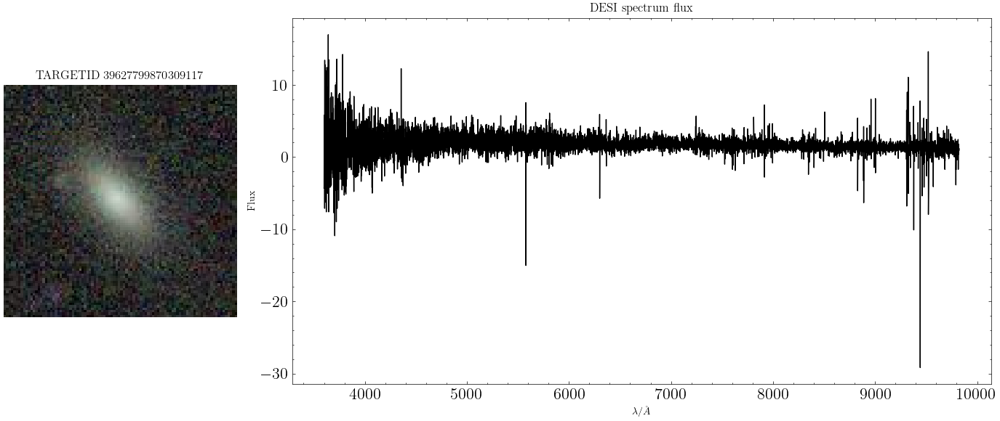

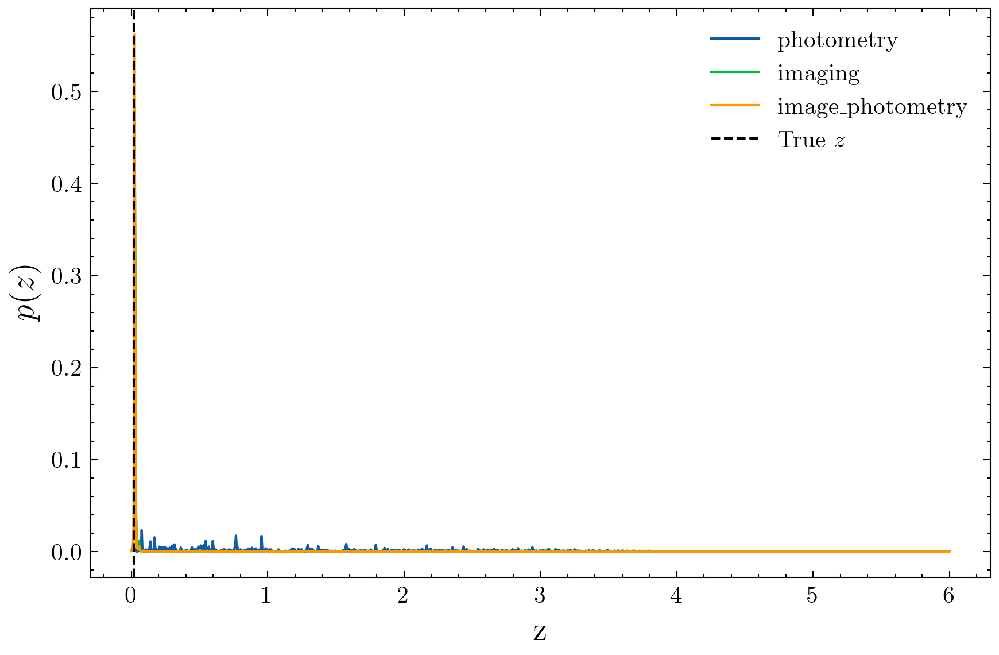

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799853536087,-9.964534,10.334444046020508,0.025387898,0.117455155


Z                                     19.016047
Photometry                           646.506470
Imaging                               20.533602
Spectroscopy                           0.000000
Image + Photometry                    19.137386
Image + Spectrum                       0.040769
Image + Spectrum + Photometry          0.048279
Image + Spectrum + Photometry + Z      0.036618
ratio_p_ip                            33.782379
ratio_p_ip_rank                       26.000000
Name: 1317, dtype: float64

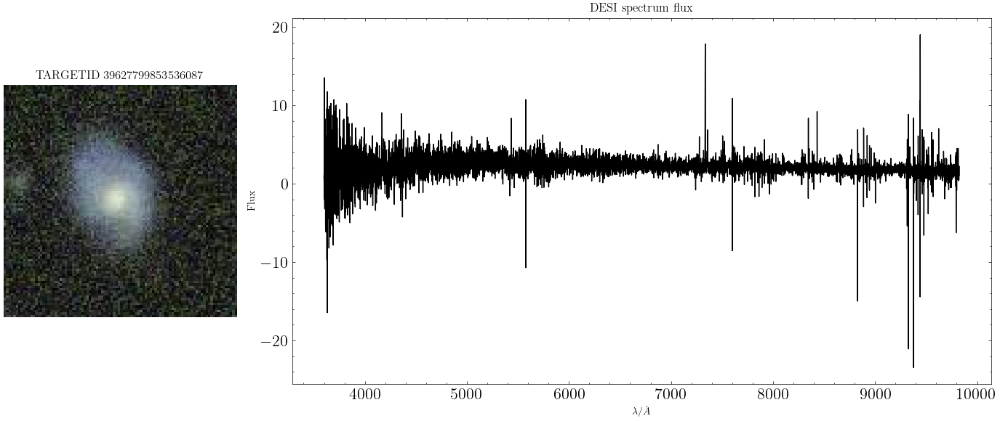

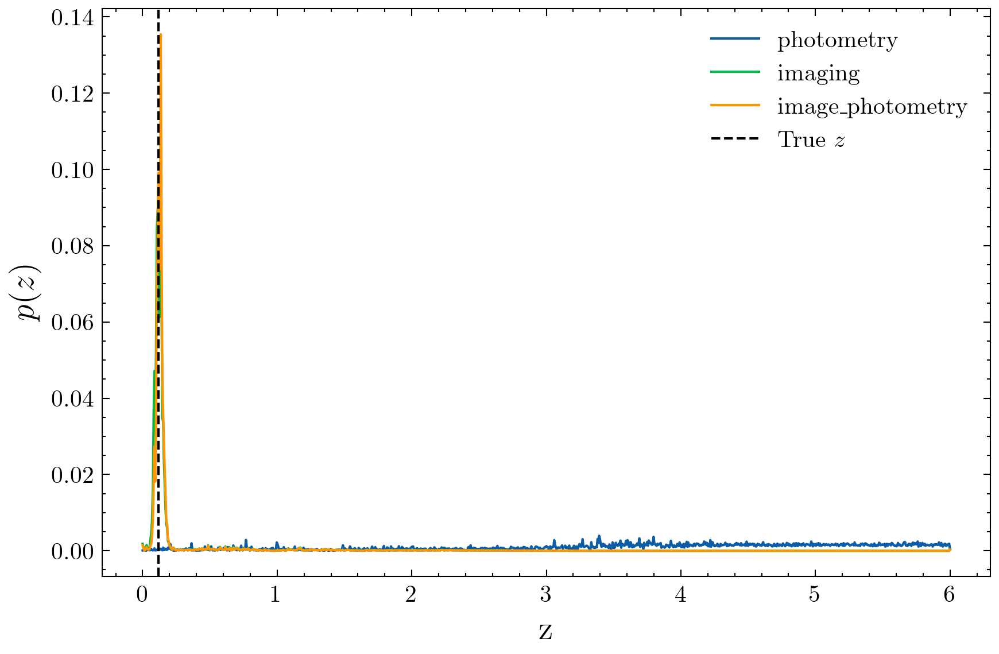

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627745516323660,-12.43341,10.574719429016113,0.019742023,0.11088043


Z                                     27.072229
Photometry                           671.600952
Imaging                               21.064468
Spectroscopy                           0.000000
Image + Photometry                    19.904799
Image + Spectrum                       0.052688
Image + Spectrum + Photometry          0.045456
Image + Spectrum + Photometry + Z      0.041355
ratio_p_ip                            33.740654
ratio_p_ip_rank                       27.000000
Name: 1, dtype: float64

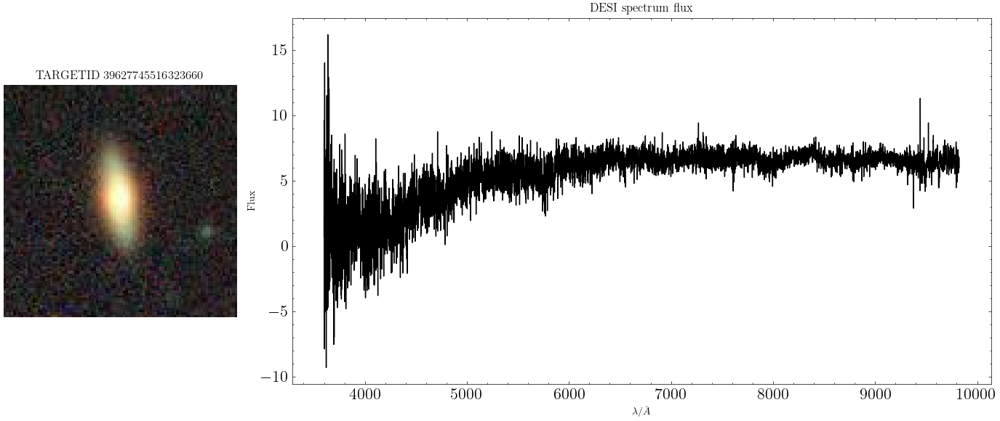

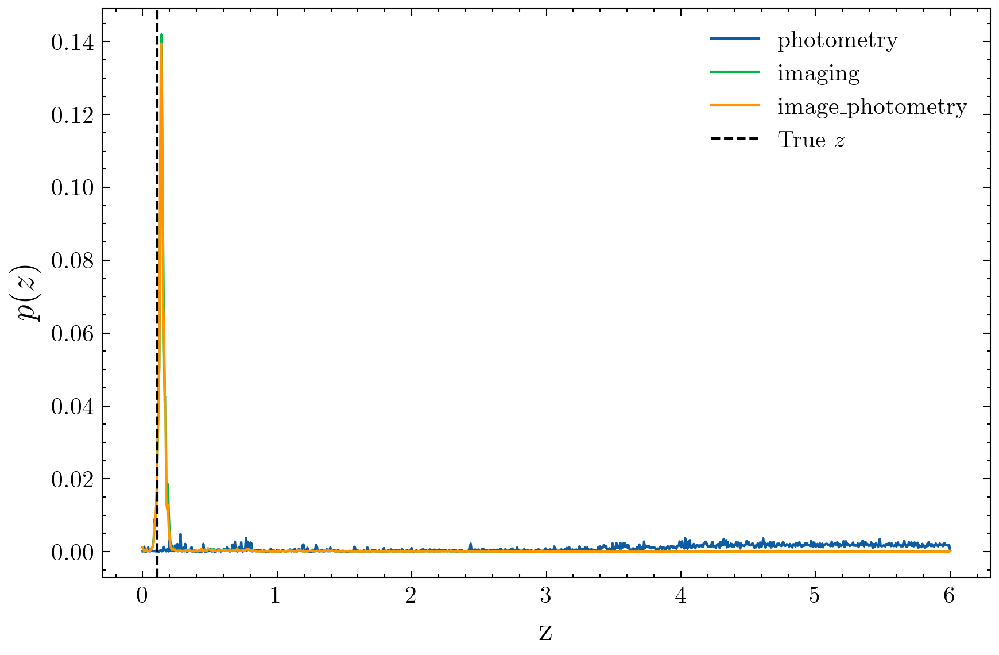

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799870310414,-11.827604,11.071928024291992,0.028510418,0.17117499


Z                                     12.703907
Photometry                           524.862915
Imaging                               19.369619
Spectroscopy                           0.000000
Image + Photometry                    16.015949
Image + Spectrum                       0.007473
Image + Spectrum + Photometry          0.011121
Image + Spectrum + Photometry + Z      0.014044
ratio_p_ip                            32.771263
ratio_p_ip_rank                       28.000000
Name: 1475, dtype: float64

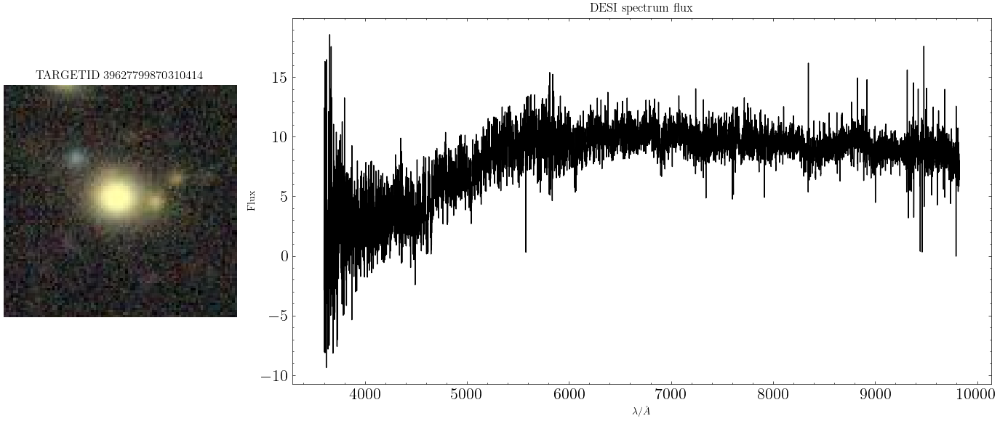

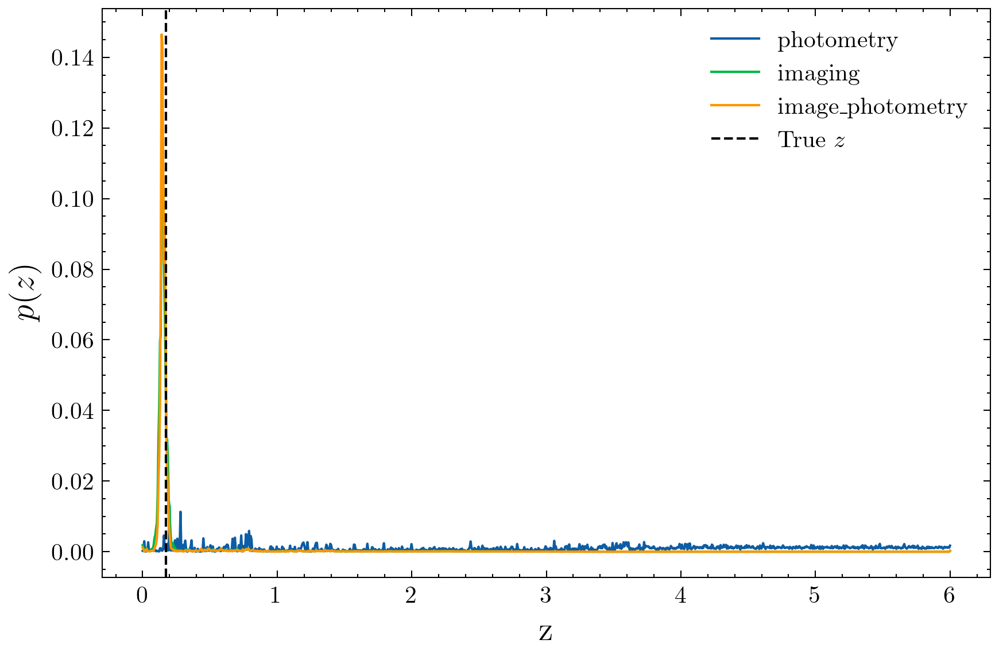

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799870314105,-10.906204,10.263575553894043,0.025581647,0.13058485


Z                                     20.078541
Photometry                           673.752930
Imaging                               28.283672
Spectroscopy                           0.000000
Image + Photometry                    20.685535
Image + Spectrum                       0.016467
Image + Spectrum + Photometry          0.014131
Image + Spectrum + Photometry + Z      0.025433
ratio_p_ip                            32.571209
ratio_p_ip_rank                       29.000000
Name: 1505, dtype: float64

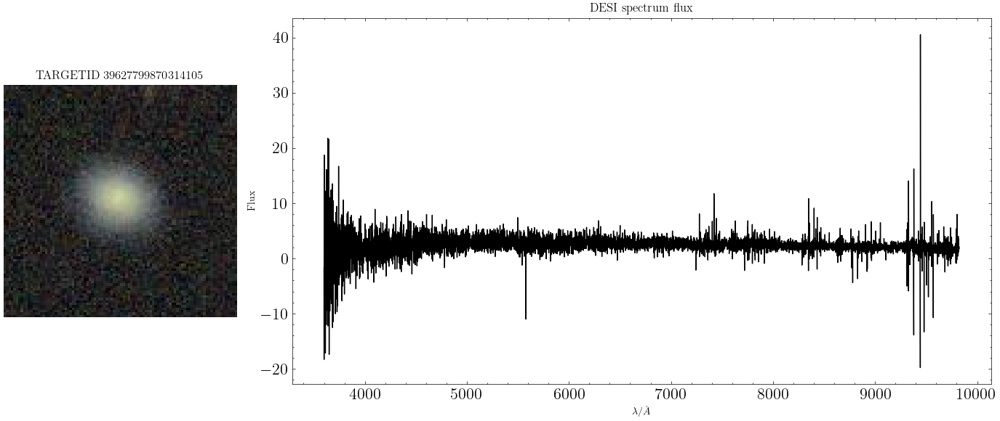

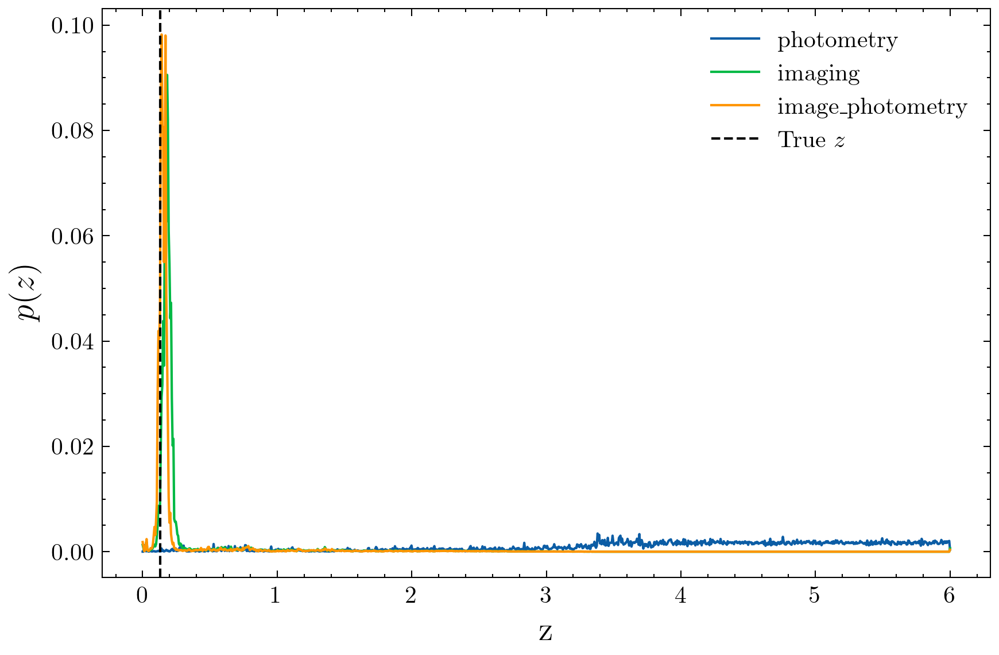

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627787794912047,-13.823613,11.040273666381836,0.024534259,0.18338463


Z                                     39.488163
Photometry                           551.882996
Imaging                               20.560673
Spectroscopy                           0.000000
Image + Photometry                    16.949970
Image + Spectrum                       0.044470
Image + Spectrum + Photometry          0.053772
Image + Spectrum + Photometry + Z      0.044738
ratio_p_ip                            32.559525
ratio_p_ip_rank                       30.000000
Name: 574, dtype: float64

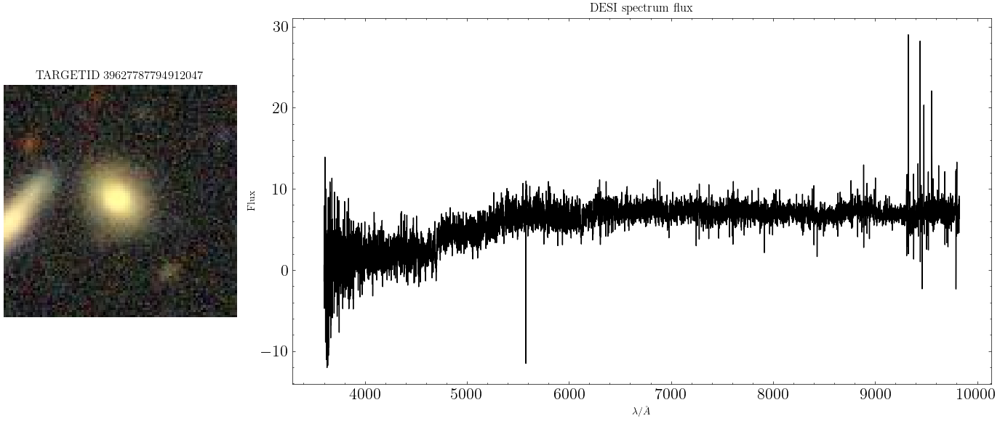

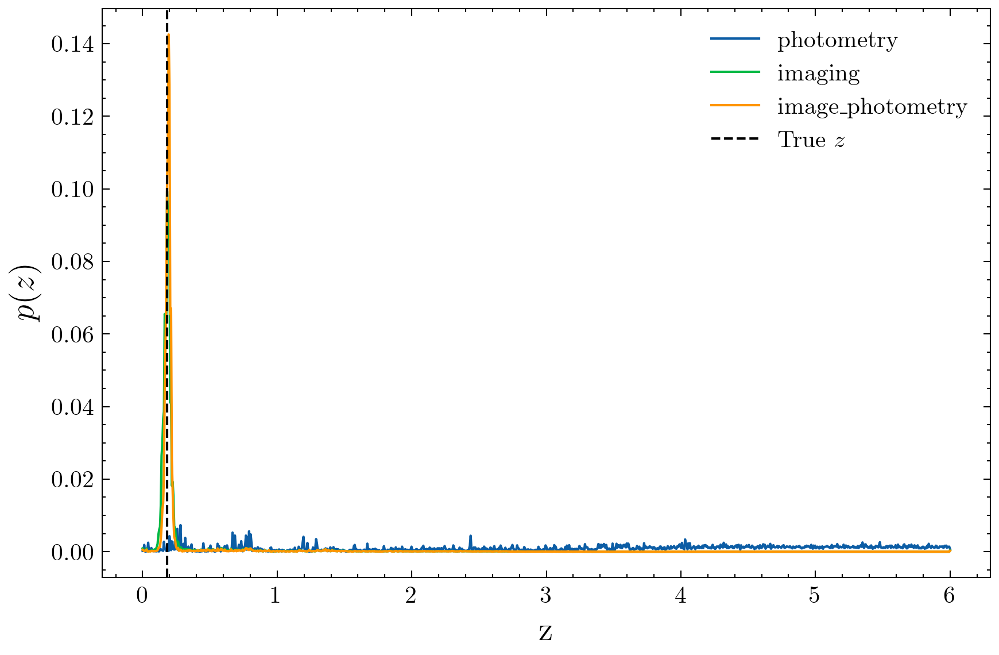

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763627332807,-11.891513,9.763641357421875,0.020494394,0.059918877


Z                                     28.029451
Photometry                           620.733582
Imaging                               21.241087
Spectroscopy                           0.000000
Image + Photometry                    19.305387
Image + Spectrum                       0.808267
Image + Spectrum + Photometry          0.997239
Image + Spectrum + Photometry + Z      0.219463
ratio_p_ip                            32.153385
ratio_p_ip_rank                       31.000000
Name: 3083, dtype: float64

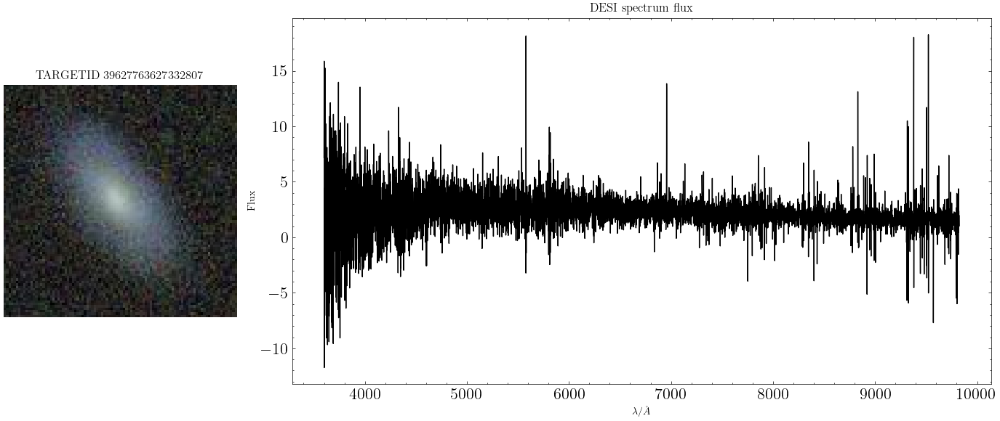

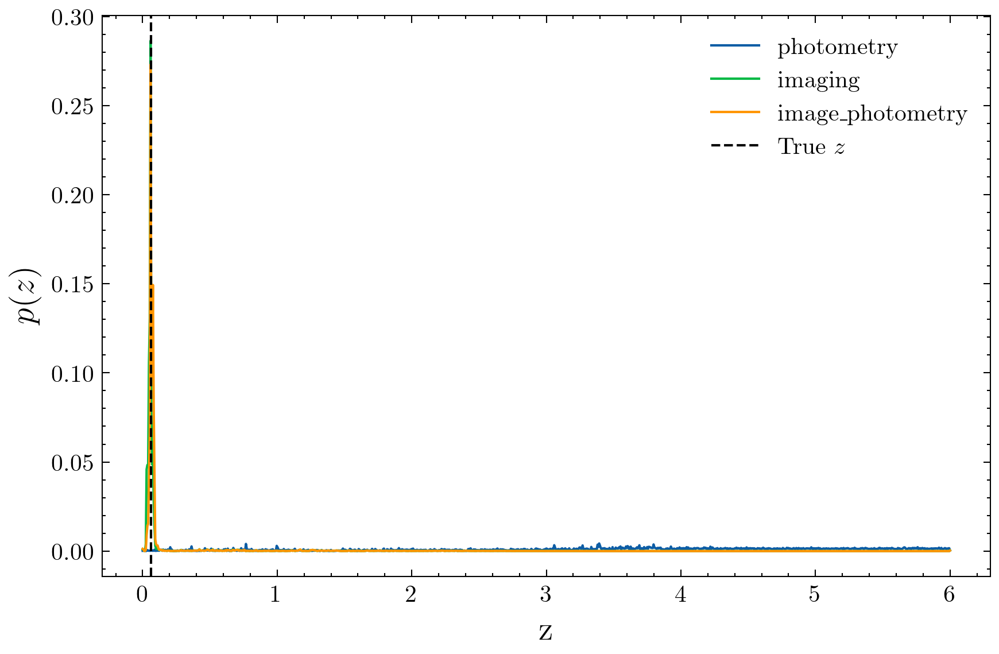

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793834707611,-9.569365,10.541457176208496,0.02621888,0.12661529


Z                                     19.166418
Photometry                           624.292297
Imaging                               19.868694
Spectroscopy                           0.000000
Image + Photometry                    19.575510
Image + Spectrum                       0.113929
Image + Spectrum + Photometry          0.119288
Image + Spectrum + Photometry + Z      0.111356
ratio_p_ip                            31.891497
ratio_p_ip_rank                       32.000000
Name: 1039, dtype: float64

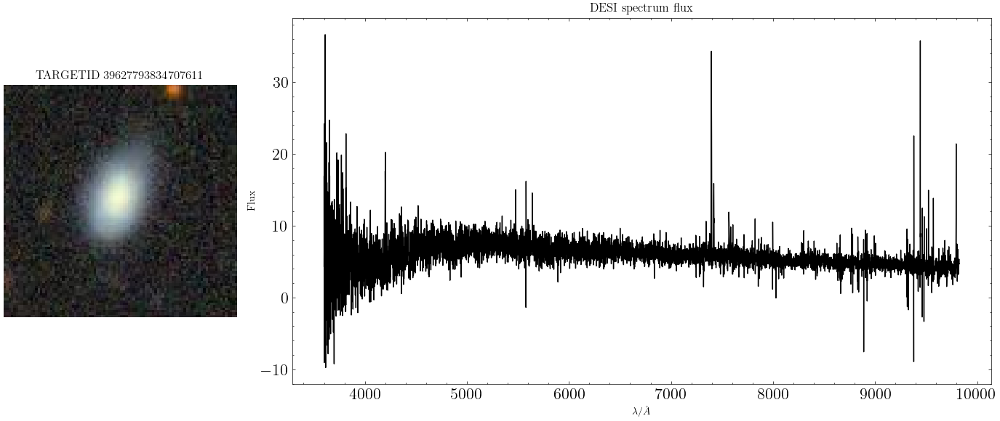

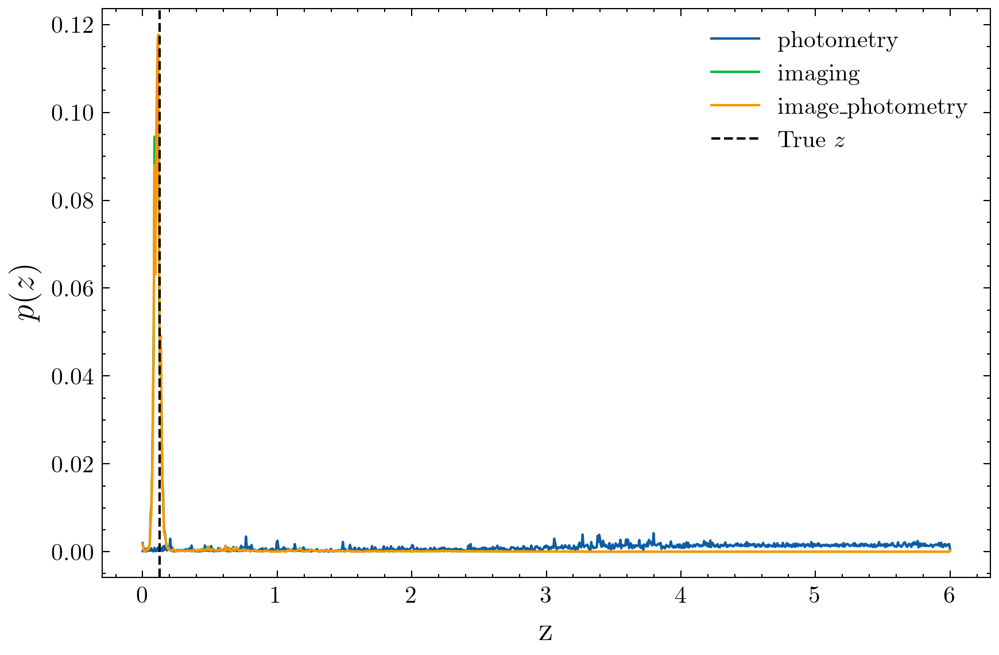

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805910109510,-14.596017,10.58259105682373,0.02710102,0.12343581


Z                                     18.983088
Photometry                           553.549988
Imaging                               23.069963
Spectroscopy                           0.000000
Image + Photometry                    17.385773
Image + Spectrum                       0.273675
Image + Spectrum + Photometry          0.298319
Image + Spectrum + Photometry + Z      0.273031
ratio_p_ip                            31.839251
ratio_p_ip_rank                       33.000000
Name: 1893, dtype: float64

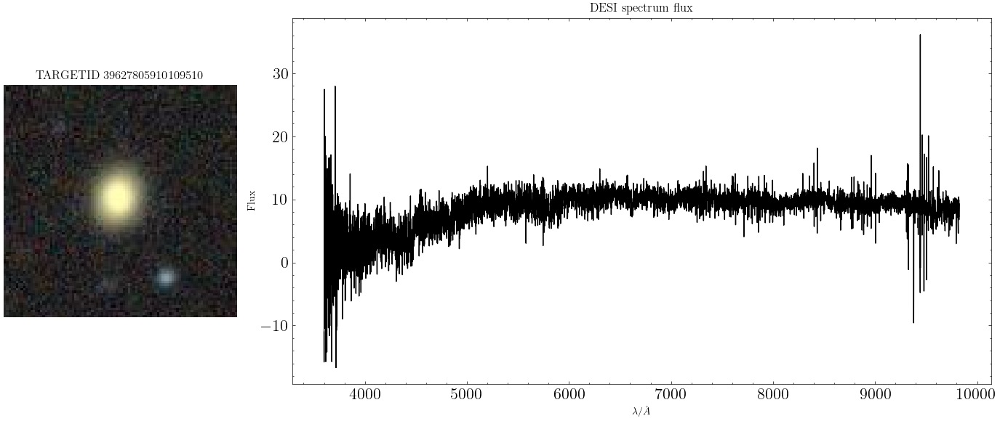

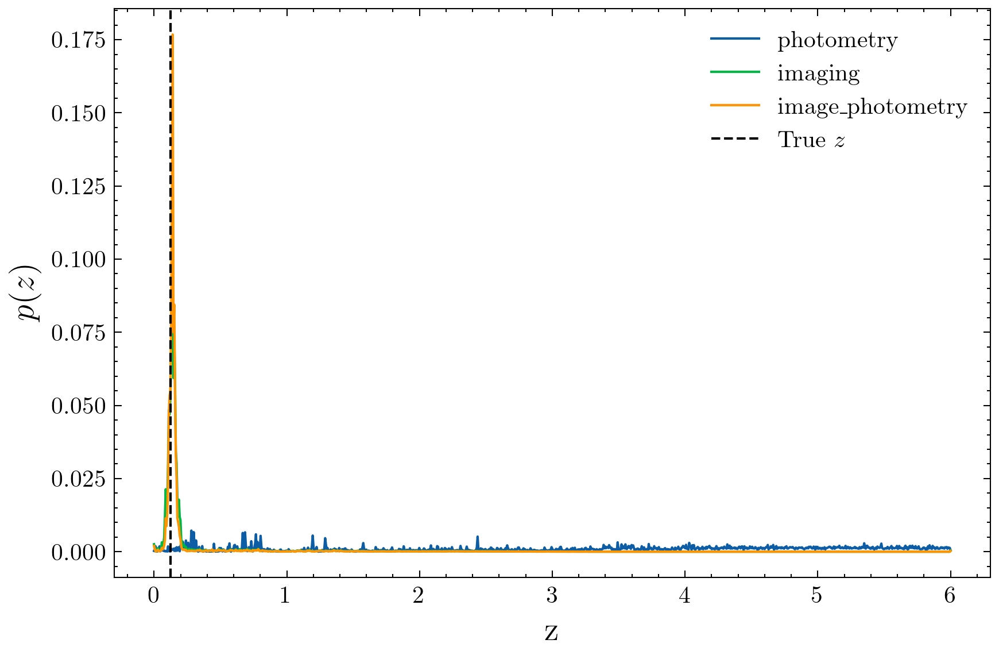

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763648300531,-10.019158,10.344186782836914,0.0217791,0.10045972


Z                                     19.588602
Photometry                           652.757996
Imaging                               21.786509
Spectroscopy                           0.000000
Image + Photometry                    20.636921
Image + Spectrum                       0.029573
Image + Spectrum + Photometry          0.039053
Image + Spectrum + Photometry + Z      0.034956
ratio_p_ip                            31.630590
ratio_p_ip_rank                       34.000000
Name: 3347, dtype: float64

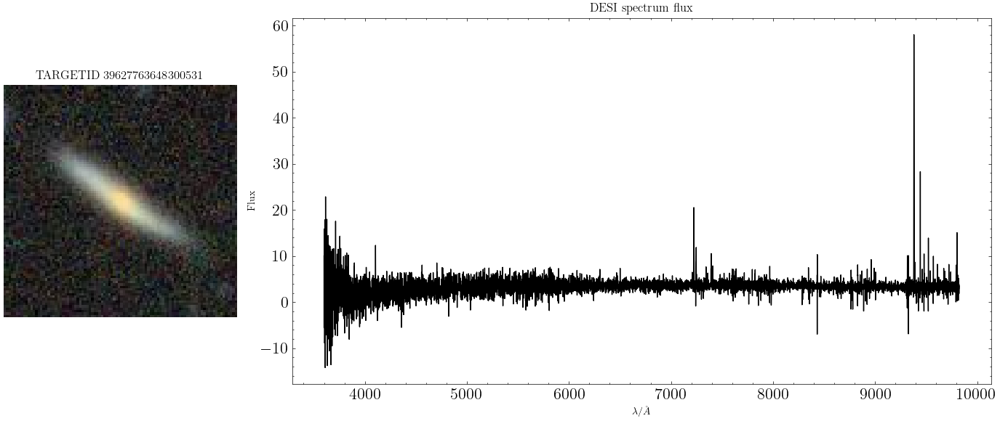

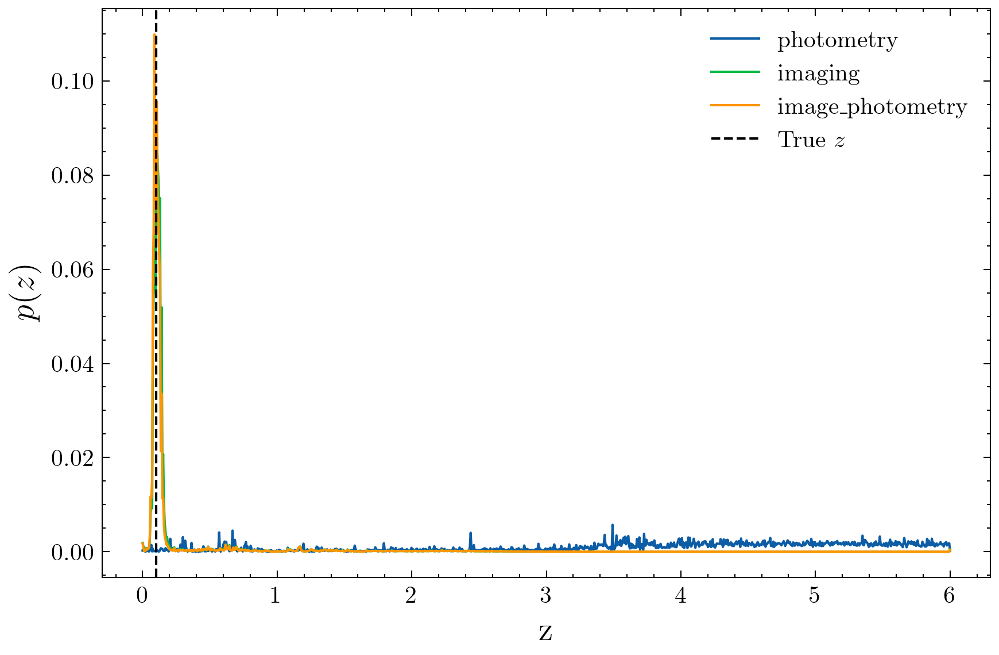

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799840948624,-10.5967,10.93484878540039,0.023506874,0.16577254


Z                                     10.588439
Photometry                           684.571777
Imaging                               23.816837
Spectroscopy                           0.000000
Image + Photometry                    21.719772
Image + Spectrum                       0.010081
Image + Spectrum + Photometry          0.011302
Image + Spectrum + Photometry + Z      0.003336
ratio_p_ip                            31.518368
ratio_p_ip_rank                       35.000000
Name: 1182, dtype: float64

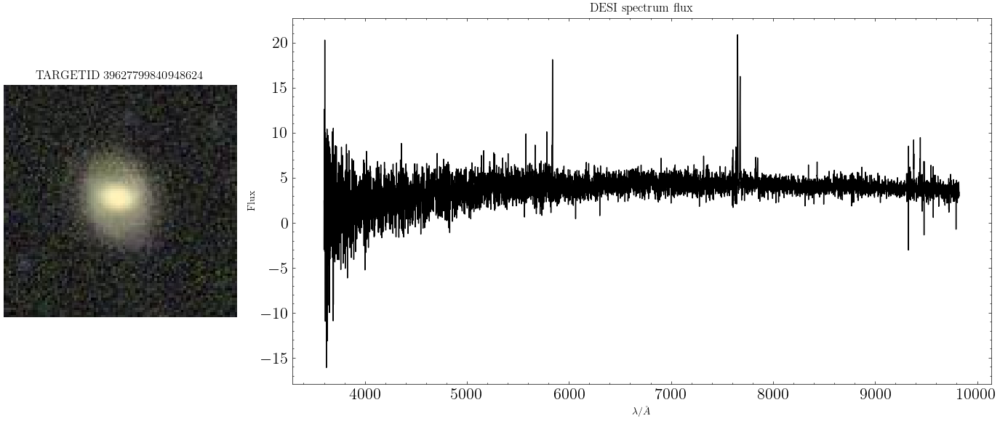

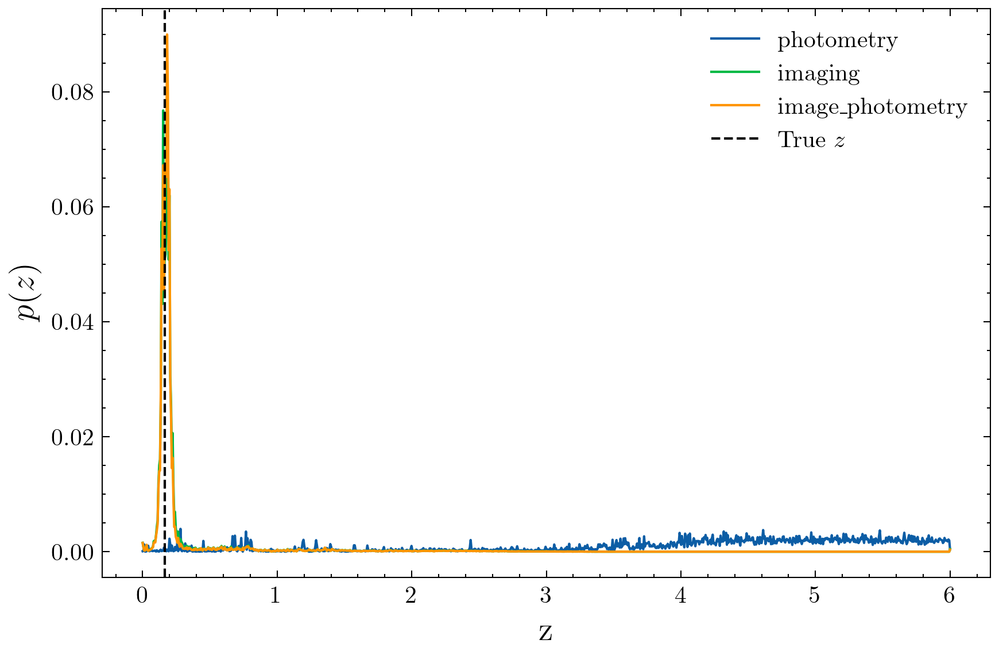

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627757579146073,-13.783418,11.004024505615234,0.021732058,0.18006633


Z                                     22.199930
Photometry                           591.278198
Imaging                               31.057322
Spectroscopy                           0.000000
Image + Photometry                    18.777851
Image + Spectrum                       0.003775
Image + Spectrum + Photometry          0.006285
Image + Spectrum + Photometry + Z      0.006194
ratio_p_ip                            31.488066
ratio_p_ip_rank                       36.000000
Name: 1650, dtype: float64

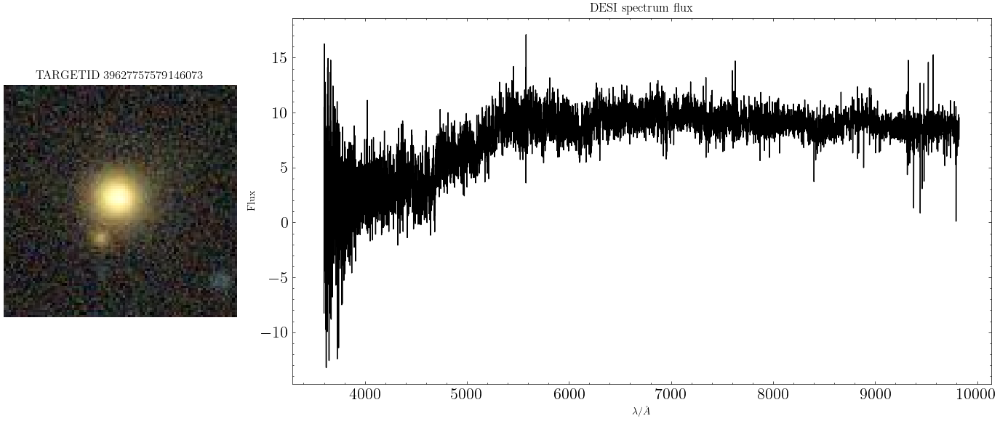

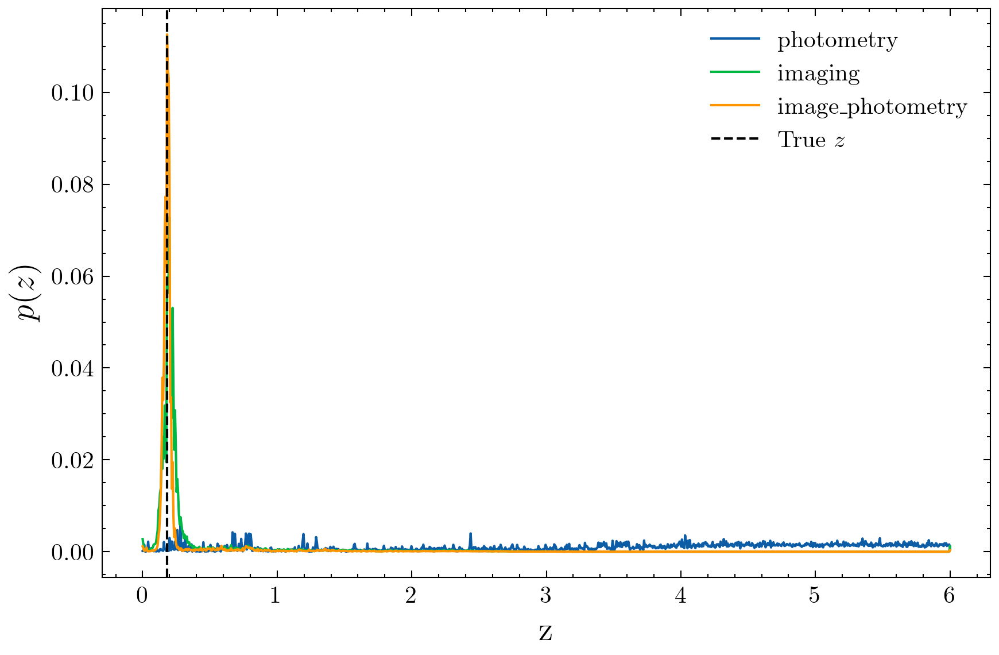

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811949907112,-10.992169,10.084025382995605,0.027940487,0.07735763


Z                                      9.182676
Photometry                           657.057678
Imaging                               21.452368
Spectroscopy                           0.000000
Image + Photometry                    21.024416
Image + Spectrum                       0.003286
Image + Spectrum + Photometry          0.002415
Image + Spectrum + Photometry + Z      0.028002
ratio_p_ip                            31.252125
ratio_p_ip_rank                       37.000000
Name: 2175, dtype: float64

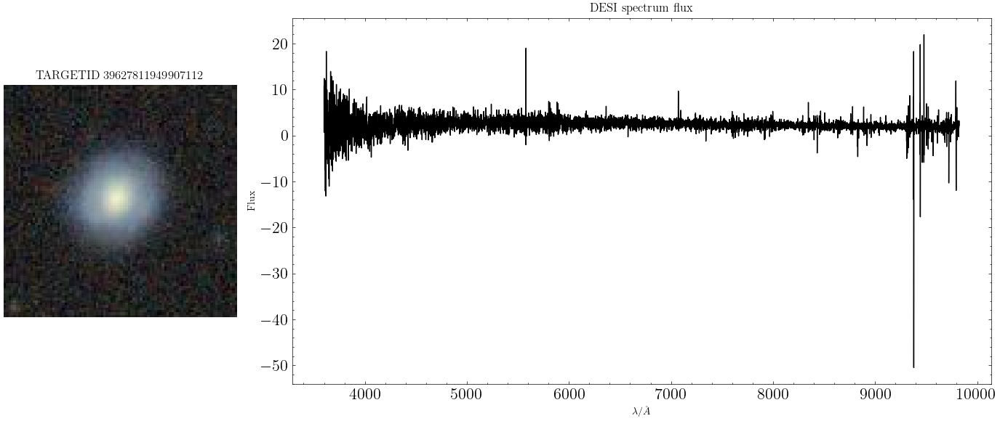

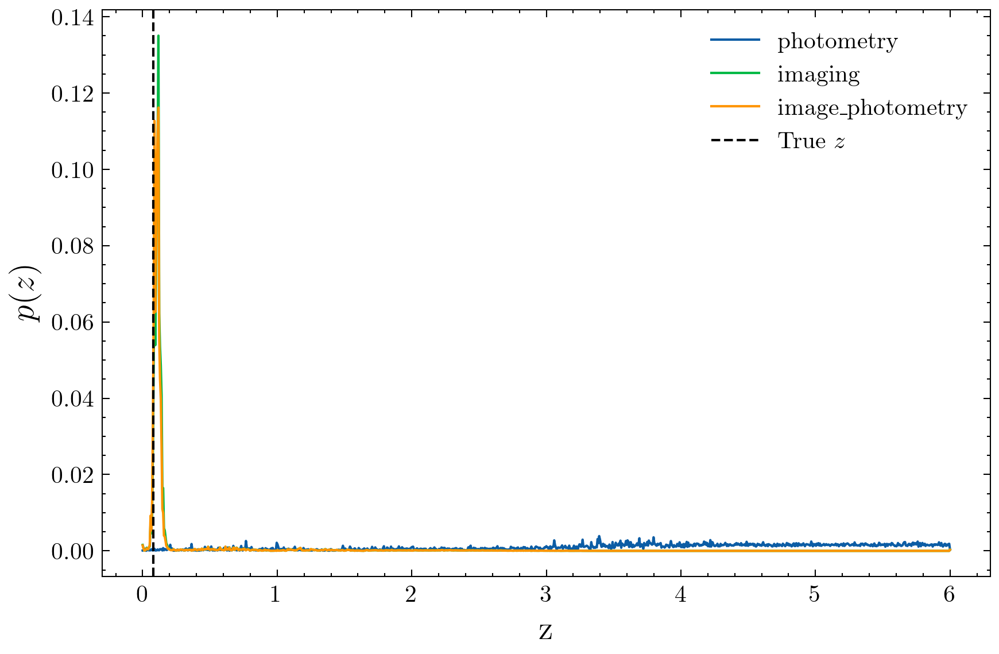

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627757612700301,-10.3131075,10.080437660217285,0.022072531,0.08529387


Z                                     14.363862
Photometry                           641.442261
Imaging                               19.591574
Spectroscopy                           0.000000
Image + Photometry                    20.598532
Image + Spectrum                       0.067212
Image + Spectrum + Photometry          0.070168
Image + Spectrum + Photometry + Z      0.069701
ratio_p_ip                            31.140194
ratio_p_ip_rank                       38.000000
Name: 2927, dtype: float64

KeyboardInterrupt: 

In [43]:
plot_z_dist(
    check_df,
    table_sorted,
    names,
    tok_z_p,
    ascending=False 
)

Photometry to image ratios

In [51]:
df["ratio_p_i"] = (df["Photometry"])/(df["Imaging"])

In [54]:
threshold = 1.1 # threshold at -10

#print(df.loc[(df["ratio_p_ip"] < threshold) == True])

# 2) Filter rows
mask = df["ratio_p_i"] <= threshold
check_df = df.loc[mask].copy()

# 3a) Option A: add a rank column (1 = highest diff)
check_df["ratio_p_i_rank"] = check_df["ratio_p_i"].rank(ascending=False, method="dense")

# 3b) Option B: sort by the difference
check_df = check_df.sort_values("ratio_p_i", ascending=False)

Lowest photometry to image ratios (Poor images)

TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799866114423,-7.558687,11.213979721069336,0.027271666,0.501469


Z                                    33.376568
Photometry                           10.027557
Imaging                              24.499979
Spectroscopy                          0.000000
Image + Photometry                   23.094481
Image + Spectrum                     16.220484
Image + Spectrum + Photometry        11.776525
Image + Spectrum + Photometry + Z    38.730301
ratio_p_ip                            0.434197
ratio_p_i                             0.409288
ratio_p_i_rank                       19.000000
Name: 1394, dtype: float64

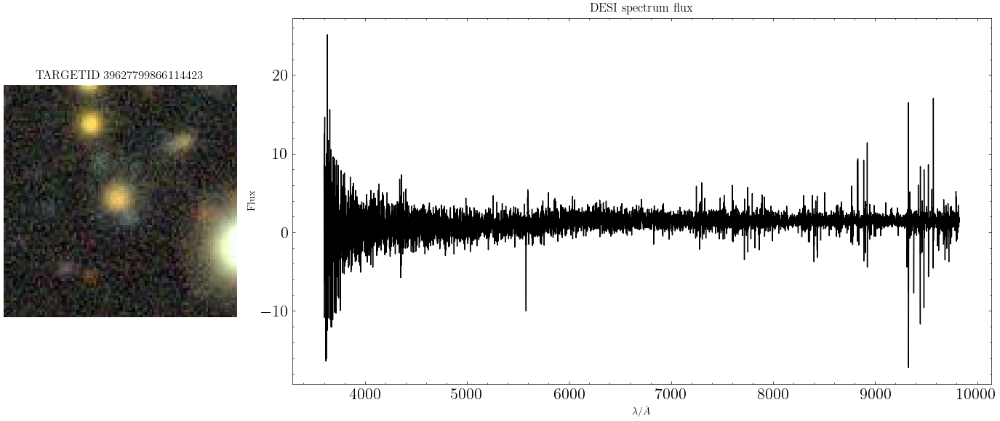

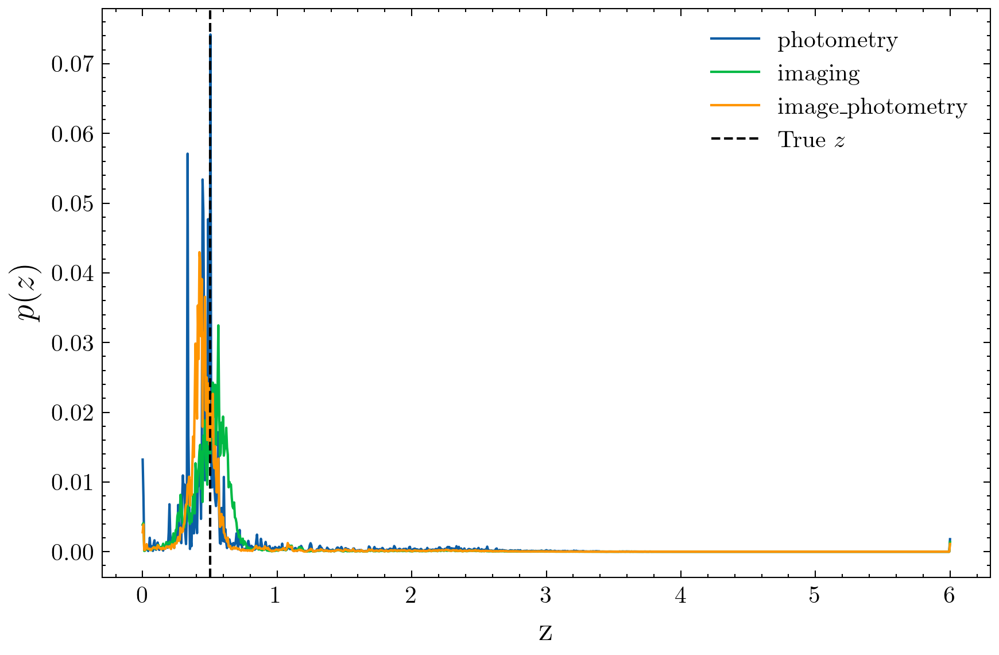

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627818002287849,-20.206602,12.02027702331543,0.033067755,0.48387292


Z                                     5.433448
Photometry                           45.868015
Imaging                              53.020500
Spectroscopy                          0.000000
Image + Photometry                   46.677753
Image + Spectrum                      0.008115
Image + Spectrum + Photometry         0.004697
Image + Spectrum + Photometry + Z     0.016730
ratio_p_ip                            0.982653
ratio_p_i                             0.865100
ratio_p_i_rank                       18.000000
Name: 2558, dtype: float64

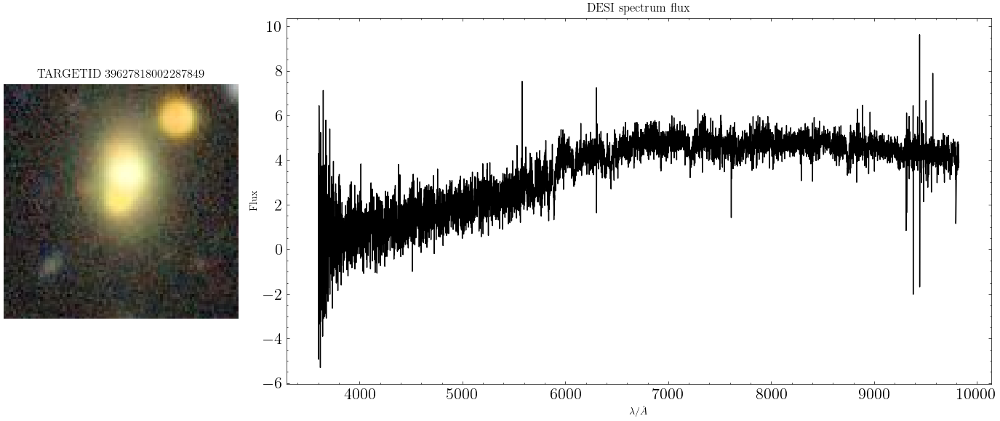

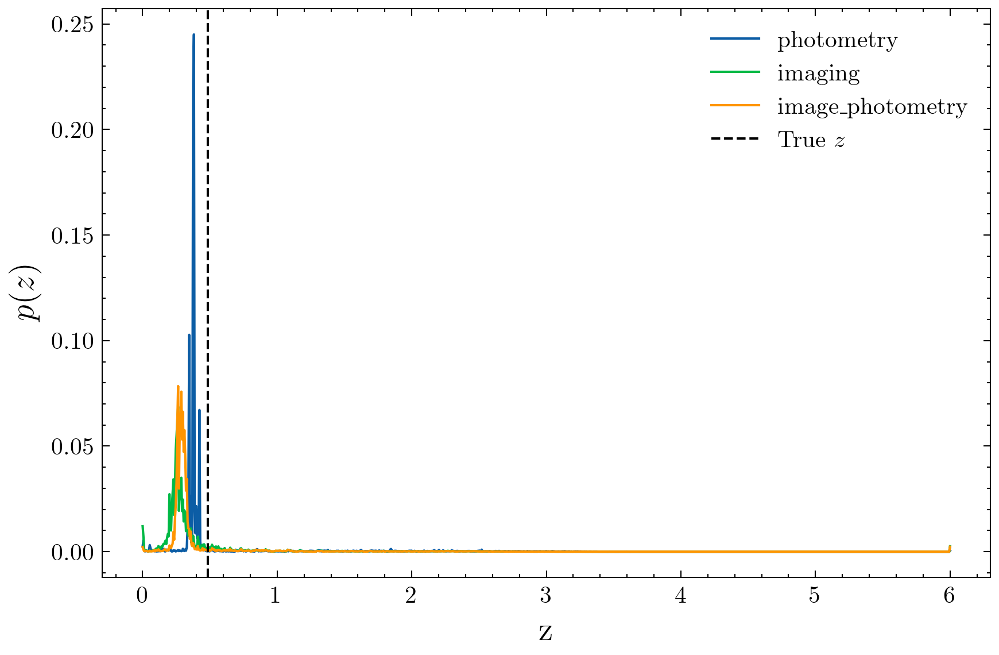

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805910107747,-7.4575334,10.810914993286133,0.028540505,0.49568328


Z                                     5.592305
Photometry                           45.882504
Imaging                              51.556896
Spectroscopy                          0.000000
Image + Photometry                   35.555099
Image + Spectrum                      0.097000
Image + Spectrum + Photometry         0.098959
Image + Spectrum + Photometry + Z     0.083361
ratio_p_ip                            1.290462
ratio_p_i                             0.889939
ratio_p_i_rank                       17.000000
Name: 1870, dtype: float64

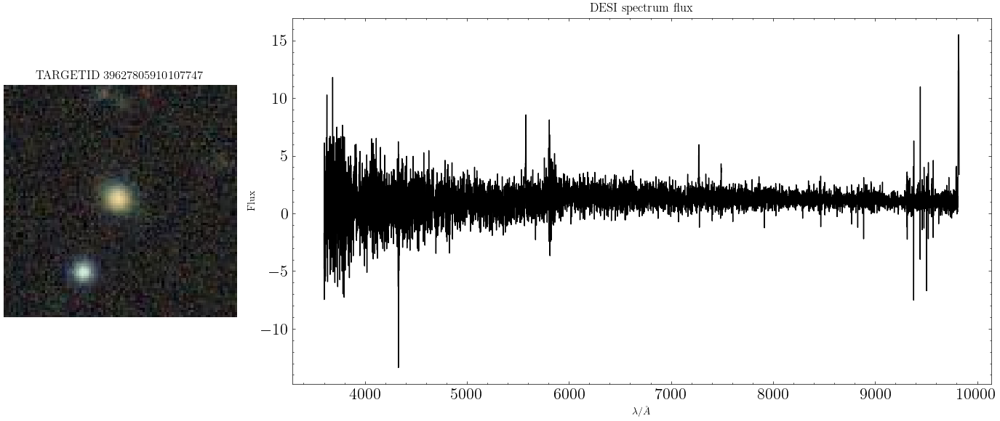

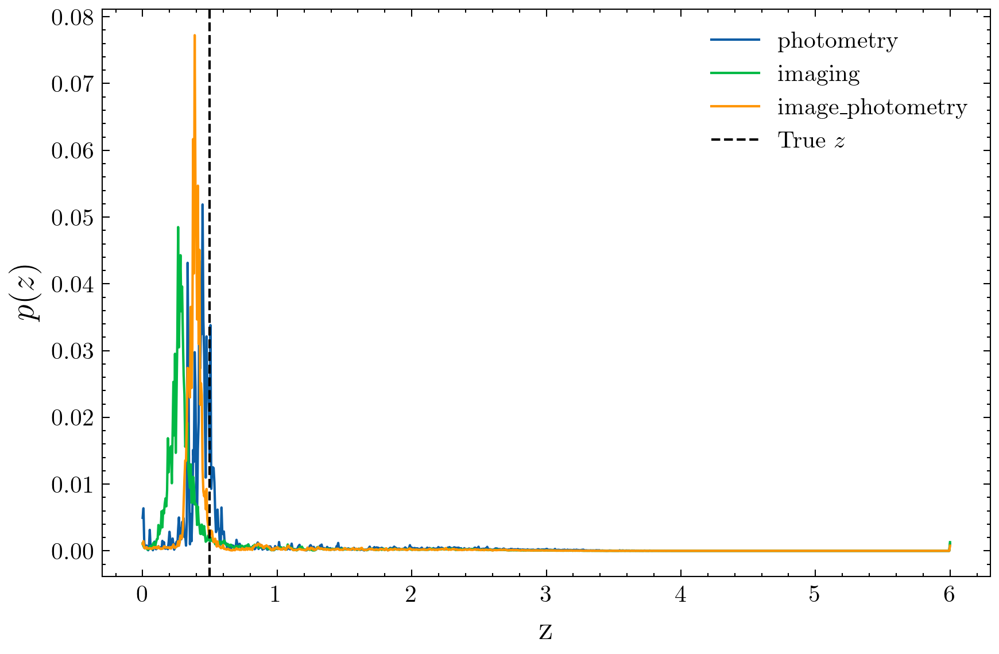

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627817998094652,-7.7626677,11.29737663269043,0.032702252,0.48479834


Z                                     5.308657
Photometry                           45.071201
Imaging                              50.020378
Spectroscopy                          0.000000
Image + Photometry                   31.343950
Image + Spectrum                      0.044814
Image + Spectrum + Photometry         0.057359
Image + Spectrum + Photometry + Z     0.064279
ratio_p_ip                            1.437955
ratio_p_i                             0.901057
ratio_p_i_rank                       16.000000
Name: 2504, dtype: float64

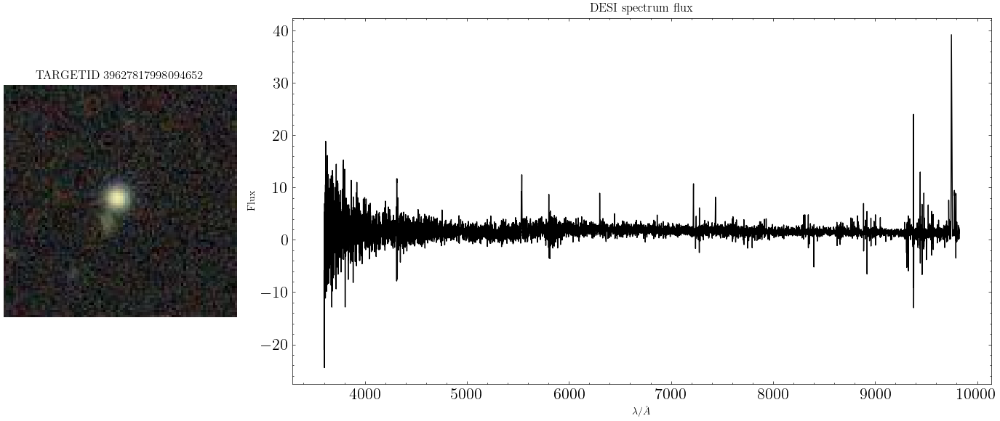

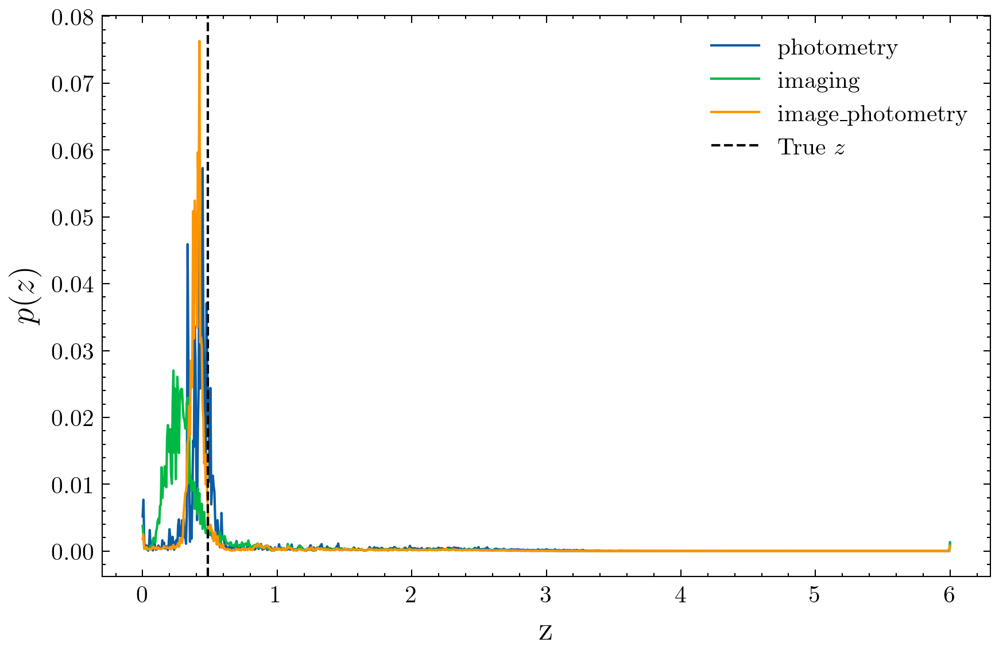

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627751551929976,-15.370854,11.389878273010254,0.020493466,0.50874835


Z                                    607.819580
Photometry                           550.557617
Imaging                              600.528687
Spectroscopy                           0.000000
Image + Photometry                   600.743286
Image + Spectrum                     551.814819
Image + Spectrum + Photometry        560.959473
Image + Spectrum + Photometry + Z    573.903320
ratio_p_ip                             0.916461
ratio_p_i                              0.916788
ratio_p_i_rank                        15.000000
Name: 82, dtype: float64

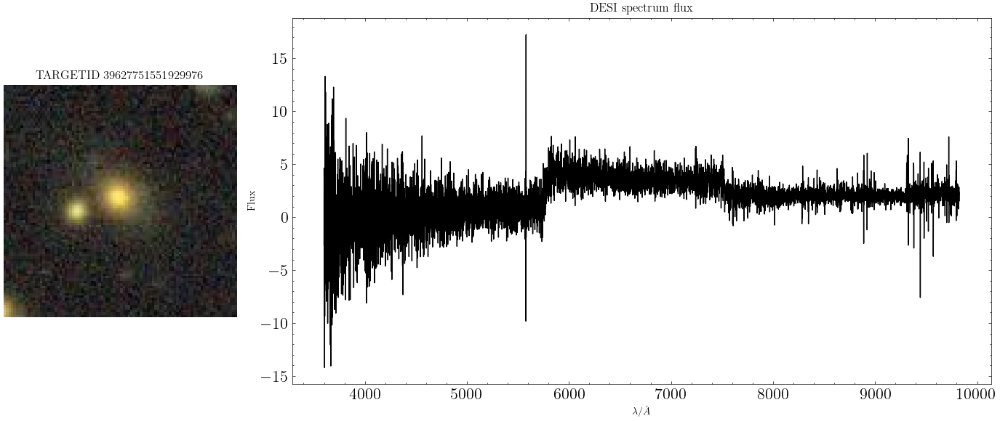

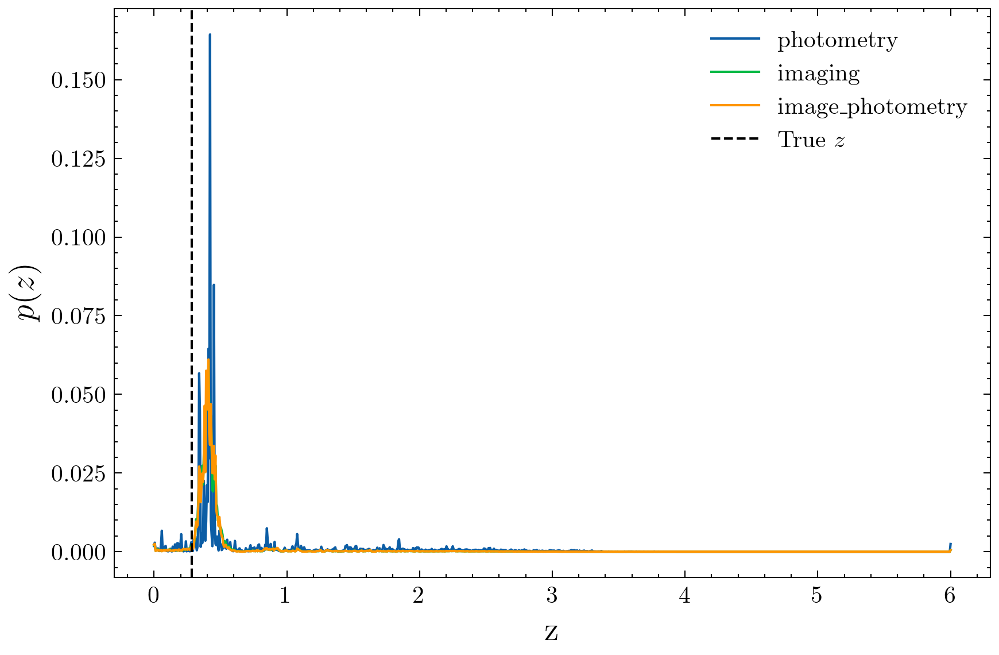

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781721558184,-11.804865,11.213872909545898,0.025004601,0.5126357


Z                                    14.526150
Photometry                           29.137480
Imaging                              30.751564
Spectroscopy                          0.000000
Image + Photometry                   18.528202
Image + Spectrum                      0.007636
Image + Spectrum + Photometry         0.007489
Image + Spectrum + Photometry + Z     0.083476
ratio_p_ip                            1.572602
ratio_p_i                             0.947512
ratio_p_i_rank                       14.000000
Name: 3637, dtype: float64

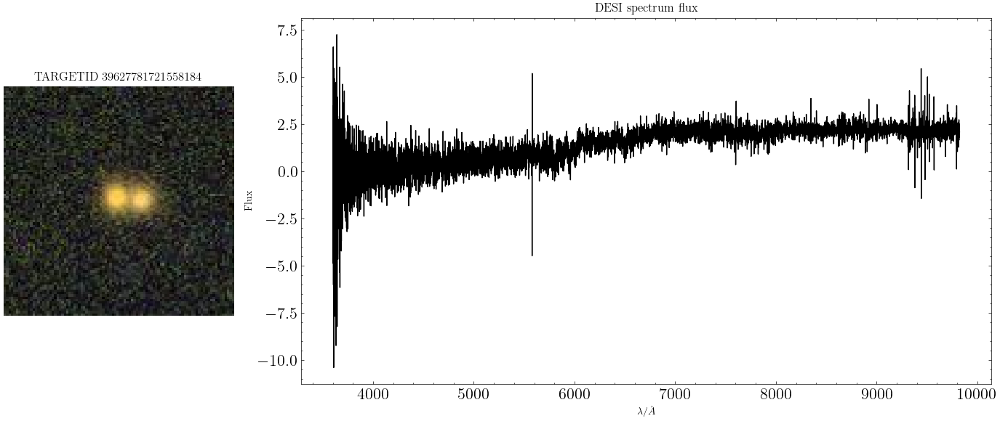

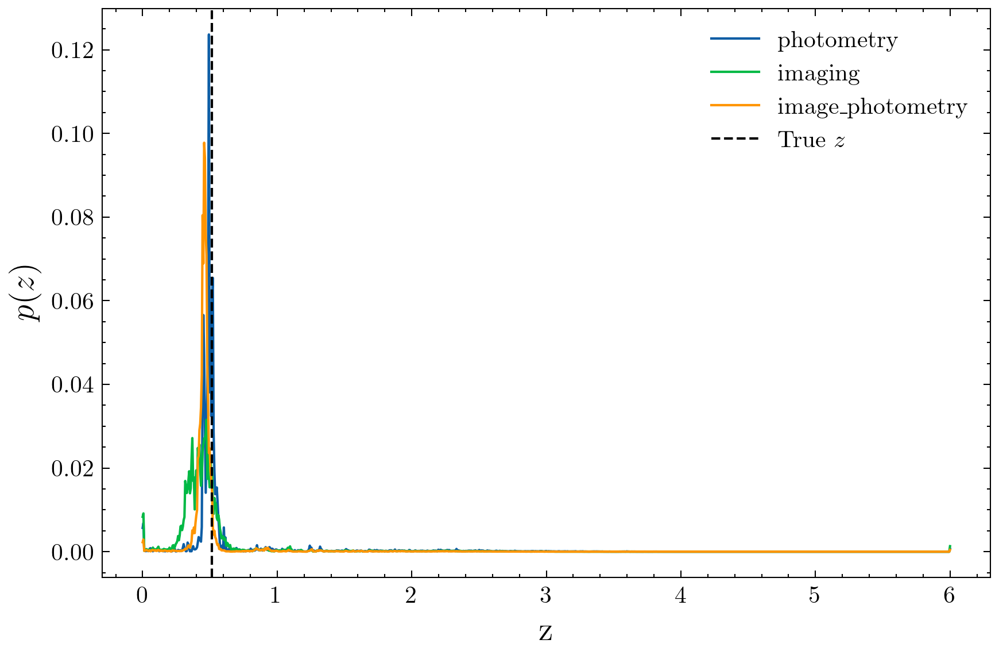

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763635717224,-8.692402,10.650619506835938,0.021271078,0.5548797


Z                                    14.558310
Photometry                           52.211334
Imaging                              54.678722
Spectroscopy                          0.000000
Image + Photometry                   39.711723
Image + Spectrum                      0.013985
Image + Spectrum + Photometry         0.018172
Image + Spectrum + Photometry + Z     0.027397
ratio_p_ip                            1.314759
ratio_p_i                             0.954875
ratio_p_i_rank                       13.000000
Name: 3167, dtype: float64

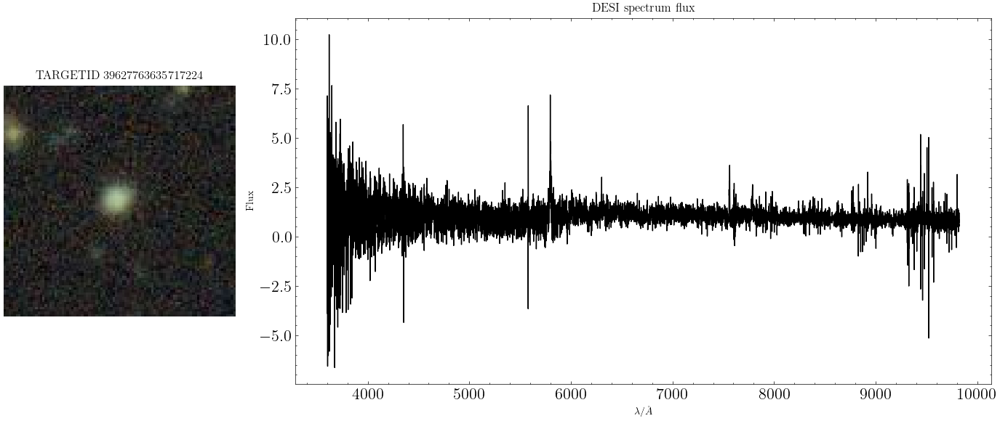

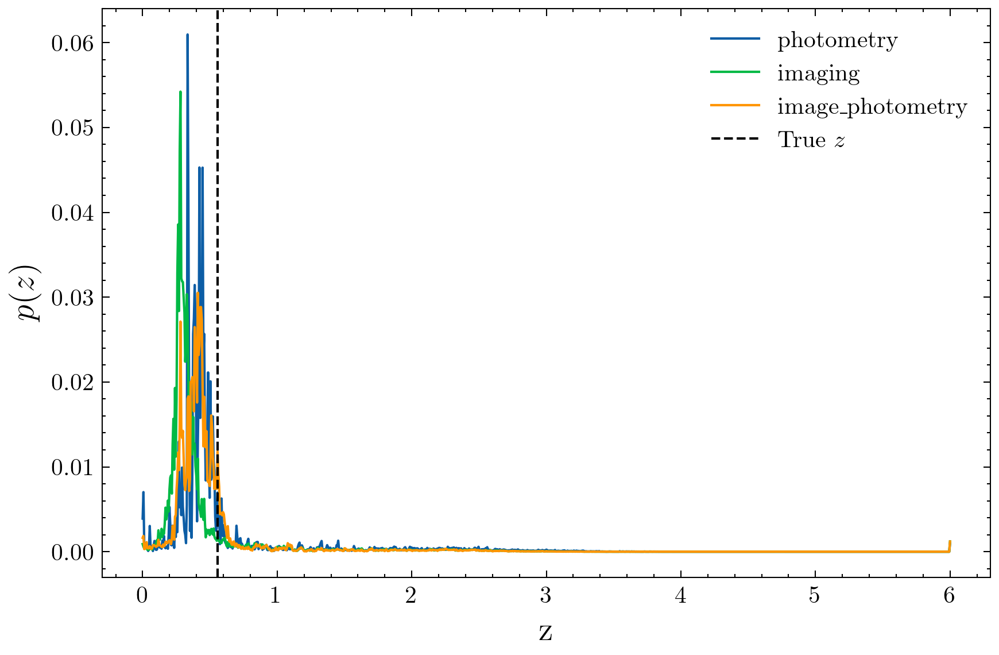

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763648301265,-8.189691,10.976713180541992,0.021776935,0.4839493


Z                                     5.439859
Photometry                           53.245583
Imaging                              54.515488
Spectroscopy                          0.000000
Image + Photometry                   32.277966
Image + Spectrum                      0.022861
Image + Spectrum + Photometry         0.011117
Image + Spectrum + Photometry + Z     0.043120
ratio_p_ip                            1.649595
ratio_p_i                             0.976706
ratio_p_i_rank                       12.000000
Name: 3353, dtype: float64

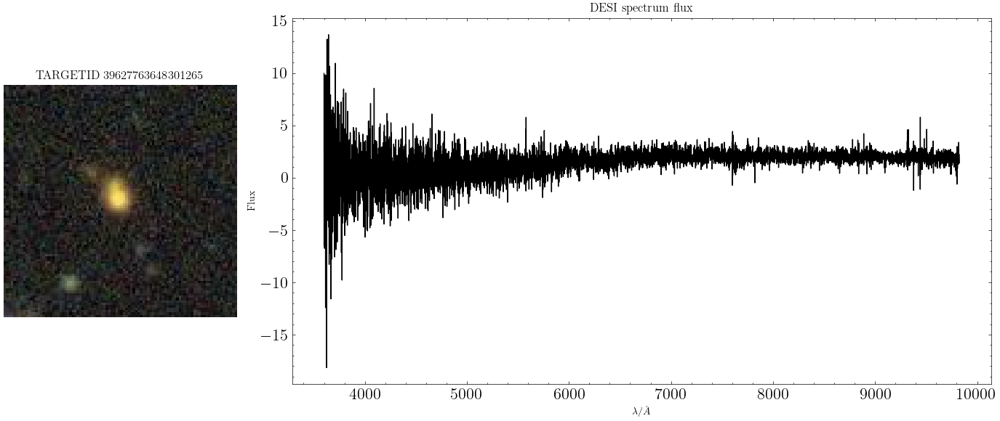

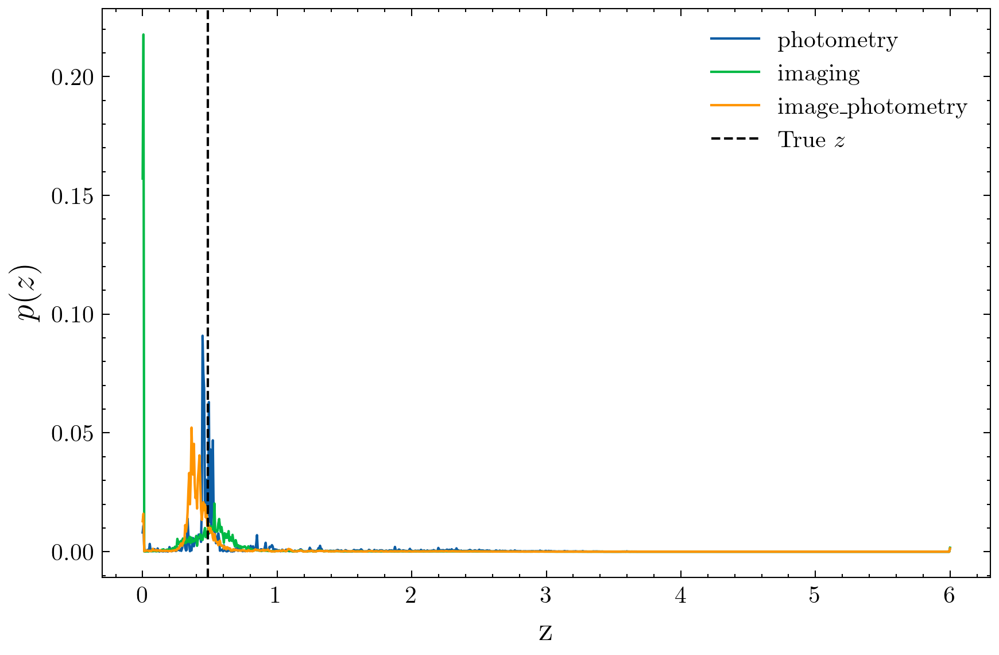

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799853533045,-8.895656,11.200061798095703,0.026204681,0.5414805


Z                                     7.501634
Photometry                           36.498028
Imaging                              36.727329
Spectroscopy                          0.000000
Image + Photometry                   22.400610
Image + Spectrum                      0.860746
Image + Spectrum + Photometry         0.544401
Image + Spectrum + Photometry + Z     4.313638
ratio_p_ip                            1.629332
ratio_p_i                             0.993757
ratio_p_i_rank                       11.000000
Name: 1296, dtype: float64

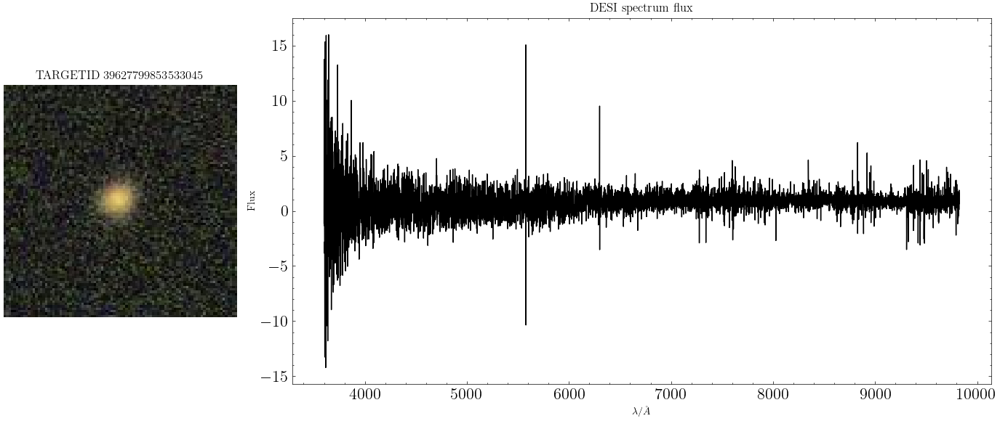

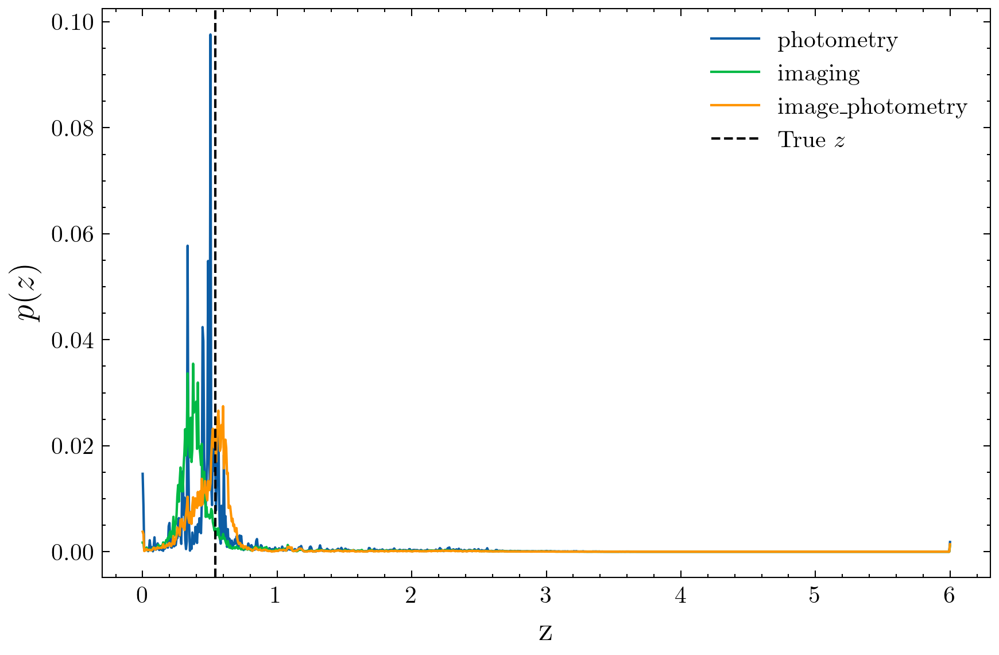

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793805348399,-8.133104,11.084630966186523,0.024457255,0.49217203


Z                                     7.180030
Photometry                           32.655998
Imaging                              32.002178
Spectroscopy                          0.000000
Image + Photometry                   21.142429
Image + Spectrum                      0.065508
Image + Spectrum + Photometry         0.151125
Image + Spectrum + Photometry + Z     0.034777
ratio_p_ip                            1.544572
ratio_p_i                             1.020430
ratio_p_i_rank                       10.000000
Name: 816, dtype: float64

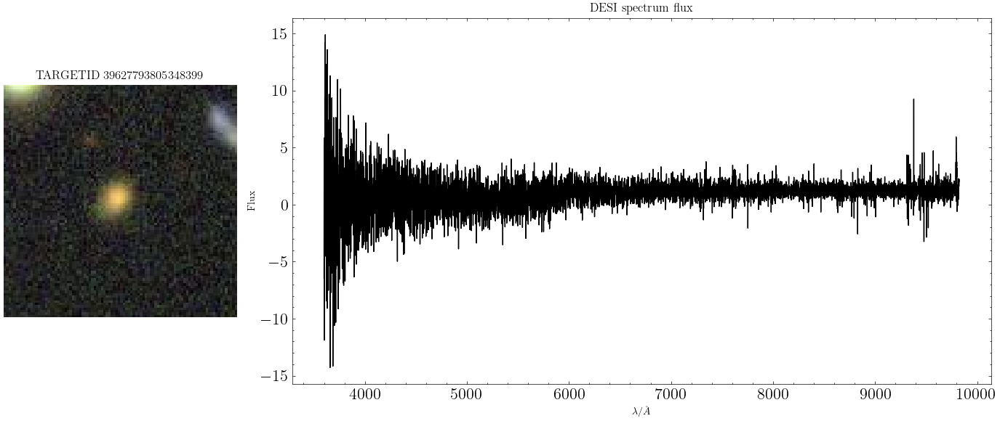

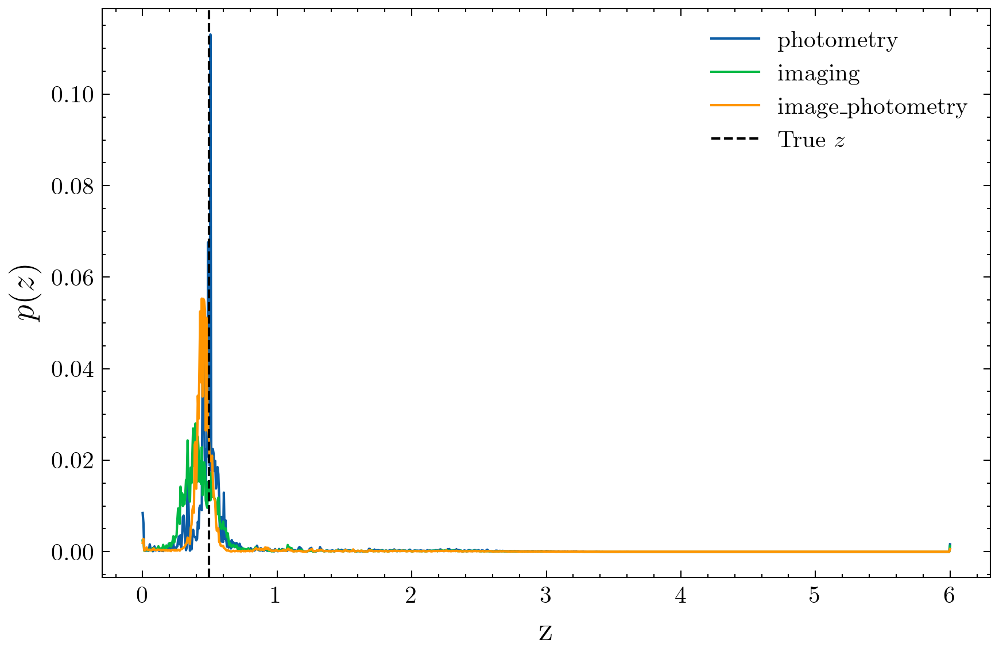

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627787799104091,-7.844743,11.159693717956543,0.02262175,0.43560892


Z                                    64.926186
Photometry                           69.944008
Imaging                              68.104500
Spectroscopy                          0.000000
Image + Photometry                   60.973331
Image + Spectrum                     56.359947
Image + Spectrum + Photometry        59.041134
Image + Spectrum + Photometry + Z    82.386658
ratio_p_ip                            1.147125
ratio_p_i                             1.027010
ratio_p_i_rank                        9.000000
Name: 612, dtype: float64

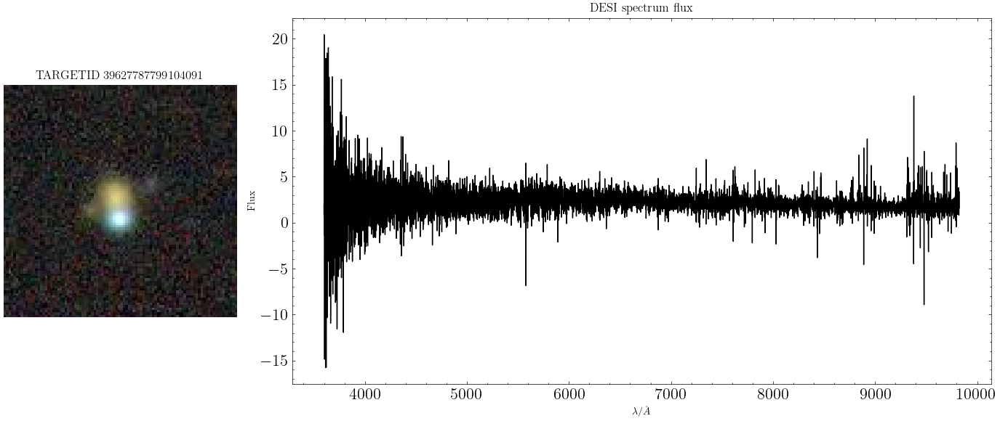

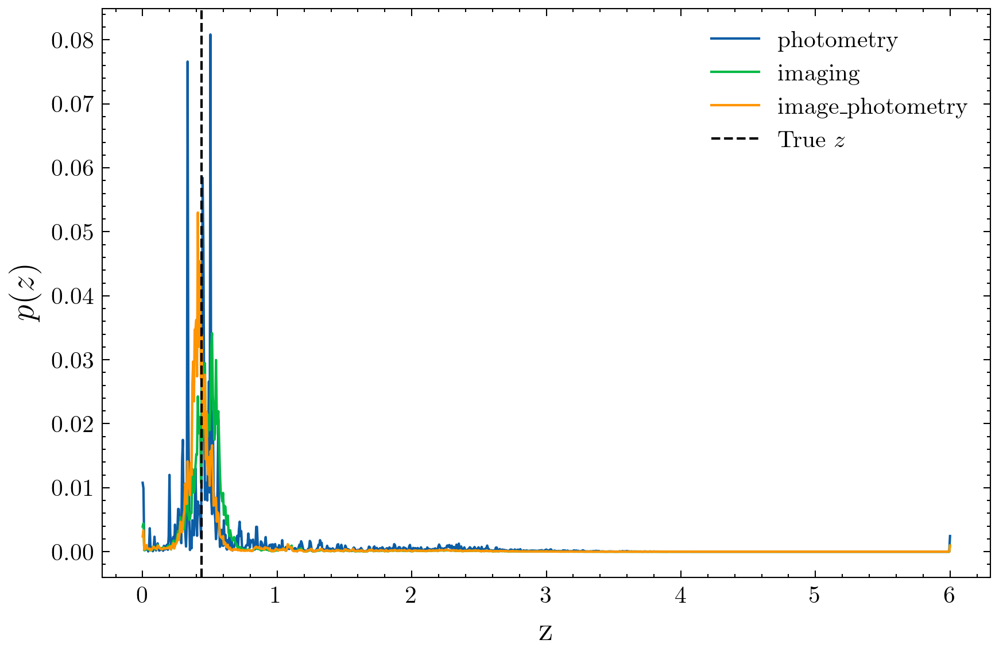

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793822126545,-8.521656,10.67737102508545,0.02321662,0.44445354


Z                                    23.417820
Photometry                           53.747196
Imaging                              51.214581
Spectroscopy                          0.000000
Image + Photometry                   33.422817
Image + Spectrum                      0.128165
Image + Spectrum + Photometry         0.151183
Image + Spectrum + Photometry + Z     0.119866
ratio_p_ip                            1.608099
ratio_p_i                             1.049451
ratio_p_i_rank                        8.000000
Name: 905, dtype: float64

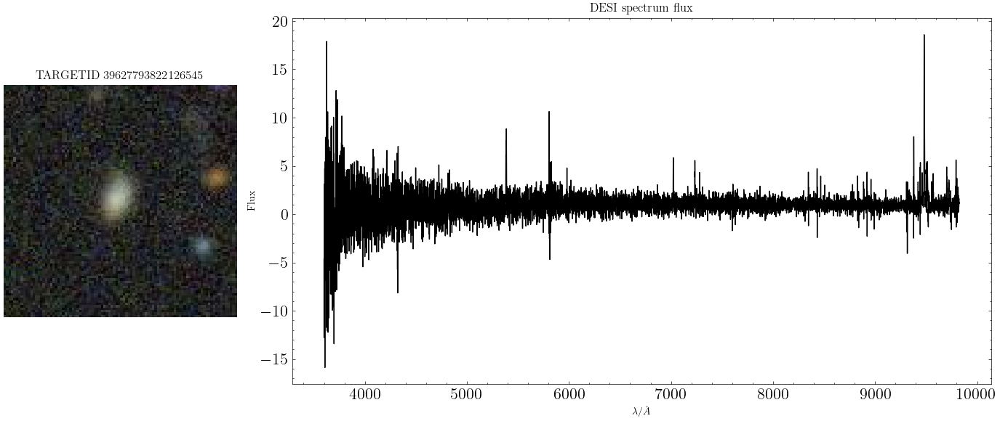

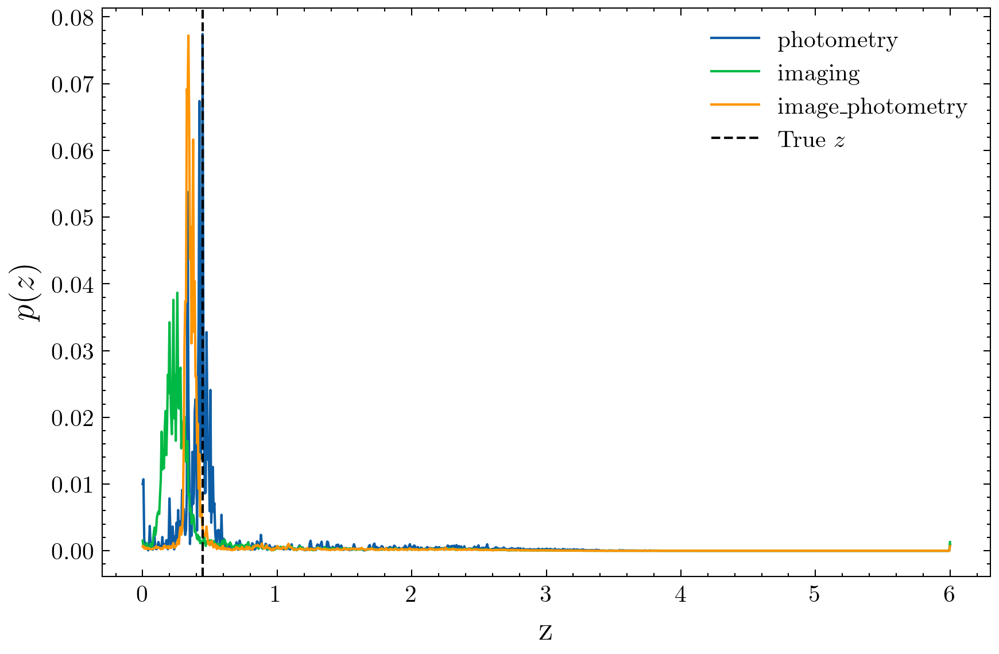

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811945710496,-8.171351,10.430302619934082,0.029368706,0.43648148


Z                                    19.082649
Photometry                           48.577805
Imaging                              45.567108
Spectroscopy                          0.000000
Image + Photometry                   22.305550
Image + Spectrum                      0.022835
Image + Spectrum + Photometry         0.013301
Image + Spectrum + Photometry + Z     0.027278
ratio_p_ip                            2.177835
ratio_p_i                             1.066072
ratio_p_i_rank                        7.000000
Name: 2070, dtype: float64

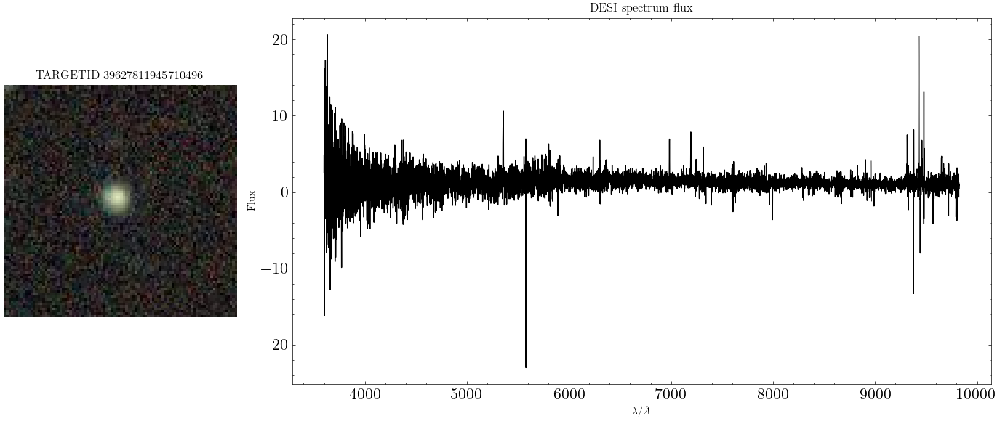

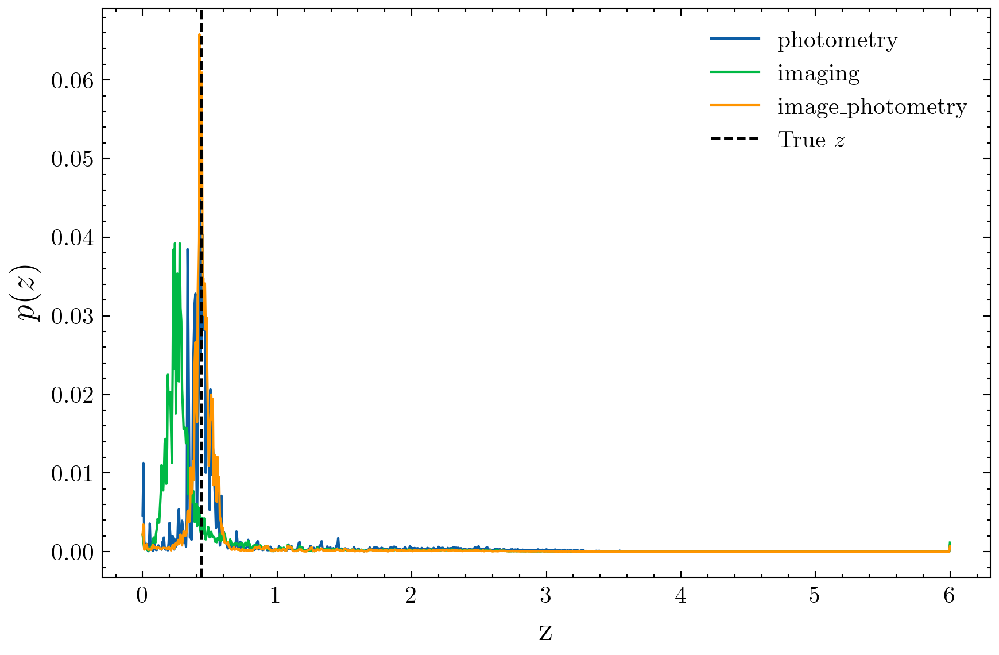

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811966682066,-8.232354,10.118284225463867,0.02860092,0.40909922


Z                                    10.057484
Photometry                           60.348812
Imaging                              56.607784
Spectroscopy                          0.000000
Image + Photometry                   38.401569
Image + Spectrum                      0.067735
Image + Spectrum + Photometry         0.021251
Image + Spectrum + Photometry + Z     0.026025
ratio_p_ip                            1.571519
ratio_p_i                             1.066087
ratio_p_i_rank                        6.000000
Name: 2438, dtype: float64

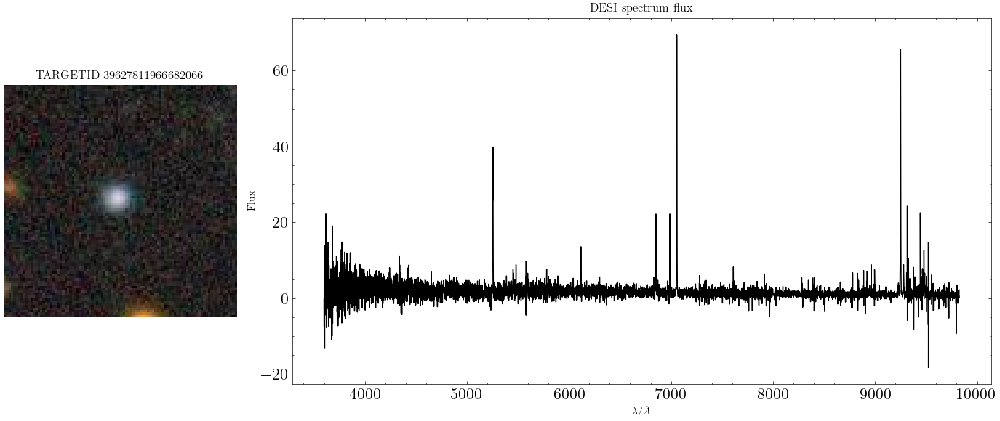

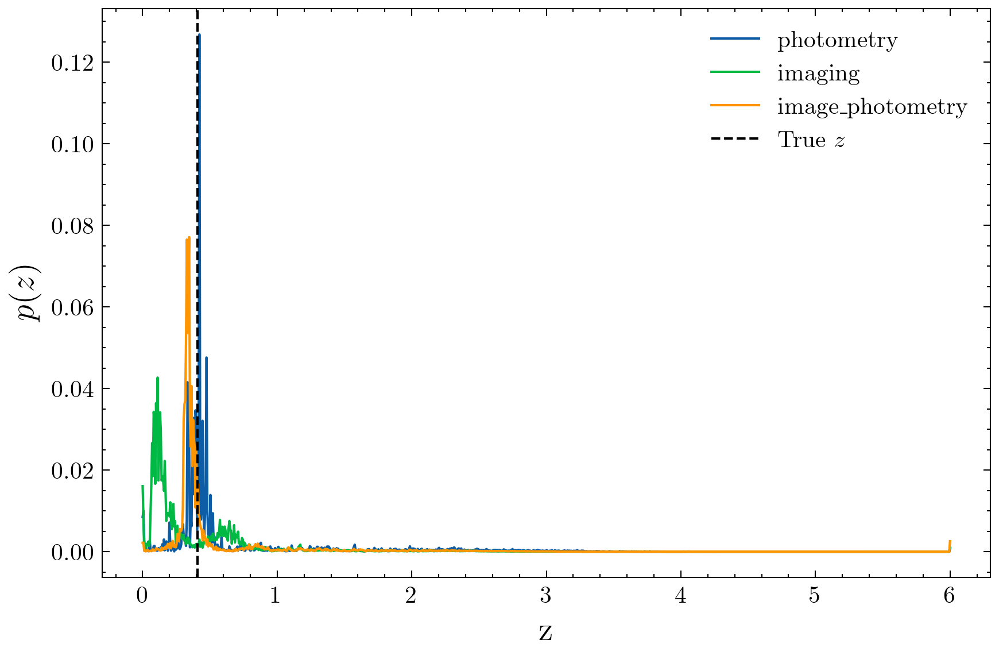

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763644108917,-7.553115,11.561348915100098,0.02096649,0.4257289


Z                                    24.112940
Photometry                           48.270763
Imaging                              44.962860
Spectroscopy                          0.000000
Image + Photometry                   28.857056
Image + Spectrum                      0.047301
Image + Spectrum + Photometry         0.049994
Image + Spectrum + Photometry + Z     0.045667
ratio_p_ip                            1.672754
ratio_p_i                             1.073570
ratio_p_i_rank                        5.000000
Name: 3320, dtype: float64

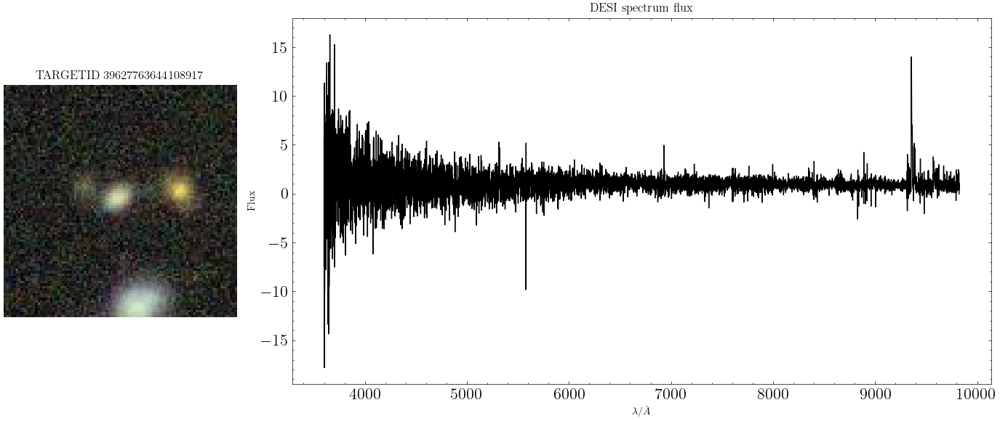

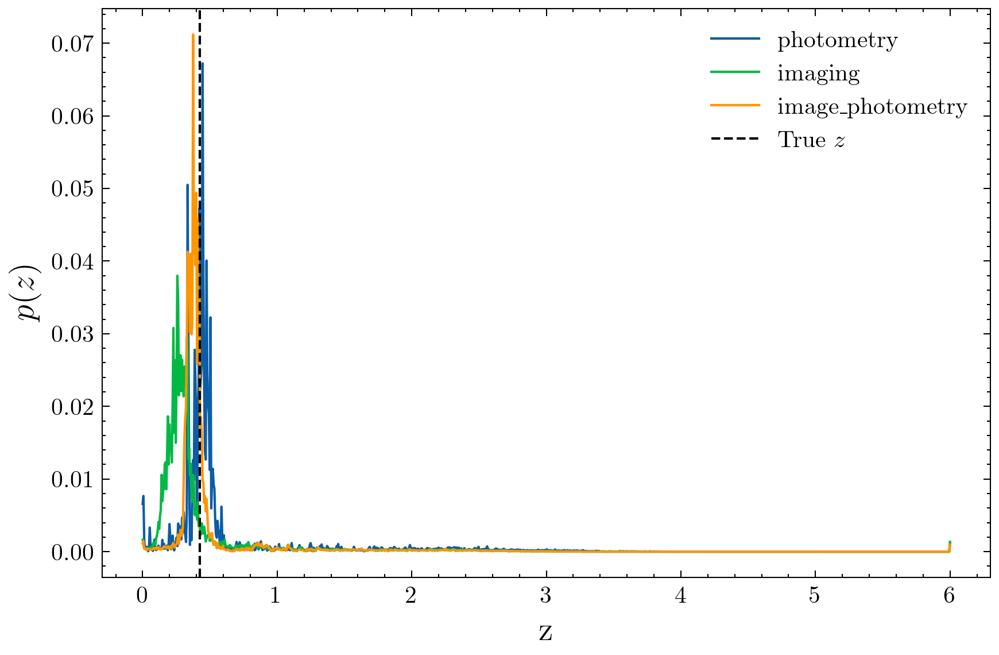

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627818014869798,-6.975453,11.220035552978516,0.021838058,0.48251003


Z                                     5.435648
Photometry                           43.807178
Imaging                              40.512020
Spectroscopy                          0.000000
Image + Photometry                   34.504593
Image + Spectrum                      0.004290
Image + Spectrum + Photometry         0.001898
Image + Spectrum + Photometry + Z     0.006169
ratio_p_ip                            1.269604
ratio_p_i                             1.081338
ratio_p_i_rank                        4.000000
Name: 2775, dtype: float64

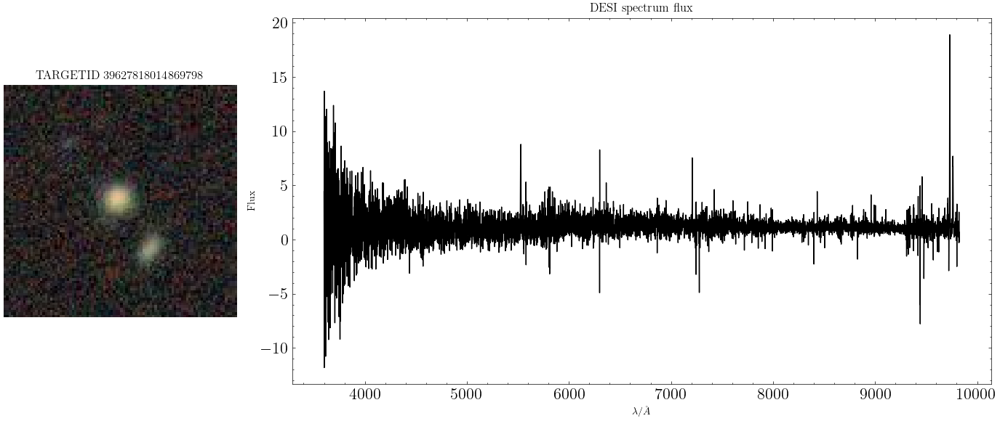

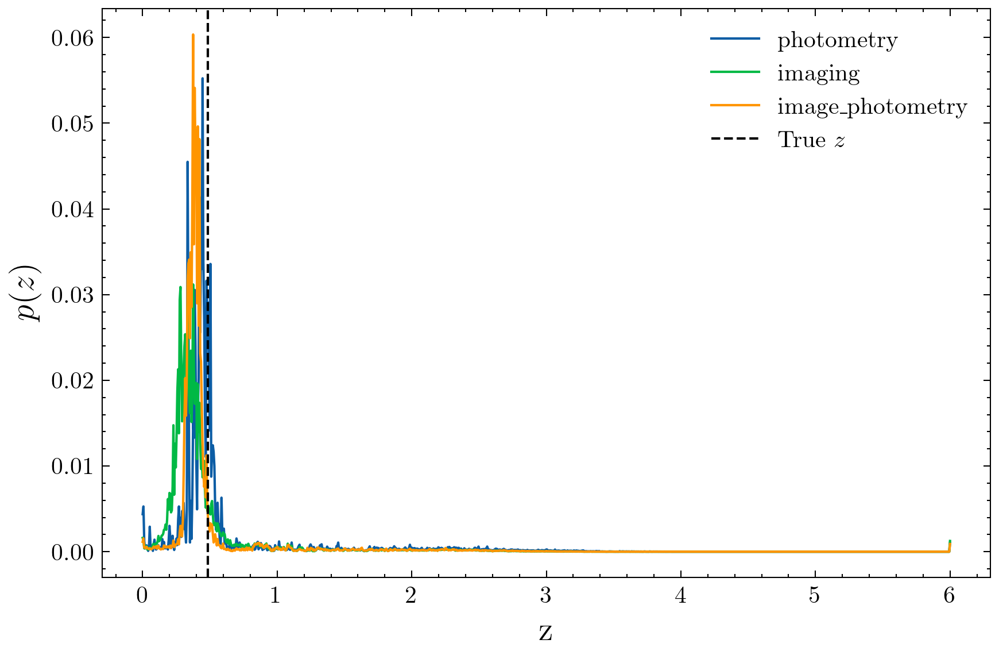

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627775694343622,-5.829042,11.145731925964355,0.01859737,0.53637683


Z                                    52.106285
Photometry                           31.992619
Imaging                              29.576077
Spectroscopy                          0.000000
Image + Photometry                   35.048923
Image + Spectrum                     54.085239
Image + Spectrum + Photometry        58.526592
Image + Spectrum + Photometry + Z    61.044144
ratio_p_ip                            0.912799
ratio_p_i                             1.081706
ratio_p_i_rank                        3.000000
Name: 3442, dtype: float64

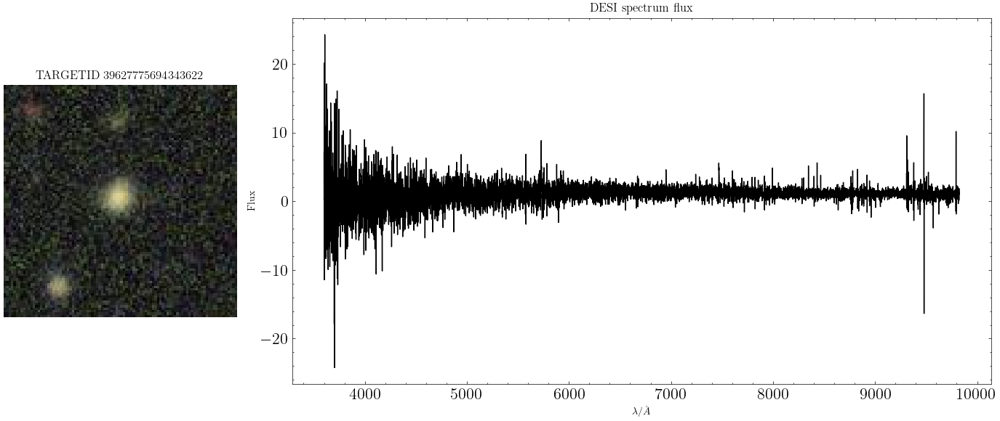

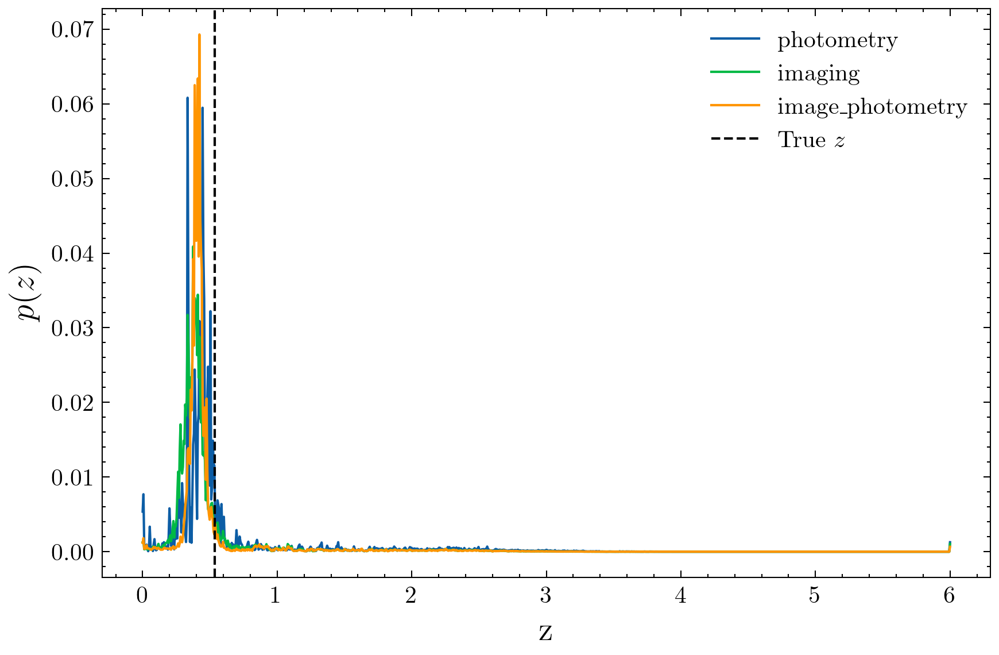

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627751564511225,-7.637816,11.032074928283691,0.02378779,0.5642005


Z                                    36.181084
Photometry                           43.711197
Imaging                              40.310604
Spectroscopy                          0.000000
Image + Photometry                   61.948307
Image + Spectrum                     46.125168
Image + Spectrum + Photometry        46.997719
Image + Spectrum + Photometry + Z    60.556587
ratio_p_ip                            0.705608
ratio_p_i                             1.084360
ratio_p_i_rank                        2.000000
Name: 254, dtype: float64

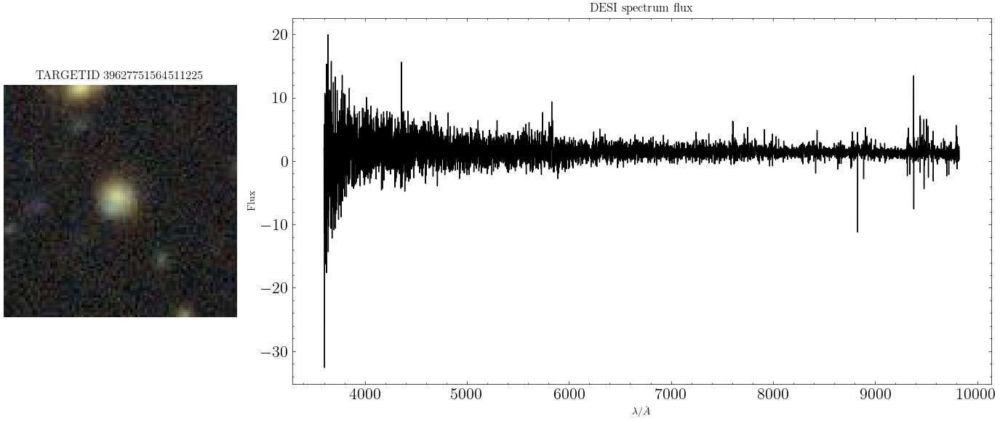

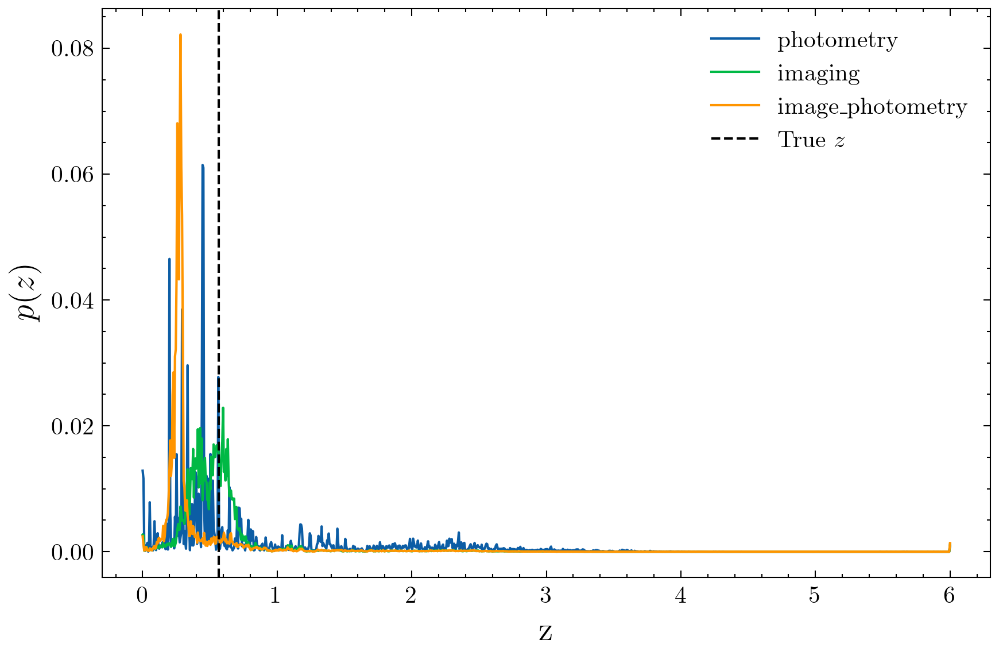

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763639910968,-8.843942,11.159923553466797,0.0224914,0.5100995


Z                                    14.465539
Photometry                           48.490440
Imaging                              44.309345
Spectroscopy                          0.000000
Image + Photometry                   38.386440
Image + Spectrum                      0.400185
Image + Spectrum + Photometry         0.326360
Image + Spectrum + Photometry + Z     0.384356
ratio_p_ip                            1.263218
ratio_p_i                             1.094361
ratio_p_i_rank                        1.000000
Name: 3226, dtype: float64

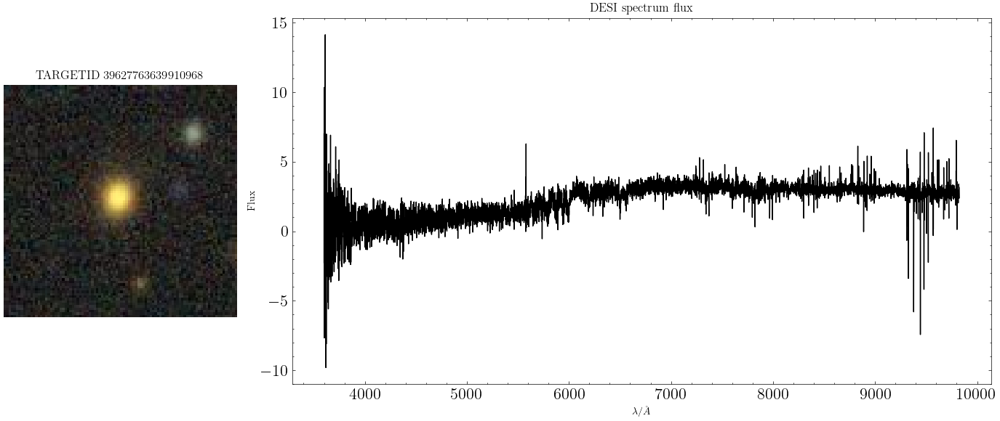

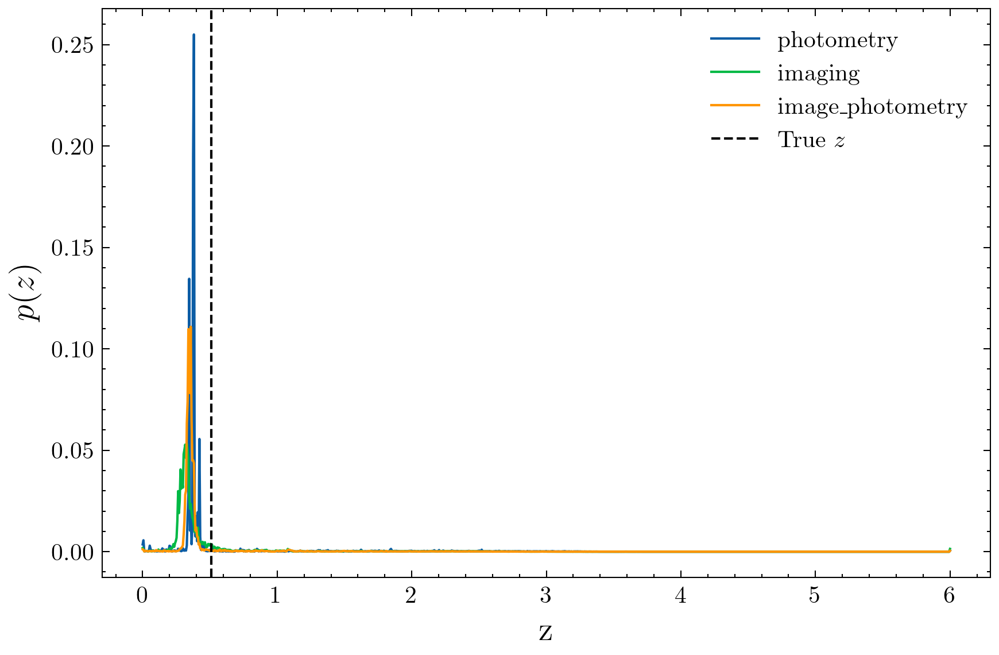

------------------------------------------------


In [55]:
plot_z_dist(
    check_df,
    table_sorted,
    names,
    tok_z_p,
    ascending=True, 
    col="ratio_p_i"
)

Highest photometry to image ratios (poor photometry)

In [56]:
threshold = 30 #threshold at -10

#print(df.loc[(df["ratio_p_ip"] < threshold) == True])

# 2) Filter rows
mask = df["ratio_p_i"] >= threshold
check_df = df.loc[mask].copy()

# 3a) Option A: add a rank column (1 = highest diff)
check_df["ratio_p_i_rank"] = check_df["ratio_p_i"].rank(ascending=False, method="dense")

# 3b) Option B: sort by the difference
check_df = check_df.sort_values("ratio_p_i", ascending=False)

TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805901723027,-15.834083,8.973406791687012,0.024814619,0.01952745


Z                                     21.361233
Photometry                           396.806335
Imaging                                1.860196
Spectroscopy                           0.000000
Image + Photometry                     1.822519
Image + Spectrum                       2.640931
Image + Spectrum + Photometry          2.313402
Image + Spectrum + Photometry + Z      4.855231
ratio_p_ip                           217.724167
ratio_p_i                            213.314209
ratio_p_i_rank                         1.000000
Name: 1783, dtype: float64

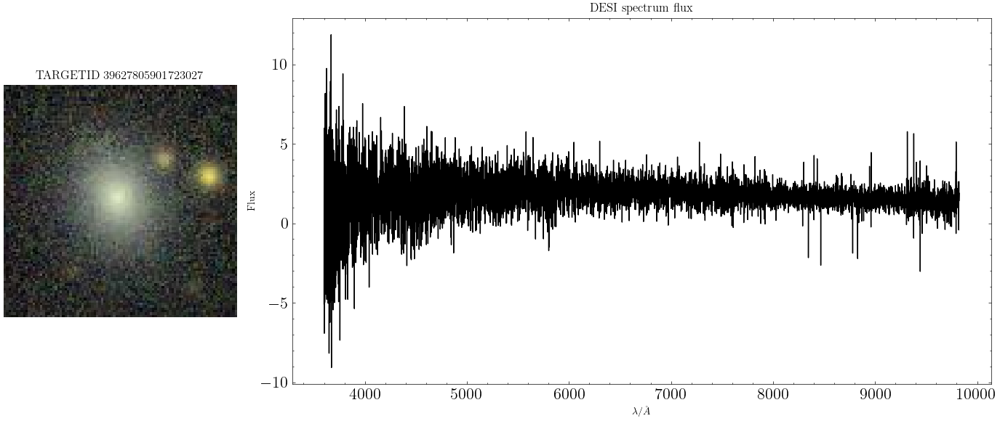

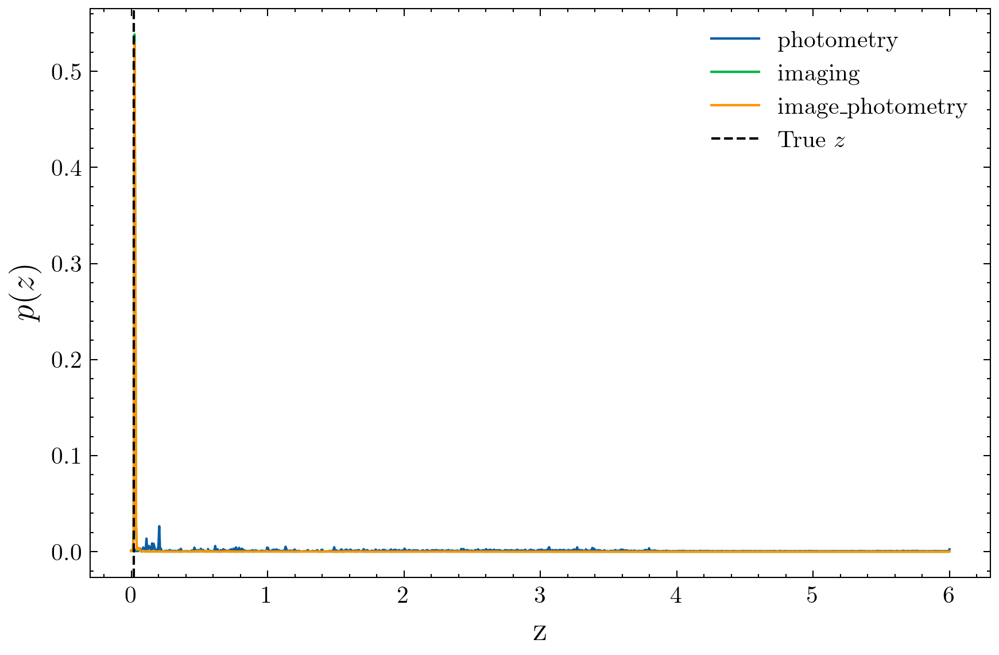

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805910109973,-13.921593,8.707478523254395,0.028308174,0.020388175


Z                                     32.638824
Photometry                           683.985962
Imaging                               14.059603
Spectroscopy                           0.000000
Image + Photometry                    18.874502
Image + Spectrum                       0.234559
Image + Spectrum + Photometry          0.148532
Image + Spectrum + Photometry + Z      0.080322
ratio_p_ip                            36.238621
ratio_p_i                             48.649025
ratio_p_i_rank                         2.000000
Name: 1901, dtype: float64

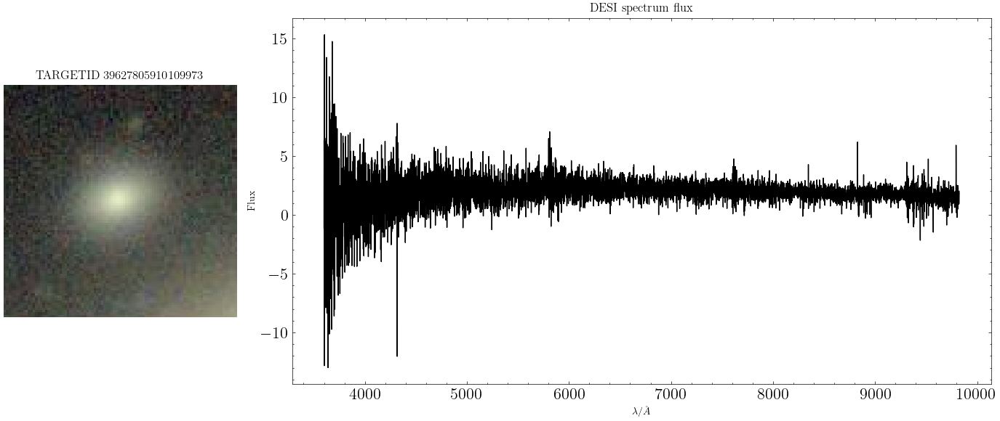

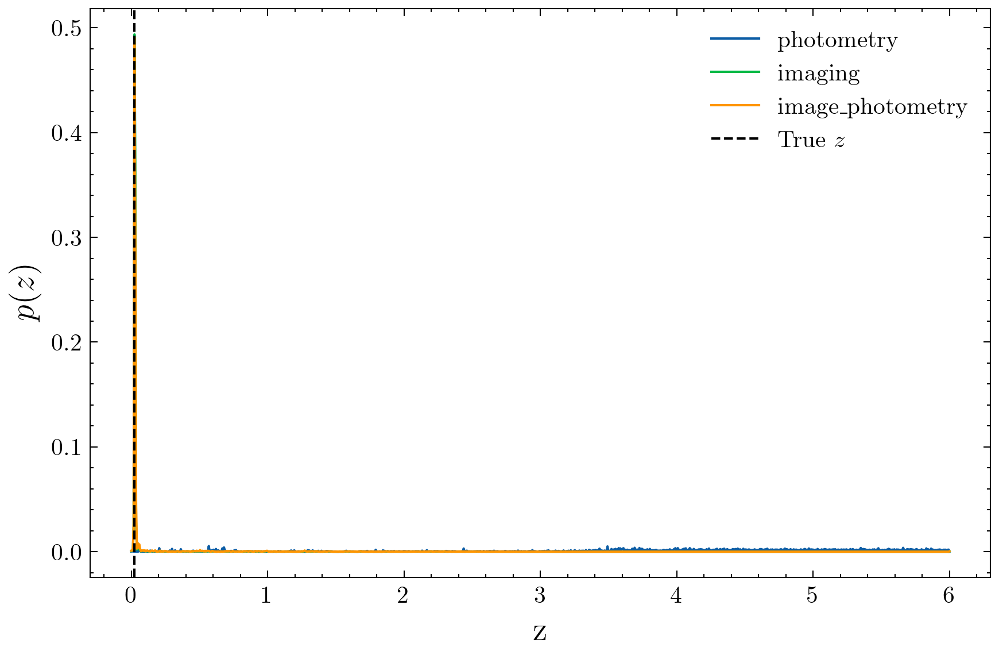

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627805910111159,-14.771024,8.656739234924316,0.028197091,0.01897276


Z                                     23.375887
Photometry                           334.340759
Imaging                                8.172920
Spectroscopy                           0.000000
Image + Photometry                     8.721924
Image + Spectrum                       7.099023
Image + Spectrum + Photometry          6.958707
Image + Spectrum + Photometry + Z      7.836458
ratio_p_ip                            38.333374
ratio_p_i                             40.908360
ratio_p_i_rank                         3.000000
Name: 1915, dtype: float64

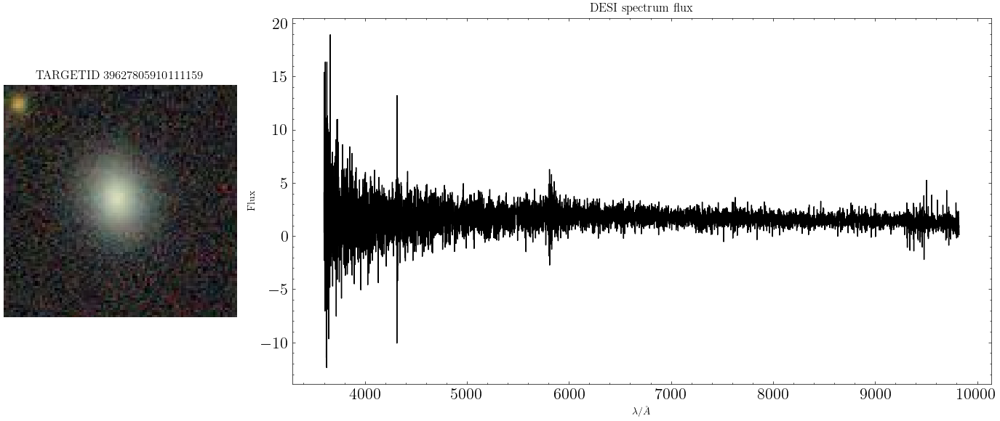

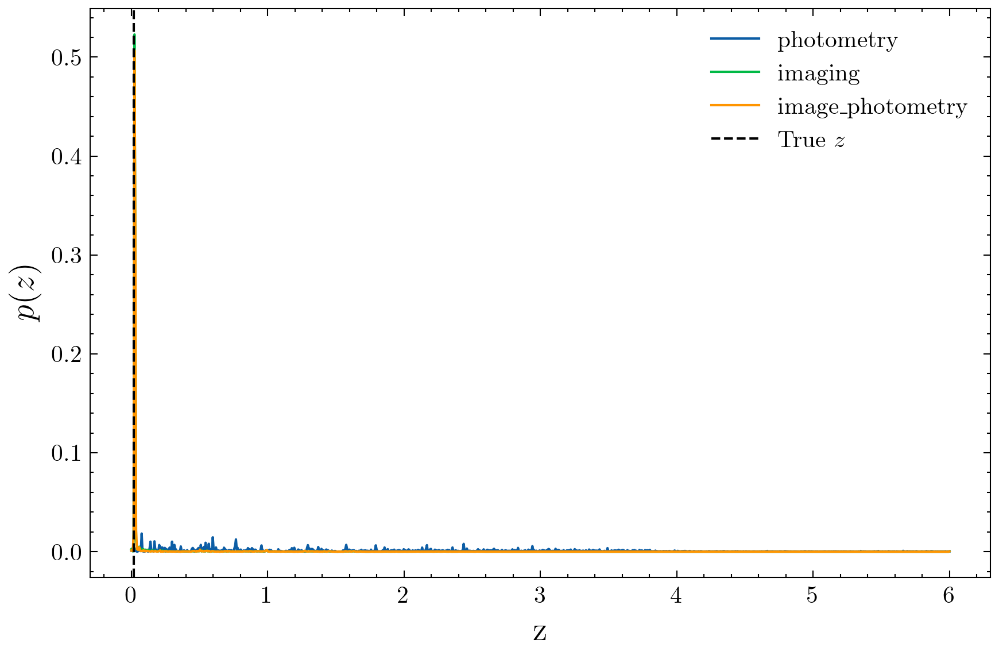

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793838899842,-12.4533205,9.160581588745117,0.027366748,0.06333147


Z                                      8.132374
Photometry                           450.687744
Imaging                               11.292500
Spectroscopy                           0.000000
Image + Photometry                    10.712807
Image + Spectrum                       6.545086
Image + Spectrum + Photometry         16.303213
Image + Spectrum + Photometry + Z     24.688755
ratio_p_ip                            42.069996
ratio_p_i                             39.910358
ratio_p_i_rank                         4.000000
Name: 1073, dtype: float64

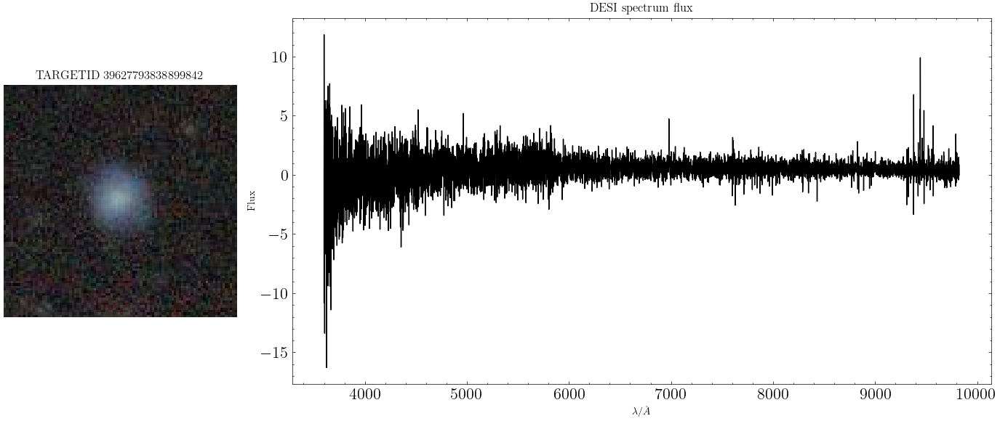

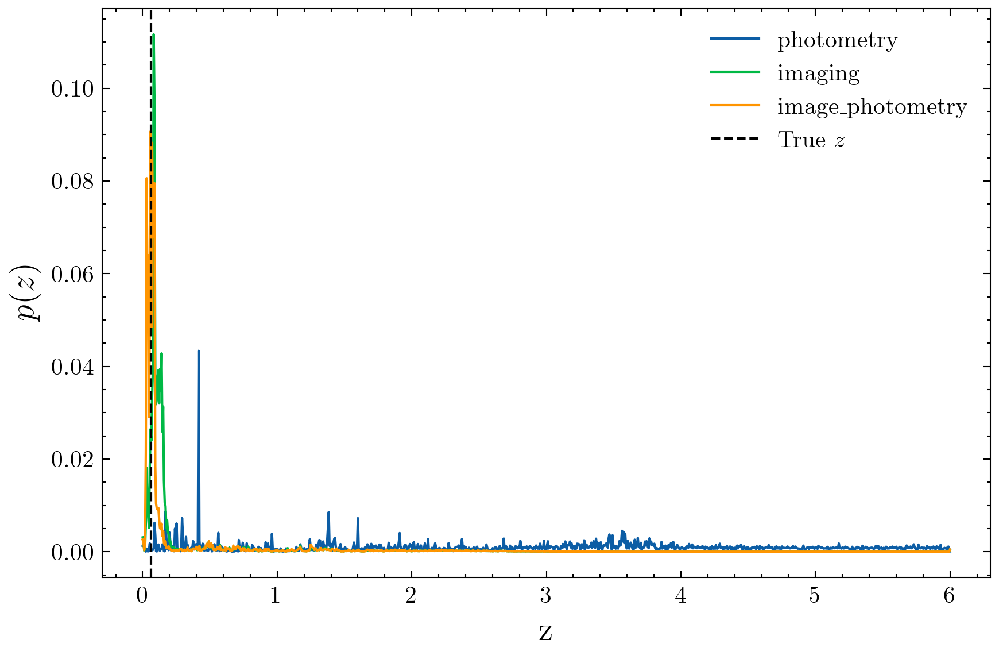

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627817998093040,-10.3589945,10.291114807128906,0.031220434,0.091543846


Z                                     17.620869
Photometry                           709.324646
Imaging                               18.297615
Spectroscopy                           0.000000
Image + Photometry                    19.819744
Image + Spectrum                       0.010040
Image + Spectrum + Photometry          0.005585
Image + Spectrum + Photometry + Z      0.003887
ratio_p_ip                            35.788788
ratio_p_i                             38.765961
ratio_p_i_rank                         5.000000
Name: 2481, dtype: float64

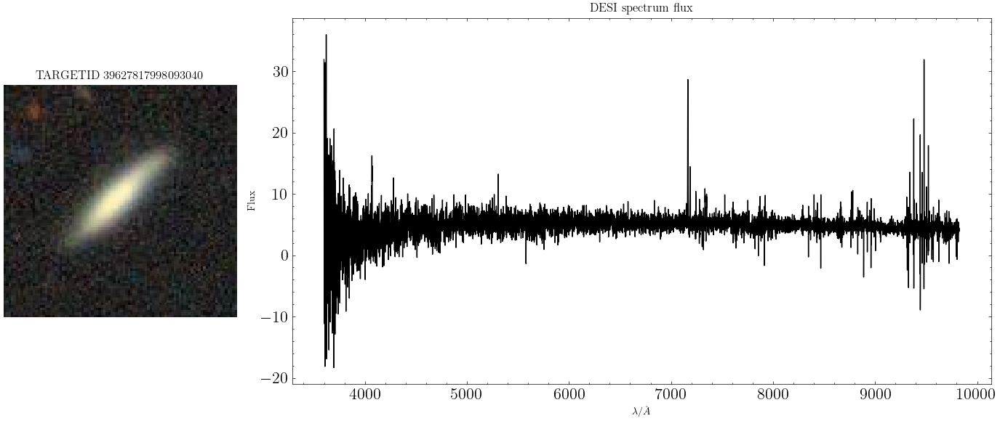

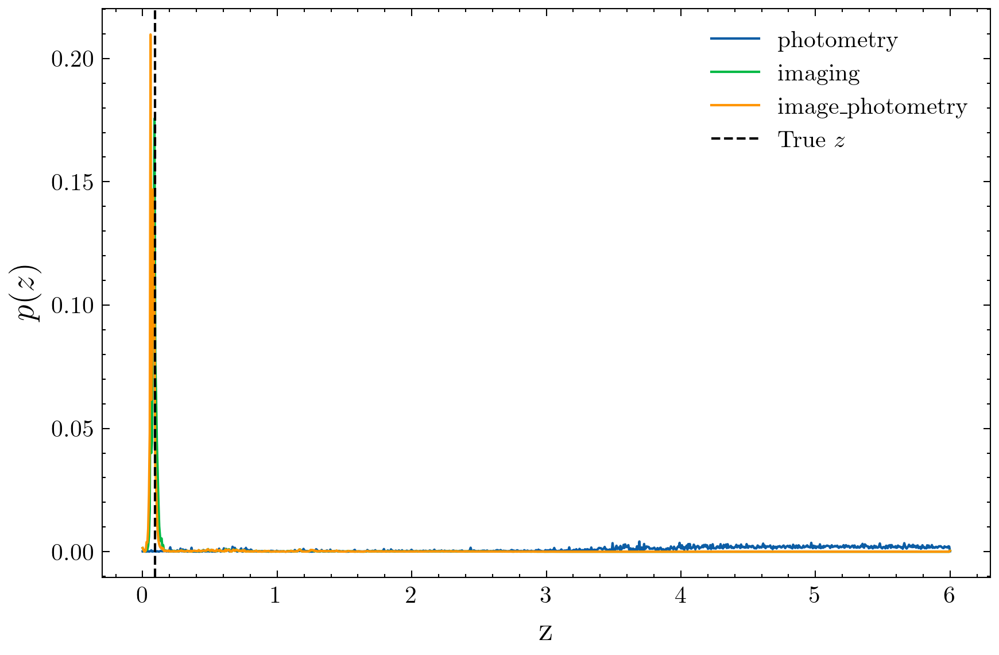

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627775694342667,-10.615402,10.500448226928711,0.018510567,0.12997773


Z                                     20.035406
Photometry                           688.561890
Imaging                               18.145224
Spectroscopy                           0.000000
Image + Photometry                    18.965149
Image + Spectrum                       0.028348
Image + Spectrum + Photometry          0.027416
Image + Spectrum + Photometry + Z      0.024781
ratio_p_ip                            36.306694
ratio_p_i                             37.947281
ratio_p_i_rank                         6.000000
Name: 3432, dtype: float64

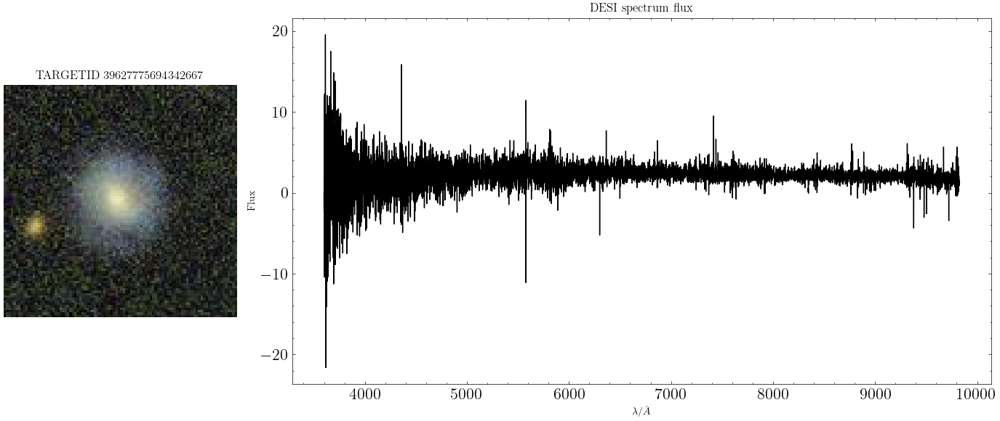

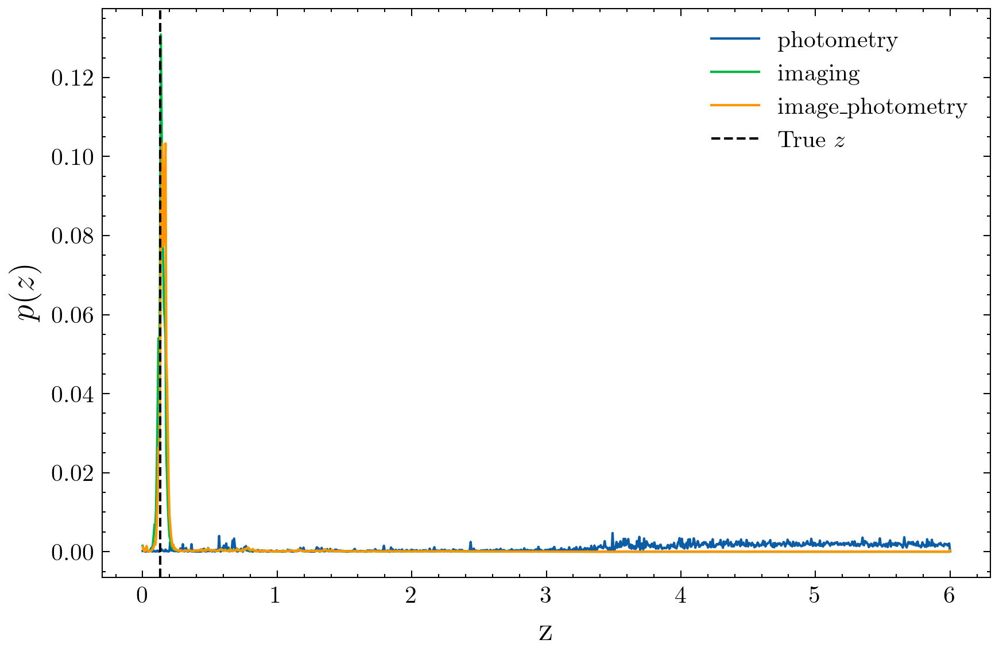

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627787765551173,-10.785342,12.13465690612793,0.023586571,0.5768452


Z                                     22.525084
Photometry                           458.784882
Imaging                               12.470707
Spectroscopy                           0.000000
Image + Photometry                     7.901842
Image + Spectrum                       0.046765
Image + Spectrum + Photometry          0.046228
Image + Spectrum + Photometry + Z      0.050721
ratio_p_ip                            58.060497
ratio_p_i                             36.789005
ratio_p_i_rank                         7.000000
Name: 300, dtype: float64

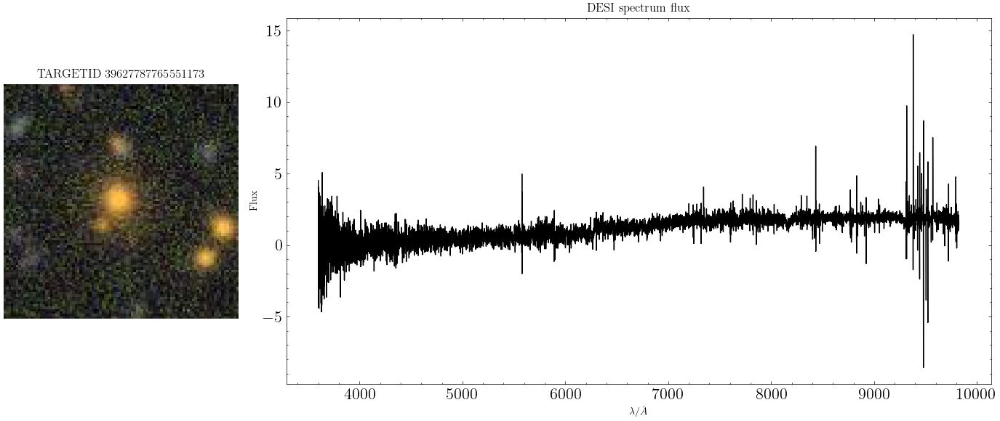

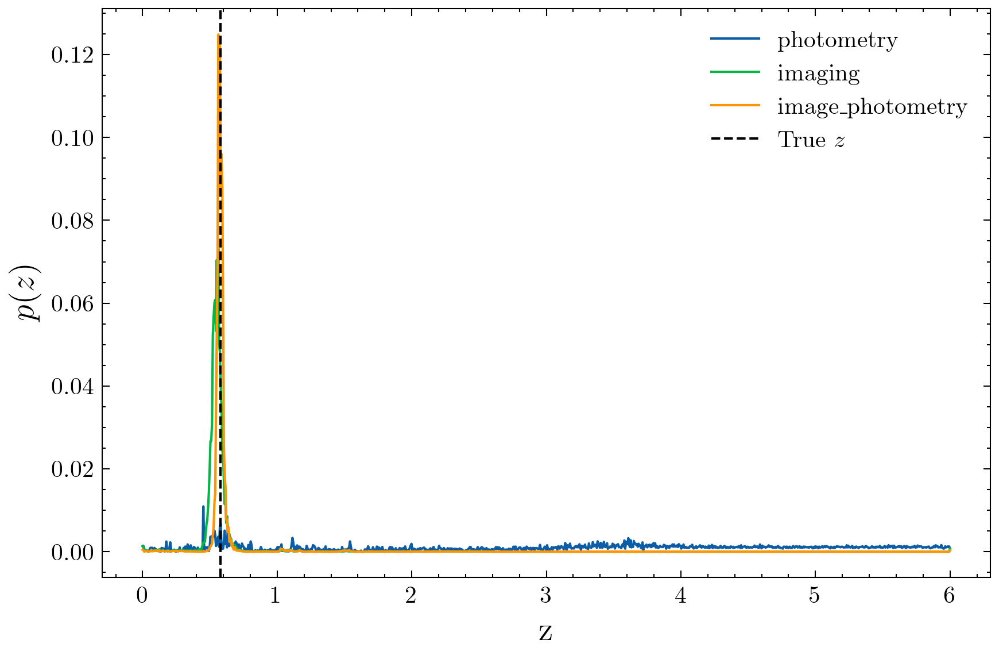

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627824029504560,-12.530321,11.813141822814941,0.025443997,0.584571


Z                                     26.011044
Photometry                           560.681519
Imaging                               15.419267
Spectroscopy                           0.000000
Image + Photometry                     6.653972
Image + Spectrum                       0.021495
Image + Spectrum + Photometry          0.025737
Image + Spectrum + Photometry + Z      0.060700
ratio_p_ip                            84.262688
ratio_p_i                             36.362400
ratio_p_i_rank                         8.000000
Name: 2856, dtype: float64

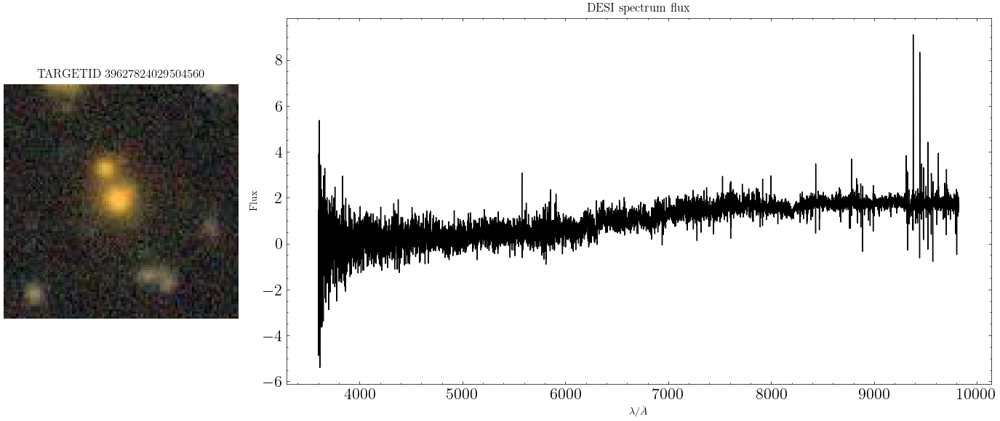

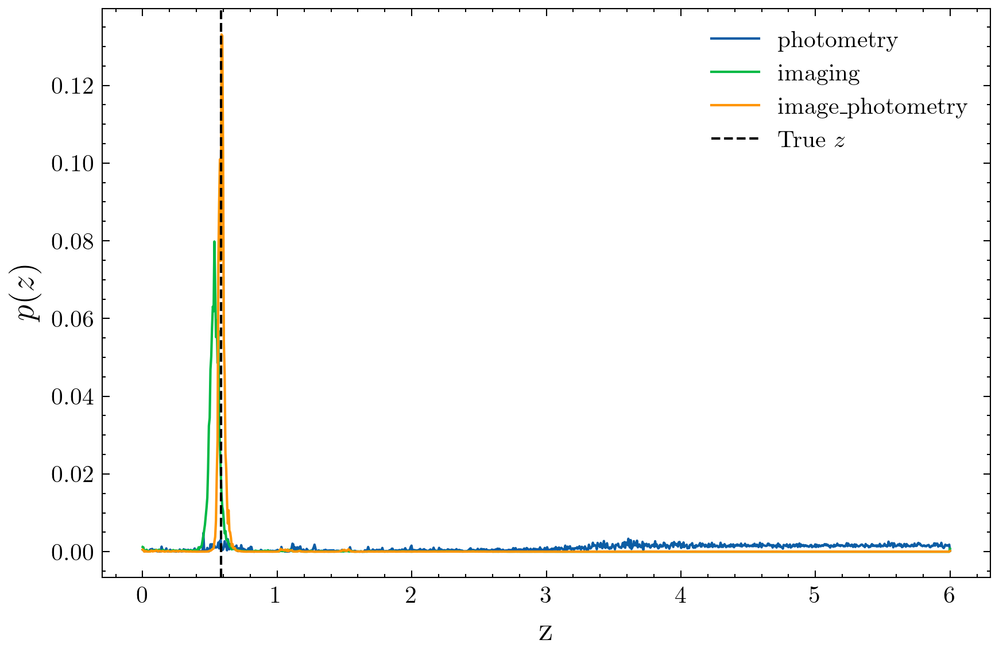

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627775694343689,-10.752632,10.27755069732666,0.019986562,0.09569986


Z                                     12.858727
Photometry                           713.286194
Imaging                               20.159966
Spectroscopy                           0.000000
Image + Photometry                    20.342159
Image + Spectrum                       0.130810
Image + Spectrum + Photometry          0.093708
Image + Spectrum + Photometry + Z      0.139467
ratio_p_ip                            35.064430
ratio_p_i                             35.381321
ratio_p_i_rank                         9.000000
Name: 3444, dtype: float64

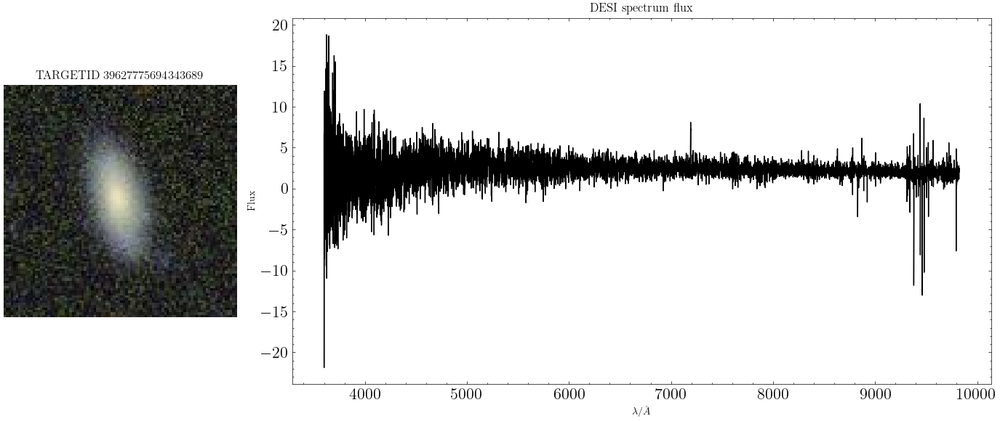

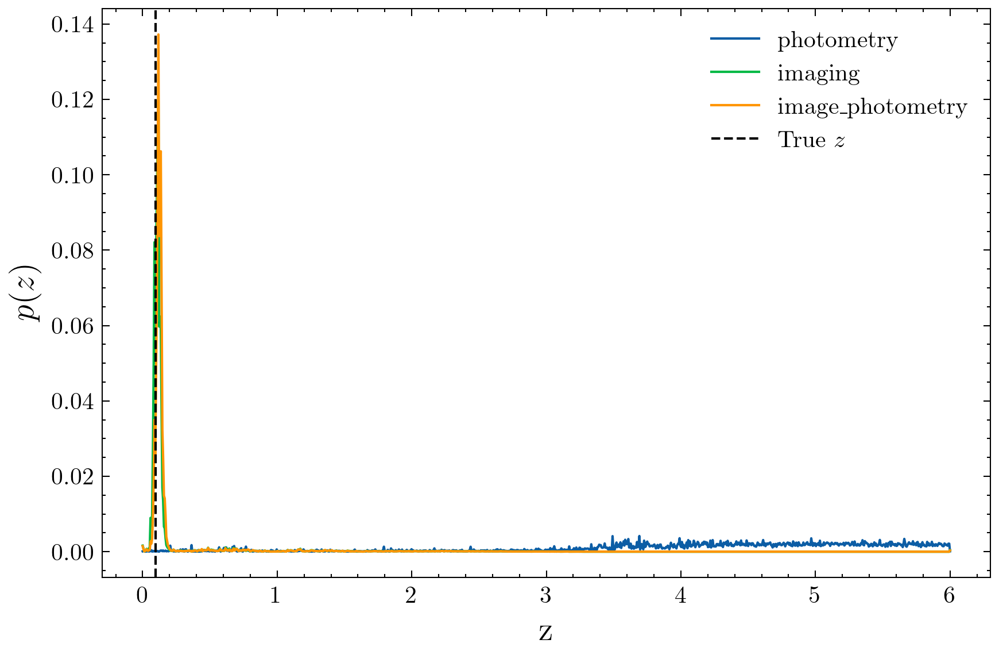

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627763639914451,-10.957174,9.844000816345215,0.022192143,0.099401794


Z                                      5.001126
Photometry                           418.657196
Imaging                               11.917477
Spectroscopy                           0.000000
Image + Photometry                    11.650346
Image + Spectrum                       2.953482
Image + Spectrum + Photometry          2.561156
Image + Spectrum + Photometry + Z     10.940001
ratio_p_ip                            35.935173
ratio_p_i                             35.129684
ratio_p_i_rank                        10.000000
Name: 3258, dtype: float64

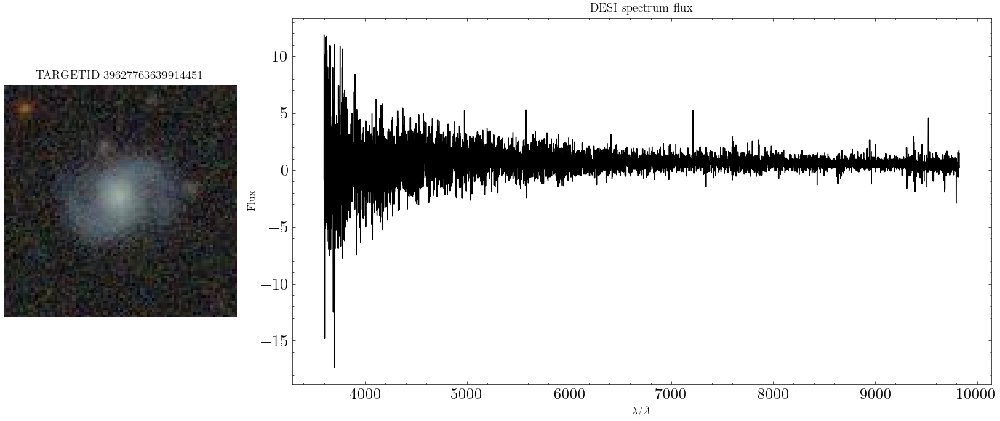

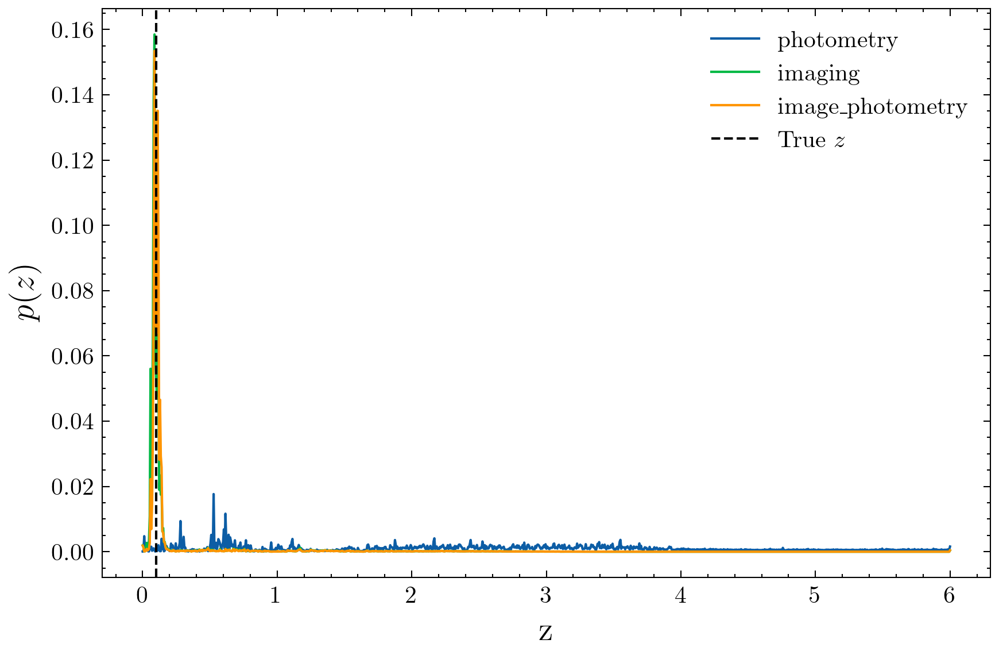

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793822125482,-11.302694,10.640060424804688,0.024227265,0.120204024


Z                                     19.036011
Photometry                           659.637634
Imaging                               18.872398
Spectroscopy                           0.000000
Image + Photometry                    18.617245
Image + Spectrum                       0.042488
Image + Spectrum + Photometry          0.044841
Image + Spectrum + Photometry + Z      0.028463
ratio_p_ip                            35.431538
ratio_p_i                             34.952507
ratio_p_i_rank                        11.000000
Name: 901, dtype: float64

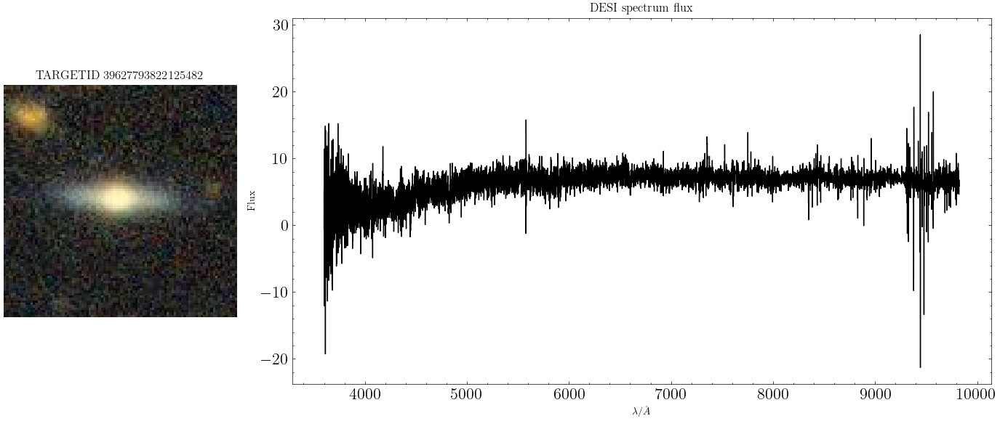

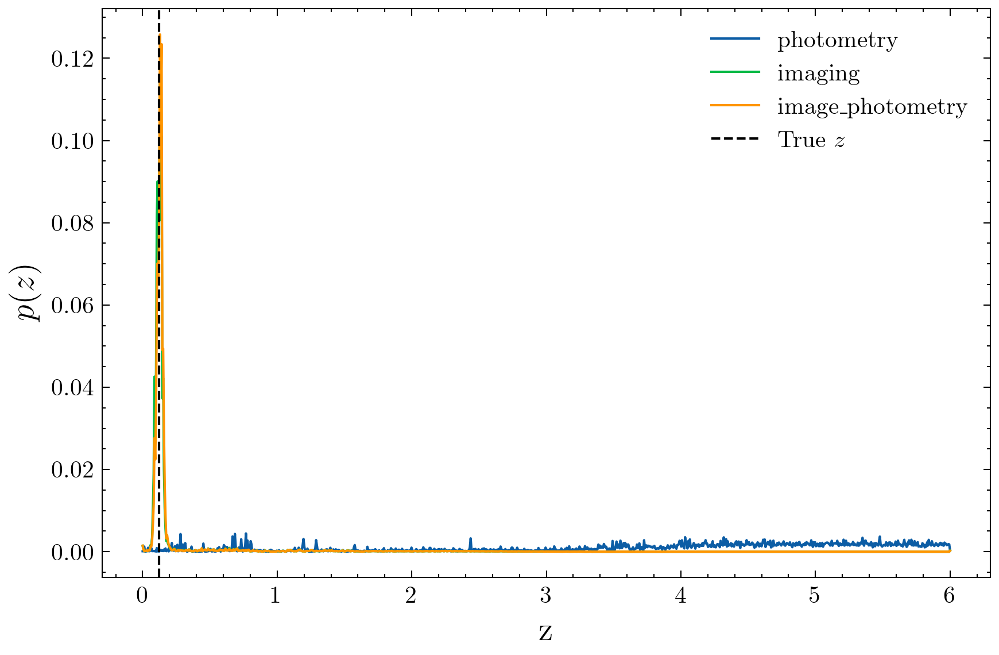

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811958295503,-10.257601,10.399767875671387,0.02989747,0.1245267


Z                                     19.176701
Photometry                           661.779236
Imaging                               19.369900
Spectroscopy                           0.000000
Image + Photometry                    17.681875
Image + Spectrum                       0.080653
Image + Spectrum + Photometry          0.085802
Image + Spectrum + Photometry + Z      0.075605
ratio_p_ip                            37.426983
ratio_p_i                             34.165340
ratio_p_i_rank                        12.000000
Name: 2312, dtype: float64

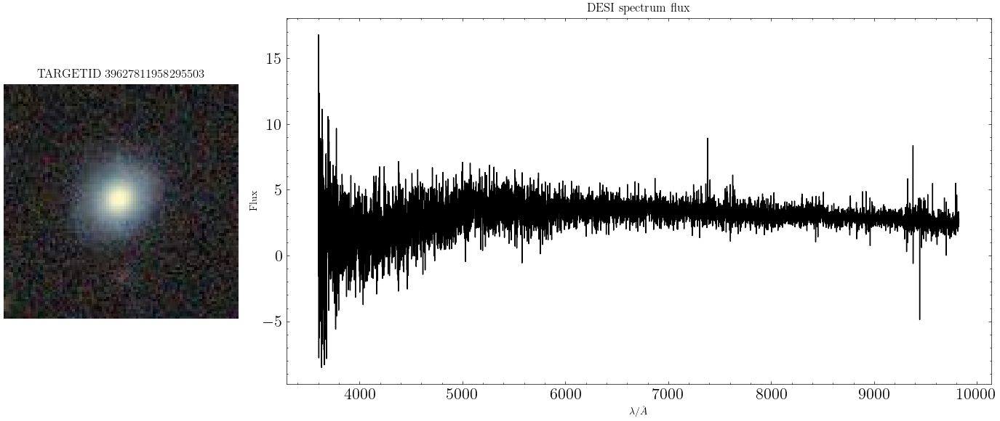

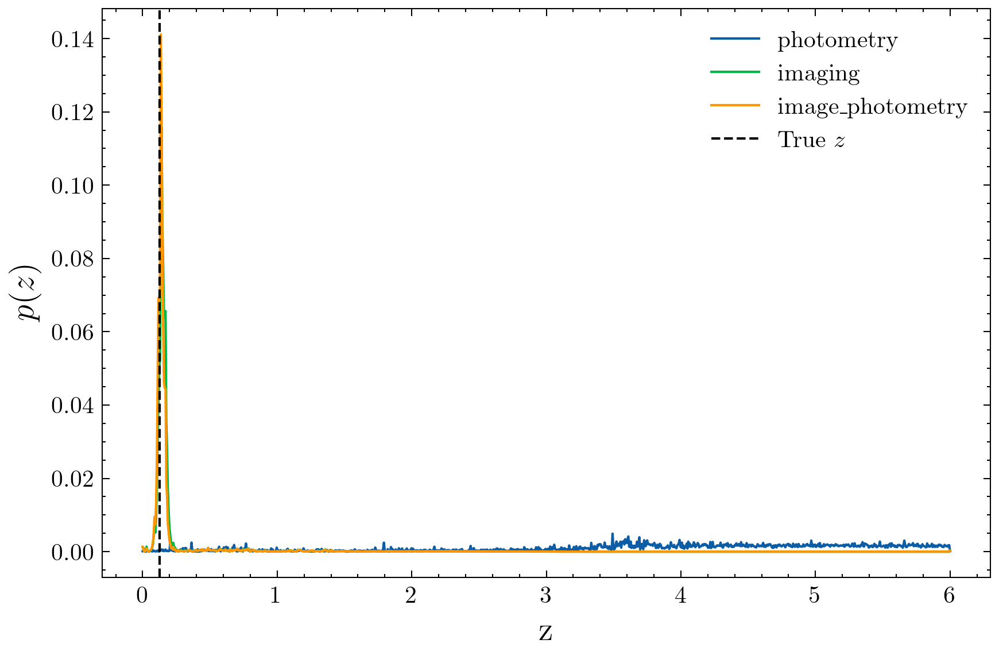

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793830511295,-13.49415,10.350564002990723,0.023113875,0.09564068


Z                                     13.087070
Photometry                           697.094849
Imaging                               20.486740
Spectroscopy                           0.000000
Image + Photometry                    18.110506
Image + Spectrum                       0.006224
Image + Spectrum + Photometry          0.004411
Image + Spectrum + Photometry + Z      0.003082
ratio_p_ip                            38.491184
ratio_p_i                             34.026634
ratio_p_i_rank                        13.000000
Name: 954, dtype: float64

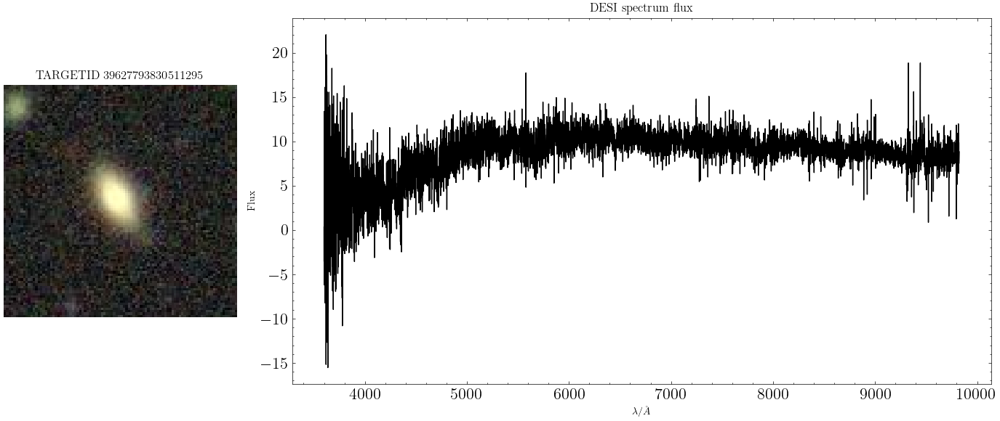

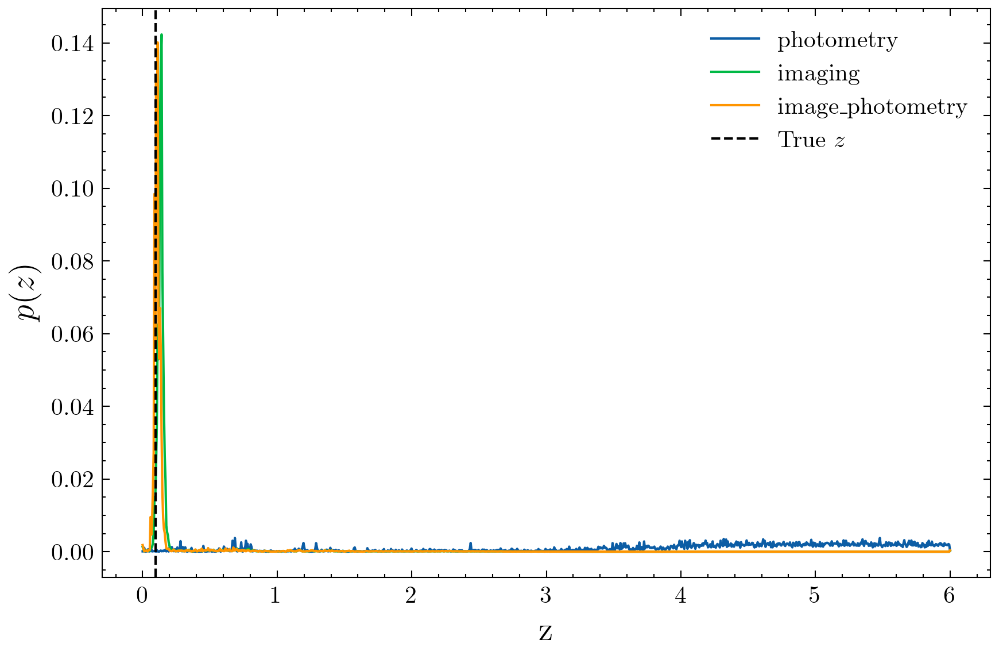

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627824033697825,-10.183842,10.731083869934082,0.025205128,0.13236153


Z                                     20.075821
Photometry                           621.992615
Imaging                               18.794699
Spectroscopy                           0.000000
Image + Photometry                    18.308258
Image + Spectrum                       0.005859
Image + Spectrum + Photometry          0.001827
Image + Spectrum + Photometry + Z      0.029912
ratio_p_ip                            33.973335
ratio_p_i                             33.094044
ratio_p_i_rank                        14.000000
Name: 2889, dtype: float64

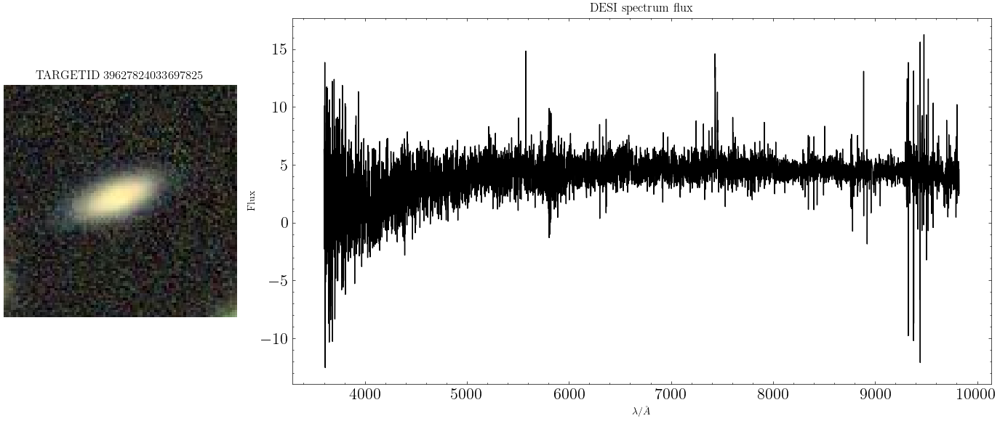

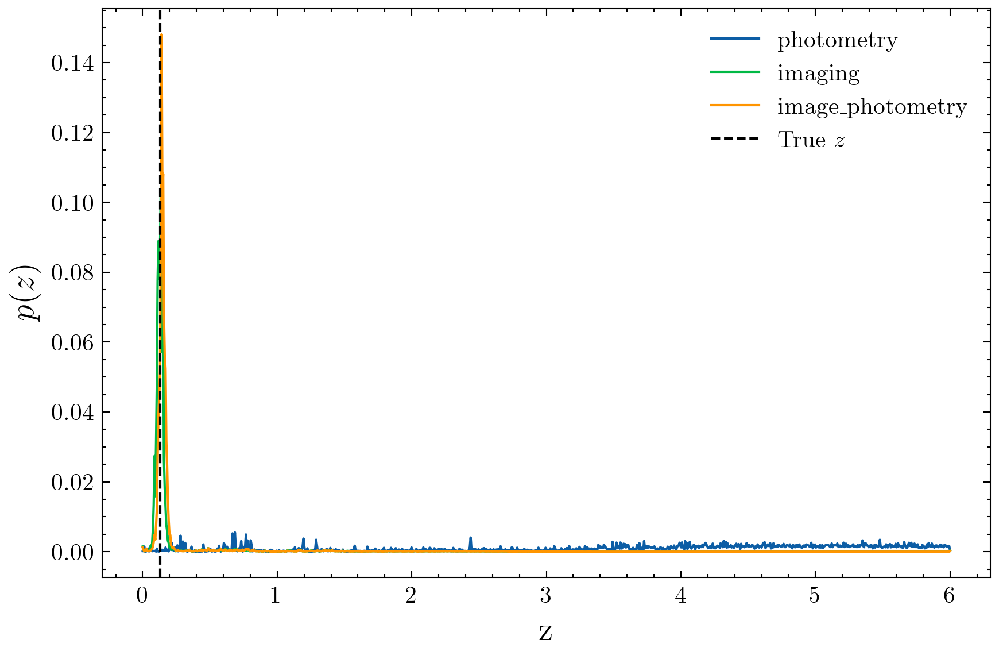

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811941517475,-11.171039,11.799324035644531,0.028494272,0.5786991


Z                                     22.429741
Photometry                           533.530273
Imaging                               16.147894
Spectroscopy                           0.000000
Image + Photometry                     6.557600
Image + Spectrum                       0.132342
Image + Spectrum + Photometry          0.150682
Image + Spectrum + Photometry + Z      0.134998
ratio_p_ip                            81.360603
ratio_p_i                             33.040237
ratio_p_i_rank                        15.000000
Name: 2021, dtype: float64

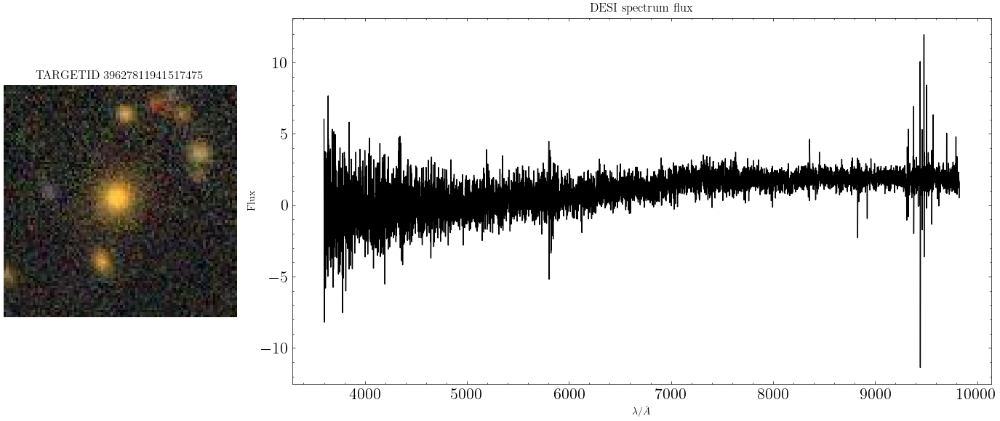

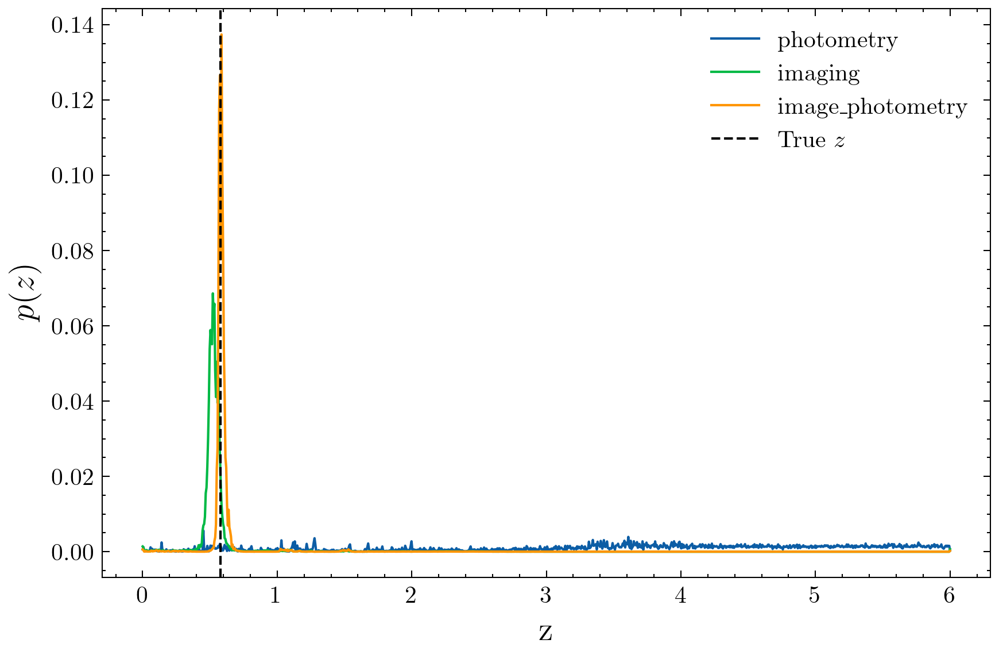

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793801155287,-9.930141,10.632078170776367,0.023319695,0.13063742


Z                                     20.064972
Photometry                           654.882568
Imaging                               19.872019
Spectroscopy                           0.000000
Image + Photometry                    18.910397
Image + Spectrum                       0.011044
Image + Spectrum + Photometry          0.005032
Image + Spectrum + Photometry + Z      0.003859
ratio_p_ip                            34.630821
ratio_p_i                             32.955009
ratio_p_i_rank                        16.000000
Name: 766, dtype: float64

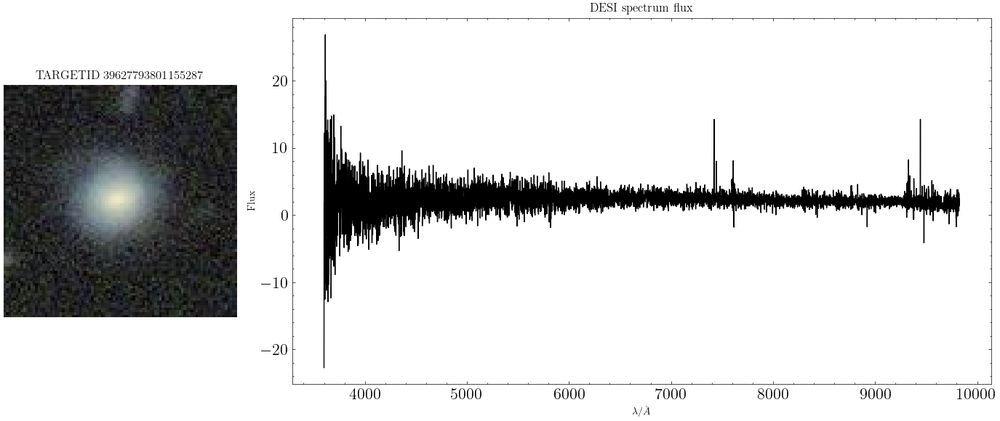

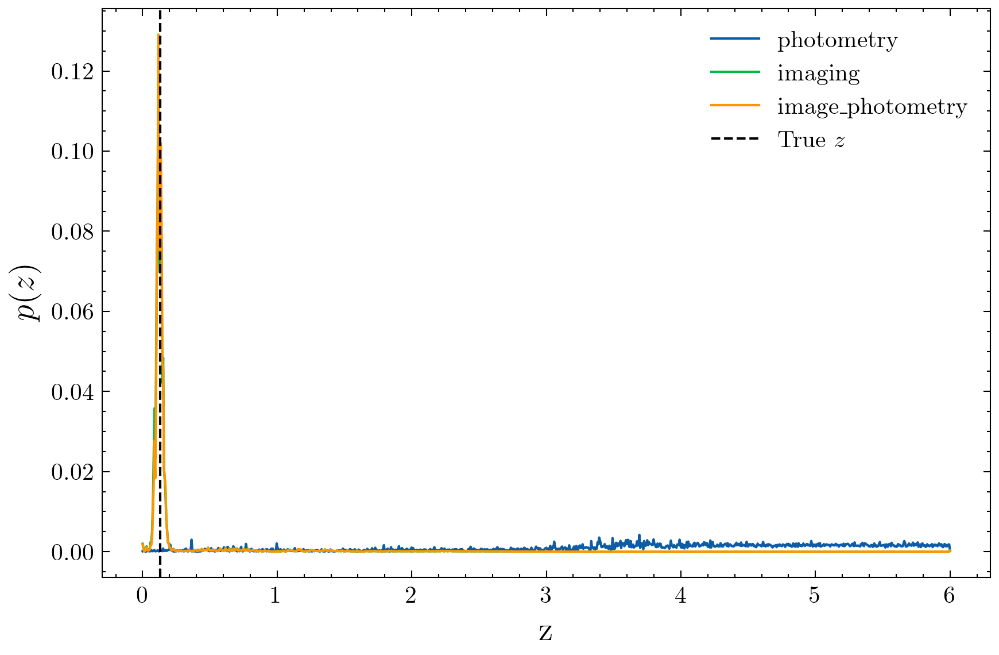

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811958295632,-12.419126,10.644575119018555,0.032959666,0.12508689


Z                                     19.236914
Photometry                           685.074890
Imaging                               20.900112
Spectroscopy                           0.000000
Image + Photometry                    16.630074
Image + Spectrum                       0.043869
Image + Spectrum + Photometry          0.048986
Image + Spectrum + Photometry + Z      0.018029
ratio_p_ip                            41.194939
ratio_p_i                             32.778526
ratio_p_i_rank                        17.000000
Name: 2313, dtype: float64

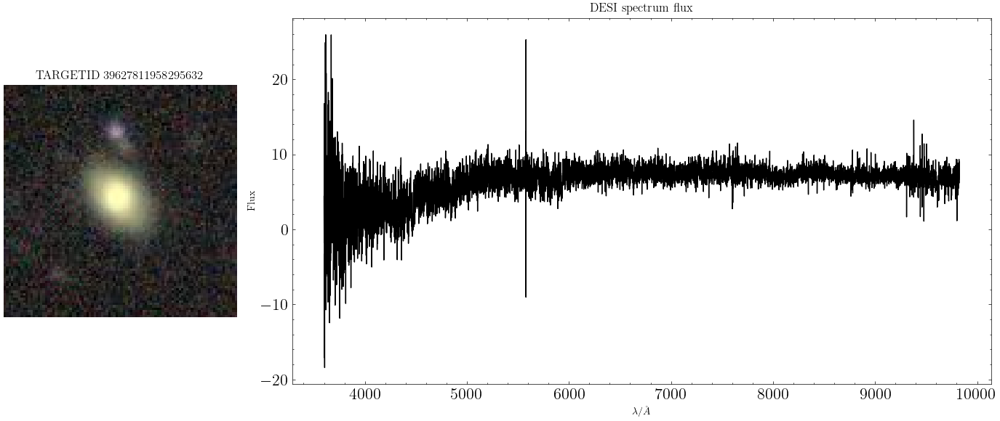

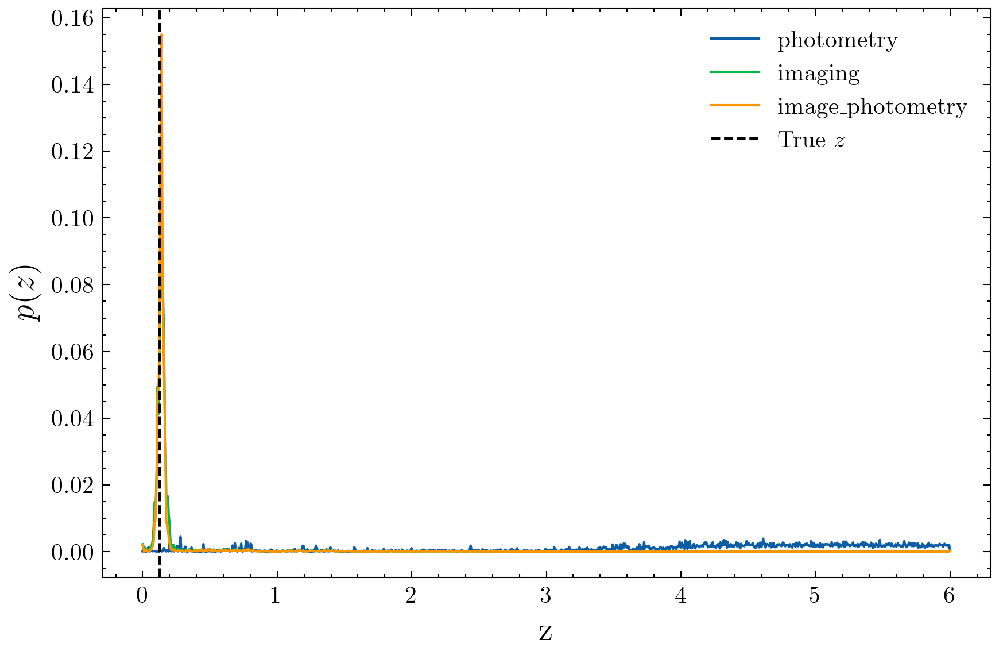

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627757612700301,-10.3131075,10.080437660217285,0.022072531,0.08529387


Z                                     14.363862
Photometry                           641.442261
Imaging                               19.591574
Spectroscopy                           0.000000
Image + Photometry                    20.598532
Image + Spectrum                       0.067212
Image + Spectrum + Photometry          0.070168
Image + Spectrum + Photometry + Z      0.069701
ratio_p_ip                            31.140194
ratio_p_i                             32.740723
ratio_p_i_rank                        18.000000
Name: 2927, dtype: float64

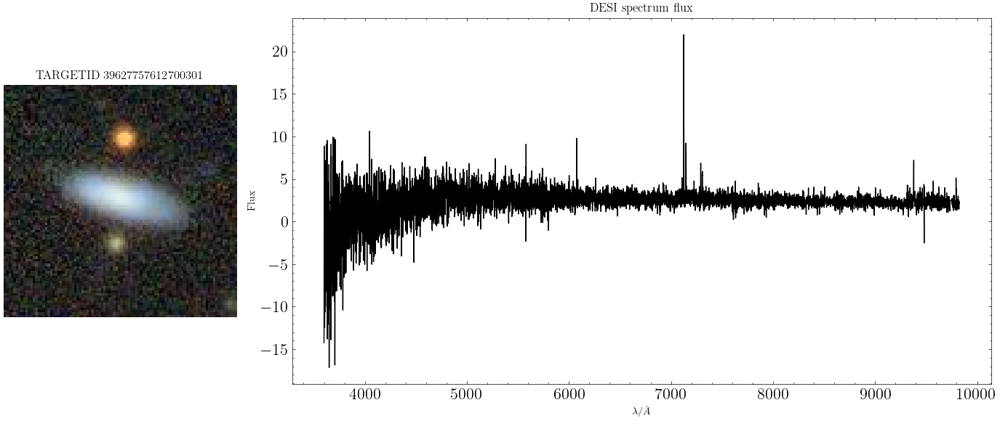

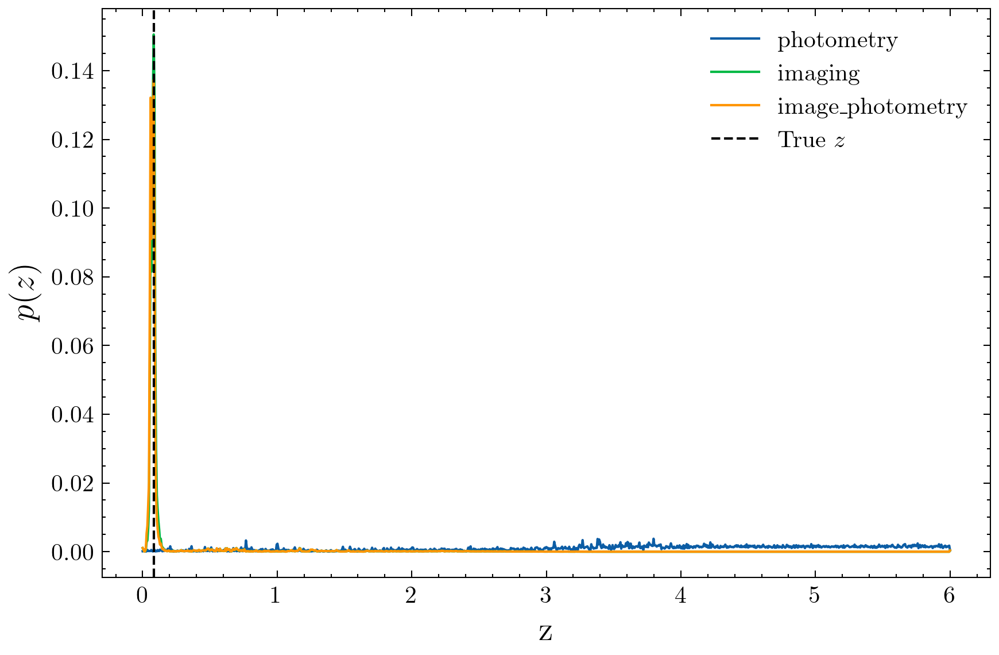

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627818002287156,-11.462424,10.91611385345459,0.03377406,0.15338351


Z                                     10.765952
Photometry                           659.180176
Imaging                               20.188496
Spectroscopy                           0.000000
Image + Photometry                    17.033905
Image + Spectrum                       0.041850
Image + Spectrum + Photometry          0.047038
Image + Spectrum + Photometry + Z      0.030961
ratio_p_ip                            38.698124
ratio_p_i                             32.651279
ratio_p_i_rank                        19.000000
Name: 2547, dtype: float64

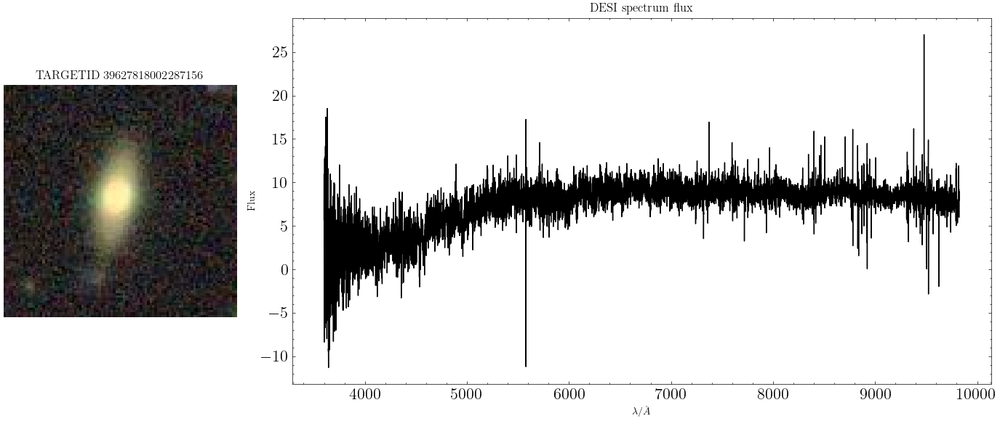

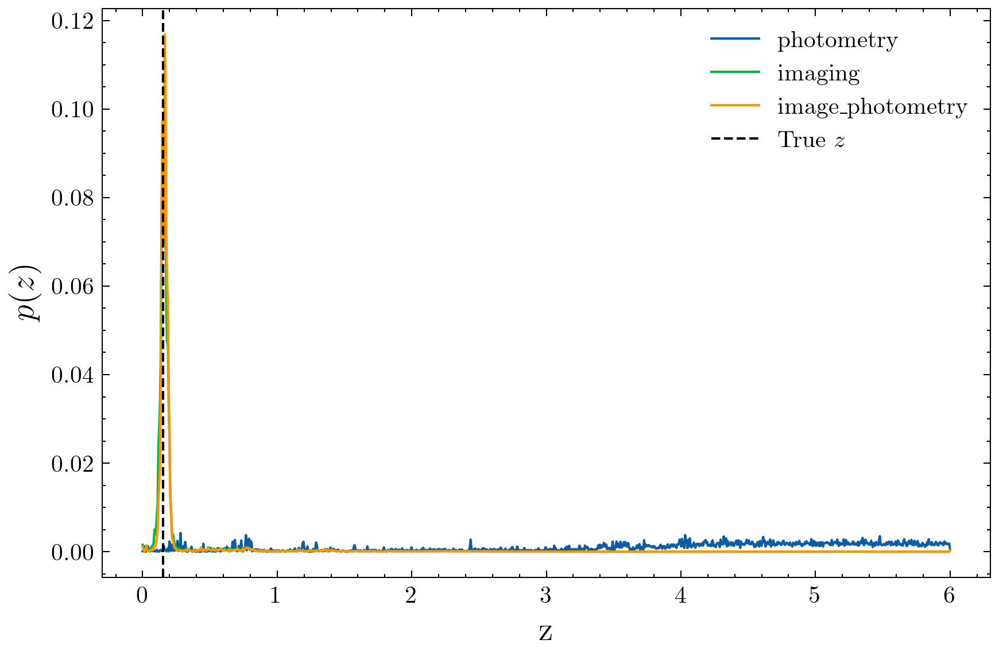

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627745516323660,-12.43341,10.574719429016113,0.019742023,0.11088043


Z                                     27.072229
Photometry                           671.600952
Imaging                               21.064468
Spectroscopy                           0.000000
Image + Photometry                    19.904799
Image + Spectrum                       0.052688
Image + Spectrum + Photometry          0.045456
Image + Spectrum + Photometry + Z      0.041355
ratio_p_ip                            33.740654
ratio_p_i                             31.883120
ratio_p_i_rank                        20.000000
Name: 1, dtype: float64

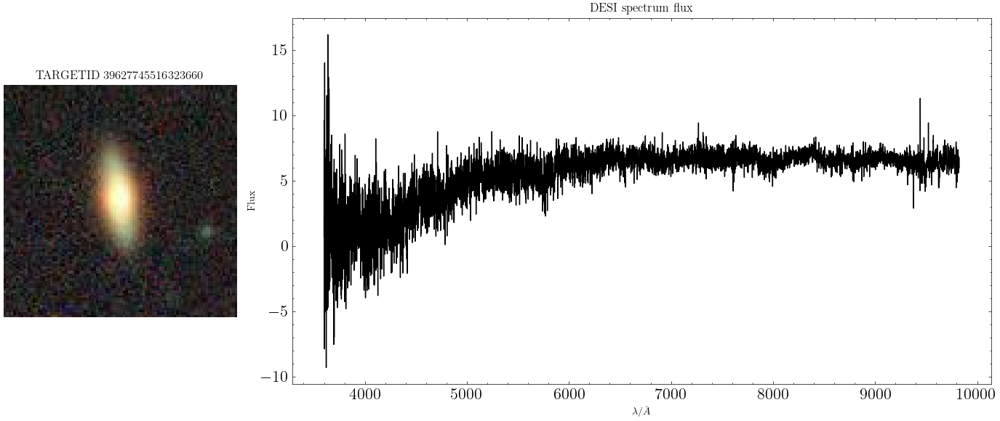

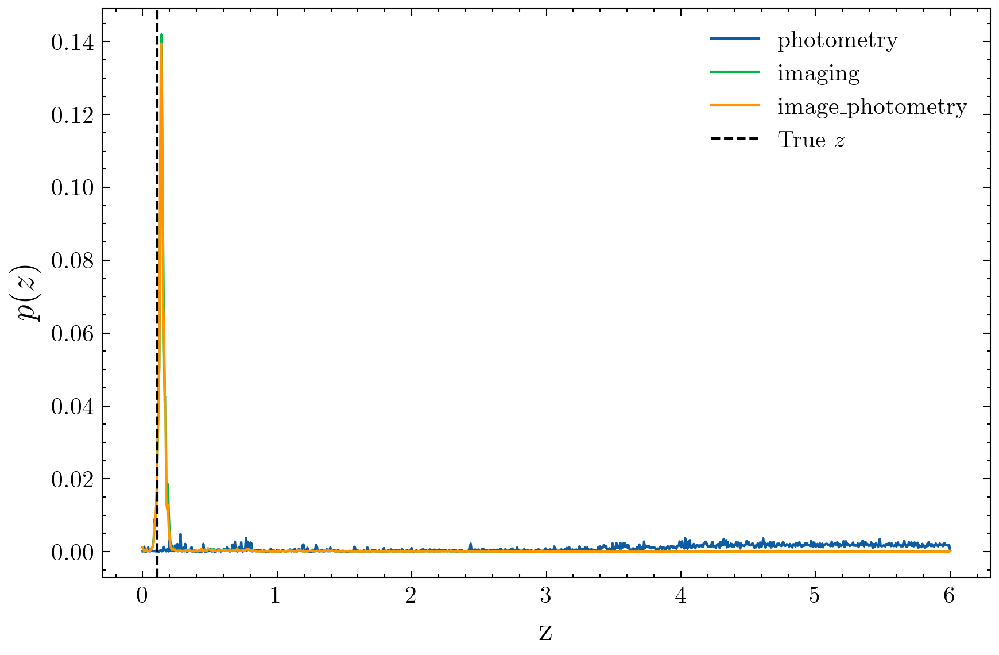

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627799853536087,-9.964534,10.334444046020508,0.025387898,0.117455155


Z                                     19.016047
Photometry                           646.506470
Imaging                               20.533602
Spectroscopy                           0.000000
Image + Photometry                    19.137386
Image + Spectrum                       0.040769
Image + Spectrum + Photometry          0.048279
Image + Spectrum + Photometry + Z      0.036618
ratio_p_ip                            33.782379
ratio_p_i                             31.485292
ratio_p_i_rank                        21.000000
Name: 1317, dtype: float64

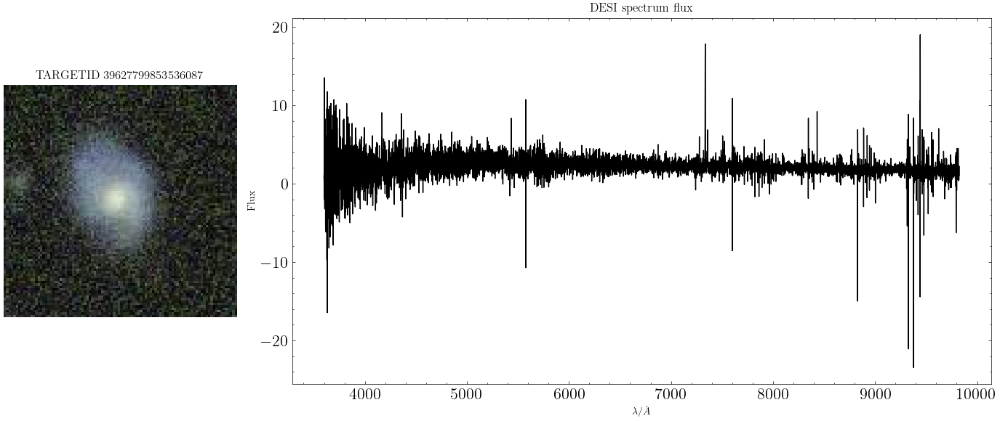

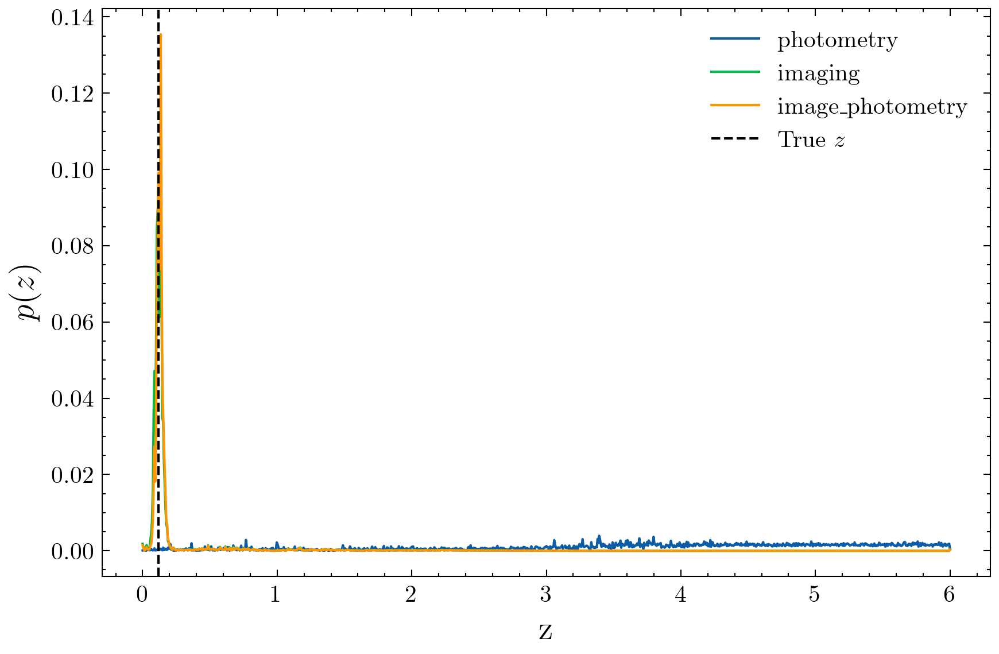

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793834707611,-9.569365,10.541457176208496,0.02621888,0.12661529


Z                                     19.166418
Photometry                           624.292297
Imaging                               19.868694
Spectroscopy                           0.000000
Image + Photometry                    19.575510
Image + Spectrum                       0.113929
Image + Spectrum + Photometry          0.119288
Image + Spectrum + Photometry + Z      0.111356
ratio_p_ip                            31.891497
ratio_p_i                             31.420902
ratio_p_i_rank                        22.000000
Name: 1039, dtype: float64

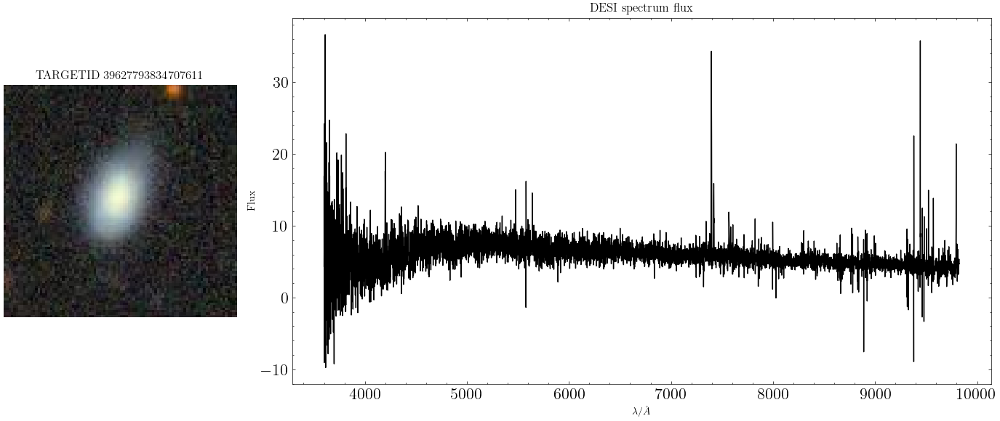

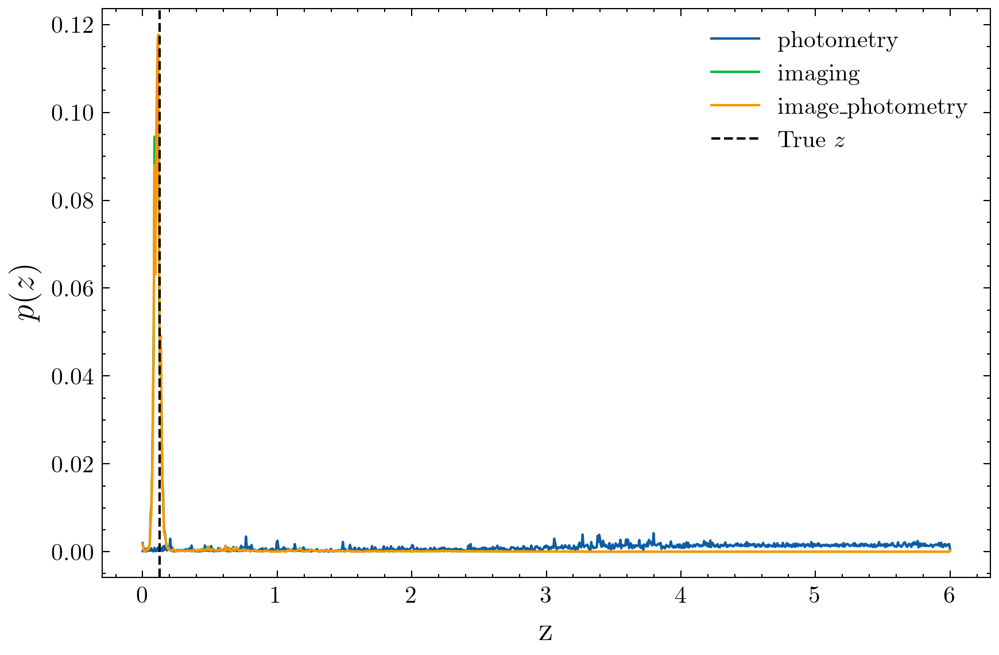

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811949907112,-10.992169,10.084025382995605,0.027940487,0.07735763


Z                                      9.182676
Photometry                           657.057678
Imaging                               21.452368
Spectroscopy                           0.000000
Image + Photometry                    21.024416
Image + Spectrum                       0.003286
Image + Spectrum + Photometry          0.002415
Image + Spectrum + Photometry + Z      0.028002
ratio_p_ip                            31.252125
ratio_p_i                             30.628679
ratio_p_i_rank                        23.000000
Name: 2175, dtype: float64

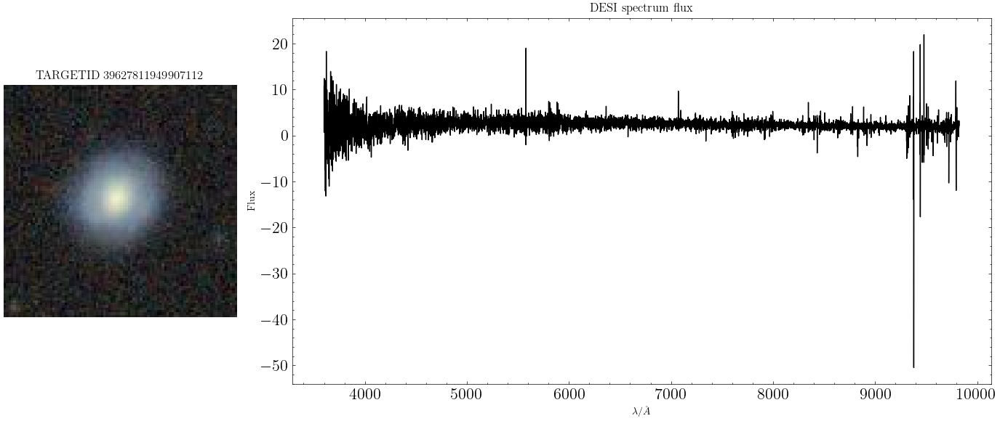

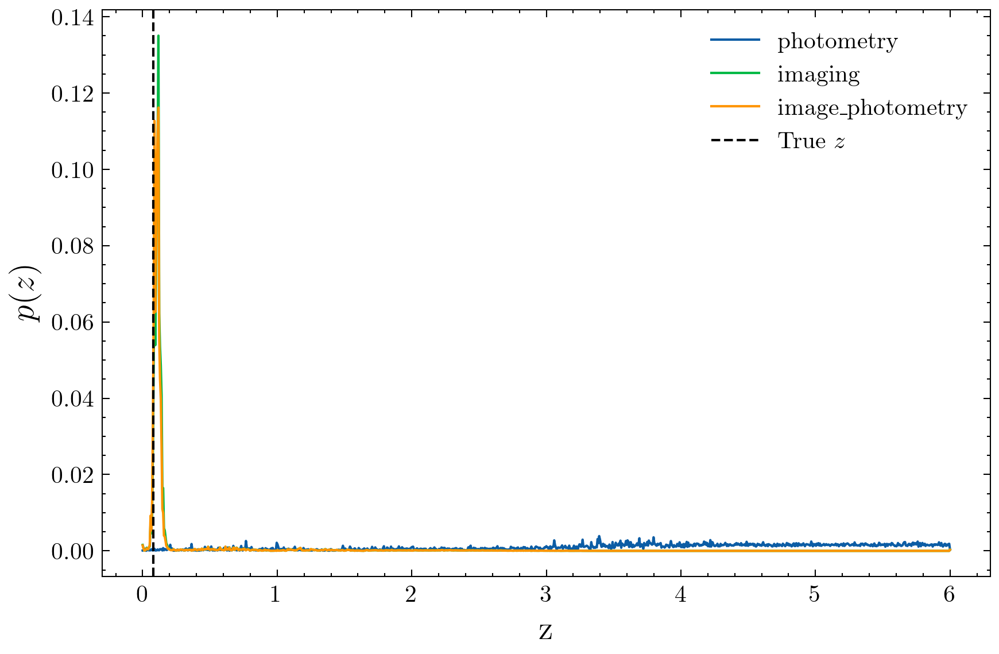

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781717363782,-14.578751,10.597193717956543,0.023749094,0.11771579


Z                                     18.982327
Photometry                           686.007263
Imaging                               22.469707
Spectroscopy                           0.000000
Image + Photometry                    18.066233
Image + Spectrum                       0.036546
Image + Spectrum + Photometry          0.073717
Image + Spectrum + Photometry + Z      0.017897
ratio_p_ip                            37.971794
ratio_p_i                             30.530315
ratio_p_i_rank                        24.000000
Name: 3561, dtype: float64

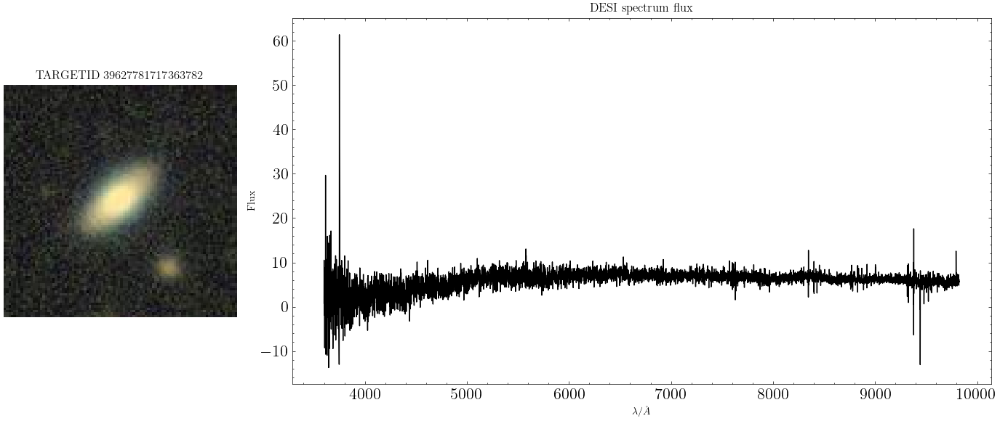

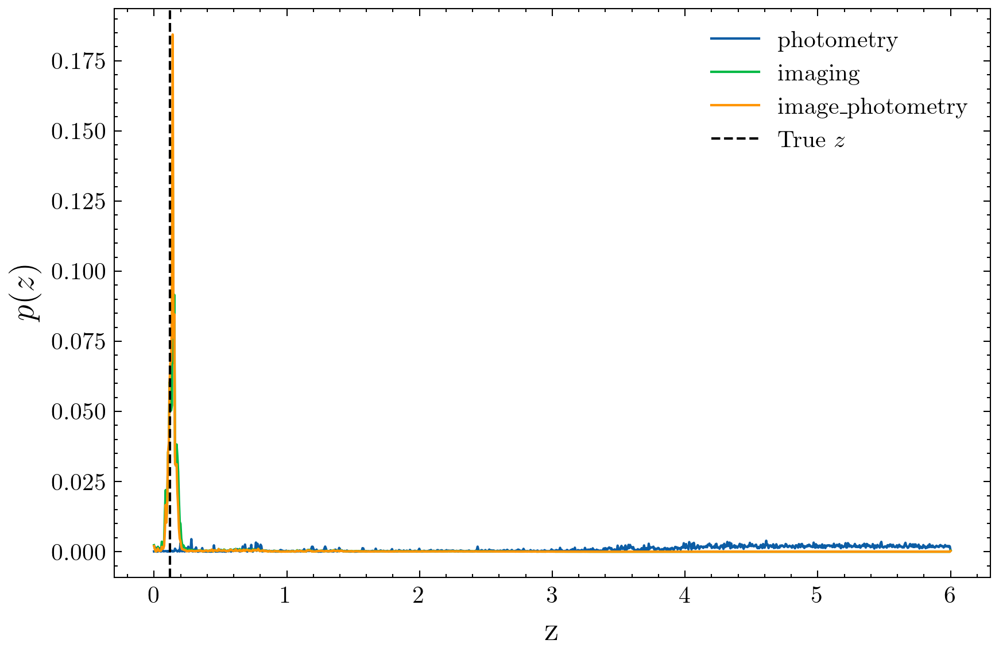

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627793838901480,-10.331518,10.075872421264648,0.024874285,0.08979002


Z                                     17.621258
Photometry                           640.514099
Imaging                               21.088610
Spectroscopy                           0.000000
Image + Photometry                    21.240509
Image + Spectrum                       0.048367
Image + Spectrum + Photometry          0.059246
Image + Spectrum + Photometry + Z      0.092468
ratio_p_ip                            30.155308
ratio_p_i                             30.372515
ratio_p_i_rank                        25.000000
Name: 1098, dtype: float64

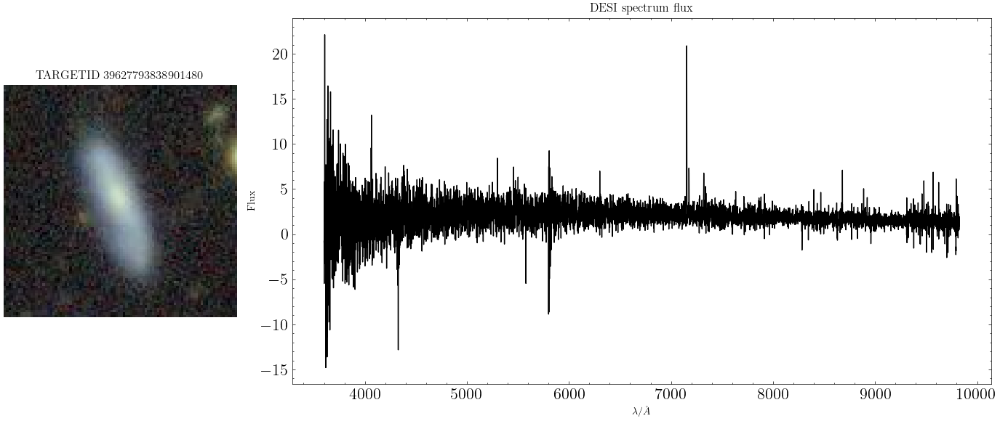

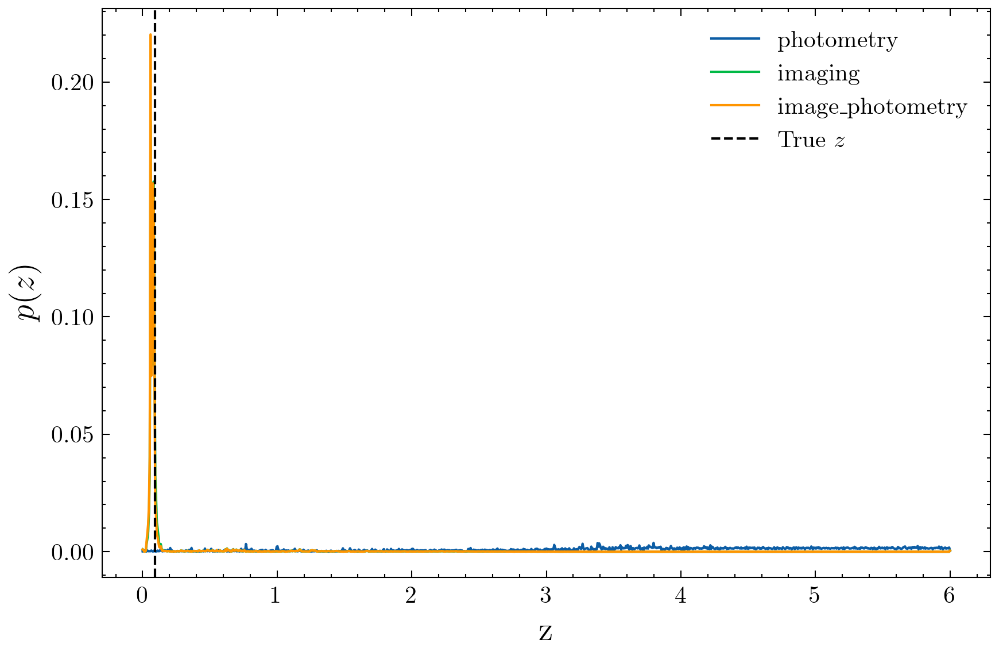

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627811958295706,-11.084363,9.519112586975098,0.031998284,0.046968732


Z                                      4.575667
Photometry                           652.139221
Imaging                               21.631117
Spectroscopy                           0.000000
Image + Photometry                    21.957500
Image + Spectrum                       0.715277
Image + Spectrum + Photometry          0.696590
Image + Spectrum + Photometry + Z      0.597227
ratio_p_ip                            29.700066
ratio_p_i                             30.148199
ratio_p_i_rank                        26.000000
Name: 2317, dtype: float64

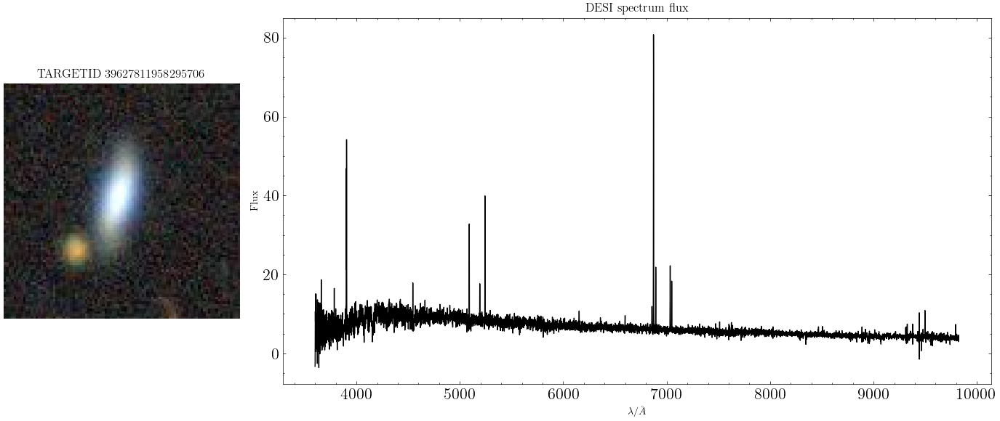

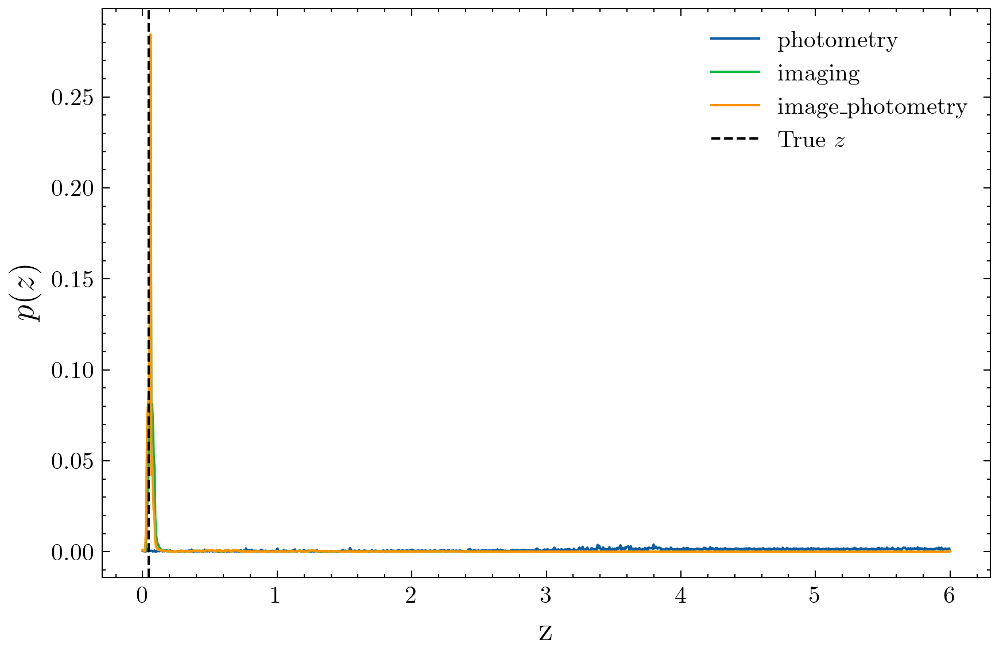

------------------------------------------------


TARGETID,sSFR,LOG_MSTAR,legacysurvey_EBV,desi_Z
int64,float32,float64,float32,float32
39627781721558753,-12.941691,10.49565601348877,0.026339142,0.110310964


Z                                     27.154144
Photometry                           688.065491
Imaging                               22.887533
Spectroscopy                           0.000000
Image + Photometry                    19.797915
Image + Spectrum                       0.016015
Image + Spectrum + Photometry          0.016067
Image + Spectrum + Photometry + Z      0.006322
ratio_p_ip                            34.754444
ratio_p_i                             30.062895
ratio_p_i_rank                        27.000000
Name: 3641, dtype: float64

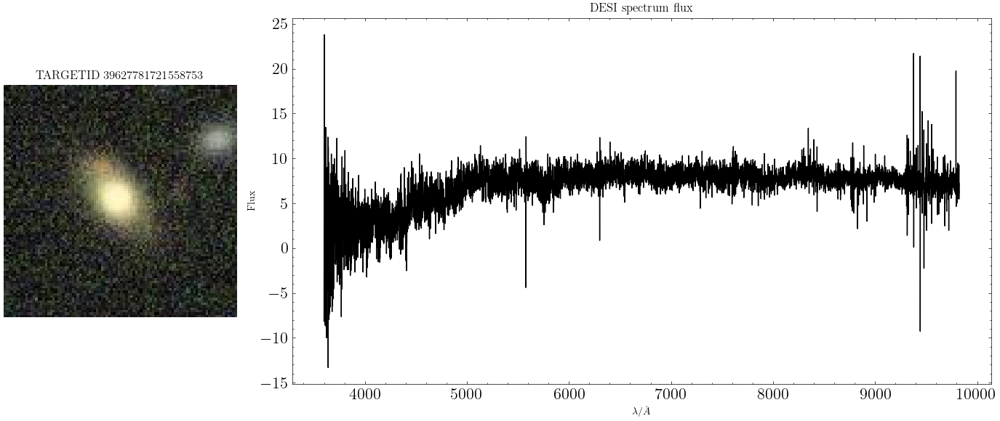

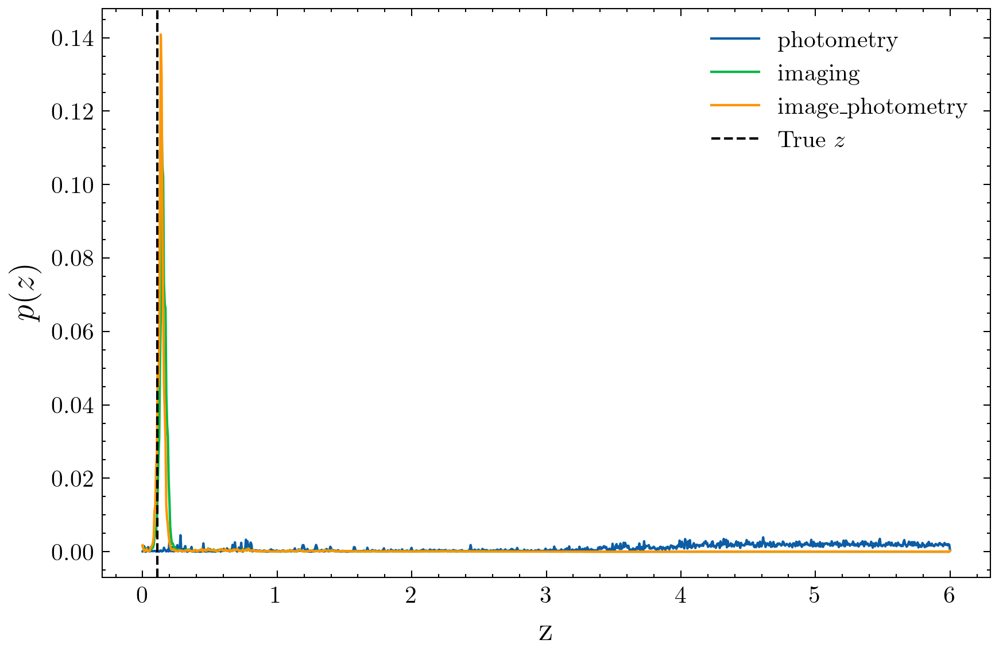

------------------------------------------------


In [57]:
plot_z_dist(
    check_df,
    table_sorted,
    names,
    tok_z_p,
    ascending=False, 
    col="ratio_p_i"
)

In [53]:
df

,Z,Photometry,Imaging,Spectroscopy,Image + Photometry,Image + Spectrum,Image + Spectrum + Photometry,Image + Spectrum + Photometry + Z,ratio_p_ip,ratio_p_i
0,39.432774,618.132202,27.469660,0.0,25.373875,0.062282,0.068383,0.064356,24.360970,22.502361
1,27.072229,671.600952,21.064468,0.0,19.904799,0.052688,0.045456,0.041355,33.740654,31.883120
2,5.448285,120.212761,20.607733,0.0,17.965309,0.021965,0.022067,0.024854,6.691383,5.833381
3,20.780413,111.968544,33.297199,0.0,31.919025,0.012898,0.013799,0.023753,3.507894,3.362702
4,2.836712,52.842640,24.287086,0.0,28.351974,0.093302,0.088038,0.233066,1.863808,2.175750
...,...,...,...,...,...,...,...,...,...,...
3810,20.639946,48.314598,21.581327,0.0,19.168755,0.133142,0.127963,0.164577,2.520487,2.238722
3811,11.450113,92.294167,38.015392,0.0,23.968147,0.062720,0.091214,0.294099,3.850701,2.427810
3812,17.316740,83.564873,27.183308,0.0,20.954048,0.007034,0.008940,0.013083,3.988006,3.074125
3813,5.877277,72.375221,27.824211,0.0,21.471140,0.069319,0.070839,0.081385,3.370814,2.601160
